<a href="https://colab.research.google.com/github/diegormsouza/ra-iv-swfp-ca-2026/blob/main/Borrador_Taller_SWFP_2026_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

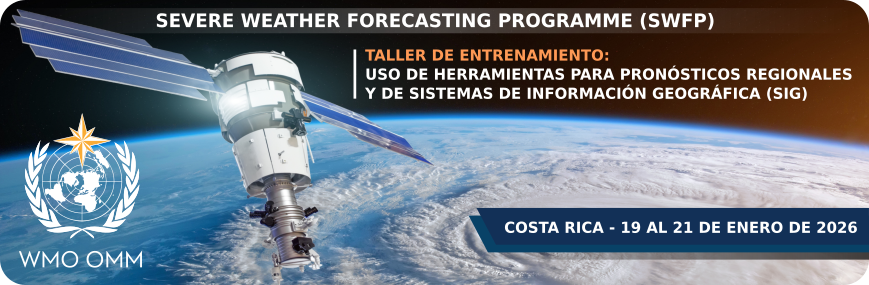

---
## **Actividad Práctica:** Acceso y Procesamiento de Datos Meteorológicos con Python
GitHub: https://github.com/diegormsouza/ra-iv-swfp-ca-2026

---
**OBJECTIVO:** Comprender conceptos sobre el acceso y procesamiento de datos satelitales y datos de modelos para mejorar las informaciones disponibles en la página https://swfp.imn.ac.cr/

---
**CONTENIDO**: Se abordarán los siguientes temas

1. Acceso y procesamiento de datos GEO (GOES-R) - ABI, GLM y RGBs
2. Acceso y procesamiento de datos LEO (JPSS) - TPW y ALPW
3. Acceso y procesamiento de datos de modelos (GFS)
4. Superposición de datos de satélites y modelos
5. Lineas de corriente (streamlines)
6. Vectores
7. Barbas
8. Índices Derivados - Ejemplo: Galvez Davison Index (GDI)
9. Polígonos en un Mapa Interactivo
10. Cálculos con MetPy
11. Actividades Prácticas: Estudios de Caso
---

## **Paso 1: Verificaciones Preliminares del Entorno (Opcional)**
Antes de comenzar con el procesamiento de datos, realizaremos una serie de verificaciones básicas del entorno de Google Colab. En esta celda se comprueba la configuración del sistema operativo, la memoria disponible, el espacio en disco, así como la ubicación y la versión de Python instalada.

In [2]:
# Verifica la configuración del sistema
!cat /etc/issue
!uname -a
print('\n')

# Verifica la memoria disponible
!grep MemTotal /proc/meminfo
print('\n')

# Verifica el espacio en disco
!df -h
print('\n')

# Verifica el directorio de instalación por defecto de Python
!which python
print('\n')

# Verifica la versión instalada de Python
!python --version

Ubuntu 22.04.5 LTS \n \l

Linux af4decb15558 6.6.105+ #1 SMP Thu Oct  2 10:42:05 UTC 2025 x86_64 x86_64 x86_64 GNU/Linux


MemTotal:       13286964 kB


Filesystem      Size  Used Avail Use% Mounted on
overlay         108G   22G   87G  20% /
tmpfs            64M     0   64M   0% /dev
shm             5.8G     0  5.8G   0% /dev/shm
/dev/root       2.0G  1.2G  750M  62% /usr/sbin/docker-init
tmpfs           6.4G  1.8M  6.4G   1% /var/colab
/dev/sda1        57G   23G   35G  40% /kaggle/input
tmpfs           6.4G     0  6.4G   0% /proc/acpi
tmpfs           6.4G     0  6.4G   0% /proc/scsi
tmpfs           6.4G     0  6.4G   0% /sys/firmware


/usr/local/bin/python


Python 3.12.12


## **Paso 2: Creación de Directórios y Descarga de Archivos Auxiliares**
En este paso vamos a crear directórios de entrada y salida y descargar archivos que nos ayudarán en el procesamiento.

In [3]:
!mkdir -p samples  # Crea un directorio llamado 'samples'; '-p' garantiza que no haya error si ya existe.
!mkdir -p output   # Crea un directorio llamado 'output';  '-p' garantiza que no haya error si ya existe.

# Descarga el script "utilities.py", con funciones útiles para el acceso y procesamiento y algunas paletas de colores
!wget -c -q --show-progress https://github.com/diegormsouza/ra-iv-swfp-ca-2026/raw/main/scripts/utilities.py
!wget -c -q --show-progress https://github.com/diegormsouza/ra-iv-swfp-ca-2026/raw/main/colortables/IR4AVHRR6.cpt
!wget -c -q --show-progress https://github.com/diegormsouza/ra-iv-swfp-ca-2026/raw/main/colortables/SVGAWVX_TEMP.cpt
!wget -c -q --show-progress https://github.com/diegormsouza/ra-iv-swfp-ca-2026/raw/main/colortables/Square%20Root%20Visible%20Enhancement.cpt

utilities.py        100%[===================>]  36.16K  --.-KB/s    in 0.001s  
IR4AVHRR6.cpt       100%[===================>]   8.26K  --.-KB/s    in 0s      
SVGAWVX_TEMP.cpt    100%[===================>]   4.27K  --.-KB/s    in 0s      
Square Root Visible 100%[===================>]   8.47K  --.-KB/s    in 0s      


## **Paso 3: Instalación de las Librerías Python Necesárias**
En este paso vamos a instalar las librerías necesárias para descargar y procesar los datos.

In [4]:
# Instala las librerías necesarias
!pip install --quiet xarray netcdf4 boto3 gdal herbie-data ecmwf-opendata cfgrib cartopy leafmap metpy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.1/56.1 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 50.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 kB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.7/117.7 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 kB 3.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 35.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 632.9/632.9 kB 36.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 424.4/424.4 kB 29.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 77.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.5/20.5 MB 29.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.4/91.4 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 306.8/306.8 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8

## **Ejemplo 1: Datos GEO - Acceso y Procesamiento de Datos GOES-R**
Fuente de Datos: https://registry.opendata.aws/noaa-goes/

### 1.1. Descarga de datos GOES-R con la función `download_GOES`

In [ ]:
# Descarga de archivos GOES-R
from utilities import download_GOES

# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 13, './samples')

Successfully downloaded ./samples/OR_ABI-L2-CMIPF-M6C13_G19_s20260151500214_e20260151509535_c20260151510005.nc


### 1.2. Abre el archivo NetCDF de GOES-R con la librería `Xarray` y muestra su contenido

In [ ]:
# Lectura de NetCDF, GRIB, datos multidimensionales
import xarray as xr

# Abrimos el archivo NetCDF
ds = xr.open_dataset(file)

# Mostramos todo el contenido del dataset (dimensiones, variables, atributos)
ds

<xarray.Dataset> Size: 235MB
Dimensions:                                           (y: 5424, x: 5424,
                                                       number_of_time_bounds: 2,
                                                       number_of_image_bounds: 2,
                                                       band: 1)
Coordinates:
  * y                                                 (y) float32 22kB 0.1518...
  * x                                                 (x) float32 22kB -0.151...
    t                                                 datetime64[ns] 8B ...
    y_image                                           float32 4B ...
    x_image                                           float32 4B ...
    band_wavelength                                   (band) float32 4B ...
    band_id                                           (band) int32 4B ...
Dimensions without coordinates: number_of_time_bounds, number_of_image_bounds,
                                band
Data variables: (12/35)
    CMI                                               (y, x) float32 118MB ...
    DQF                                               (y, x) float32 118MB ...
    time_bounds                                       (number_of_time_bounds) datetime64[ns] 16B ...
    goes_imager_projection                            int32 4B ...
    y_image_bounds                                    (number_of_image_bounds) float32 8B ...
    x_image_bounds                                    (number_of_image_bounds) float32 8B ...
    ...                                                ...
    focal_plane_temperature_threshold_exceeded_count  float64 8B ...
    maximum_focal_plane_temperature                   float32 4B ...
    focal_plane_temperature_threshold_increasing      float32 4B ...
    focal_plane_temperature_threshold_decreasing      float32 4B ...
    channel_integration_time                          float64 8B ...
    channel_gain_field                                float64 8B ...
Attributes: (12/29)
    naming_authority:          gov.nesdis.noaa
    Conventions:               CF-1.7
    Metadata_Conventions:      Unidata Dataset Discovery v1.0
    standard_name_vocabulary:  CF Standard Name Table (v35, 20 July 2016)
    institution:               DOC/NOAA/NESDIS > U.S. Department of Commerce,...
    project:                   GOES
    ...                        ...
    cdm_data_type:             Image
    time_coverage_start:       2026-01-15T15:00:21.4Z
    time_coverage_end:         2026-01-15T15:09:53.5Z
    timeline_id:               ABI Mode 6
    production_data_source:    Realtime
    id:                        ea08eb46-a6e1-476d-b099-b0dfdb451724

### 1.3. Selecciona la variable de interés y muestra sus informaciones basicas

In [ ]:
# Selecciona la variable de datos que queremos usar
data = ds['CMI']

# Muestra la información básica de la variable seleccionada
data

<xarray.DataArray 'CMI' (y: 5424, x: 5424)> Size: 118MB
[29419776 values with dtype=float32]
Coordinates:
  * y        (y) float32 22kB 0.1518 0.1518 0.1517 ... -0.1517 -0.1518 -0.1518
  * x        (x) float32 22kB -0.1518 -0.1518 -0.1517 ... 0.1517 0.1518 0.1518
    t        datetime64[ns] 8B ...
    y_image  float32 4B ...
    x_image  float32 4B ...
Attributes:
    long_name:              ABI L2+ Cloud and Moisture Imagery brightness tem...
    standard_name:          toa_brightness_temperature
    sensor_band_bit_depth:  12
    valid_range:            [   0 4095]
    units:                  K
    resolution:             y: 0.000056 rad x: 0.000056 rad
    grid_mapping:           goes_imager_projection
    cell_methods:           t: point area: point
    ancillary_variables:    DQF

### 1.4 Graficación (muy) básica

File ./samples/OR_ABI-L2-CMIPF-M6C13_G19_s20260151500214_e20260151509535_c20260151510005.nc already exists


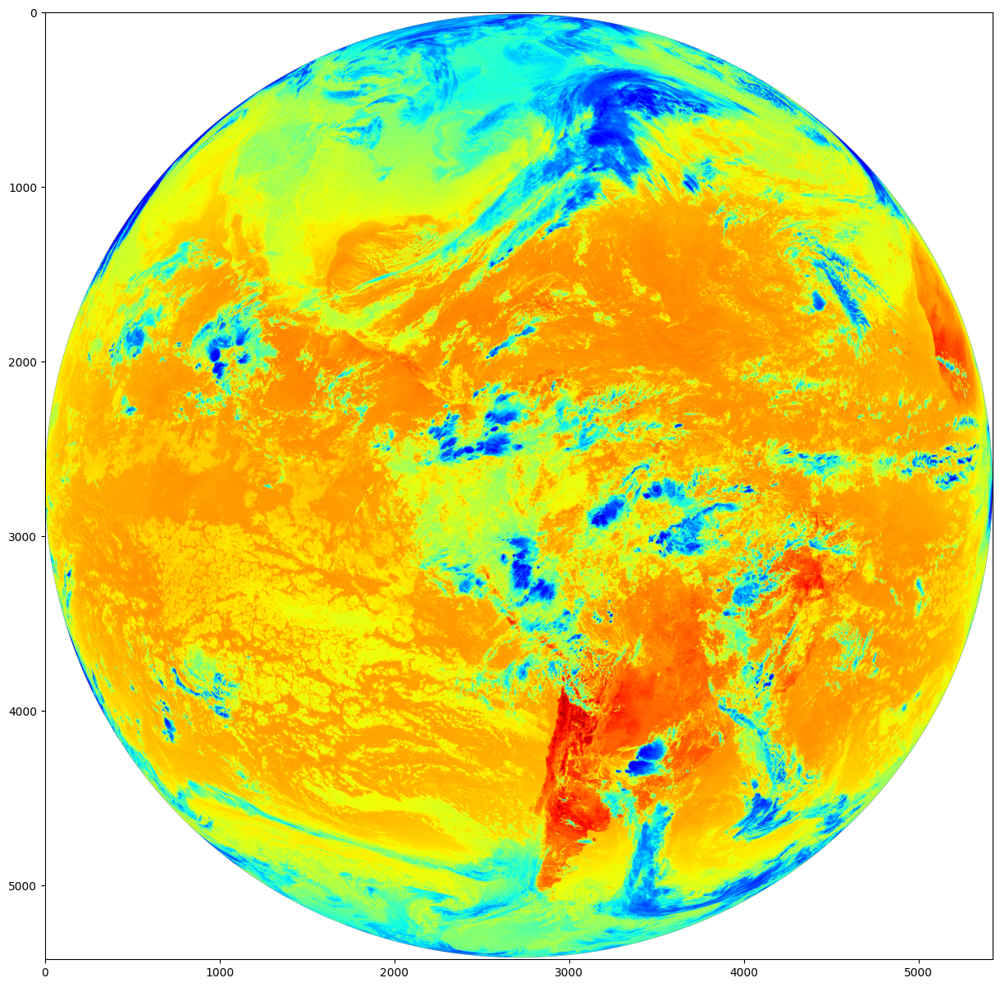

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
from utilities import download_GOES # Descarga de archivos GOES-R

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 13, './samples')

# Abrimos el archivo NetCDF
ds = xr.open_dataset(file)

# Selecciona la variable de datos que queremos usar
data = ds['CMI']

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
# Crea una nueva figura de 10x10 pulgadas
plt.figure(figsize=(15, 15))

# Muestra los datos como imagen 2D usando el mapa de colores selecionado
plt.imshow(data, cmap="jet")

# Muestra la imagen en pantalla
plt.show()

### 1.5 Graficación más completa - Proyección Geoestacionária

File ./samples/OR_ABI-L2-CMIPF-M6C13_G19_s20260151500214_e20260151509535_c20260151510005.nc already exists


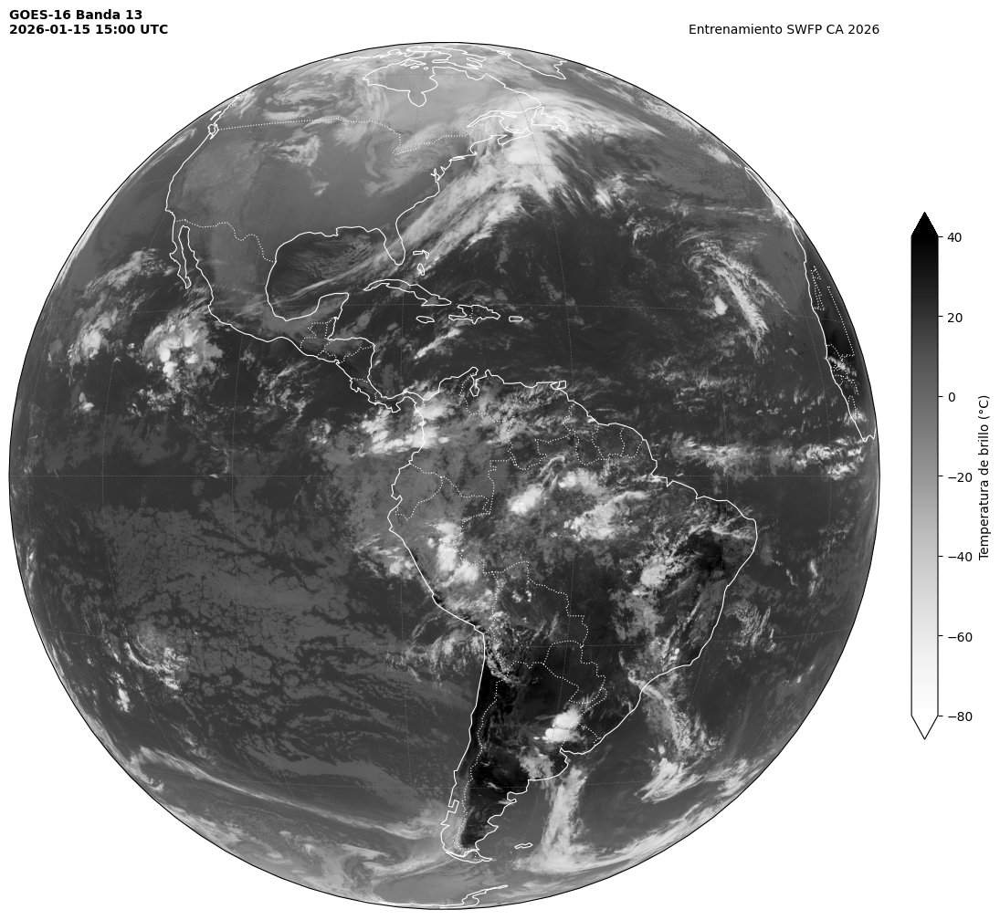

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
from datetime import datetime       # Manejo básico de fechas y horas

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 13, './samples')

# Abrimos el archivo NetCDF
ds = xr.open_dataset(file)

# Obtiene los valores de píxel y los convierte a temperatura de brillo en °C
data = ds['CMI'] - 273.15

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
# Define el tamaño de la figura (ancho x alto en pulgadas)
plt.figure(figsize=(15, 15))

# Lee la longitud del satélite desde los metadatos (punto de origen de la proyección)
longitude = ds['goes_imager_projection'].attrs['longitude_of_projection_origin']

# Lee la altura del satélite desde los metadatos (distancia al punto de perspectiva)
height = ds['goes_imager_projection'].attrs['perspective_point_height']

# Crea ejes usando la proyección geostacionaria correcta de Cartopy
ax = plt.axes(projection=ccrs.Geostationary(central_longitude=longitude, satellite_height=height))

# Calcula los límites del disco completo en metros (coordenadas x,y escaladas por la altura)
xmin = ds['x'][:].min() * height
xmax = ds['x'][:].max() * height
ymin = ds['y'][:].min() * height
ymax = ds['y'][:].max() * height

# Lista con los límites de la imagen (extent) en el sistema de coordenadas proyectado
img_extent = (xmin, xmax, ymin, ymax)

# Agrega líneas costeras, fronteras políticas y cuadrícula
ax.coastlines(resolution='110m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linestyle=':', linewidth=0.8)
ax.gridlines(color='gray', alpha=0.5, linestyle='--', linewidth=0.5)

# Genera la imagen principal con rango de valores y mapa de colores en escala de grises
img = ax.imshow(data, vmin=-80, vmax=40, origin='upper', extent=img_extent, cmap='Grays')

# Agrega la barra de color (colorbar) con etiqueta
plt.colorbar(img, label='Temperatura de brillo (°C)', extend='both', orientation='vertical', pad=0.03, shrink=0.5)

# Lee la fecha del archivo
date = (datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# Agrega un título
plt.title(f'GOES-16 Banda 13\n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title('Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen.png', bbox_inches='tight', dpi=150)

# Muestra la figura completa
plt.show()

### 1.6 Canal 0.64 µm (Visible) - Proyección equidistante - Recorte regional

File ./samples/OR_ABI-L2-CMIPF-M6C02_G19_s20260151500214_e20260151509523_c20260151509570.nc already exists
Remapping...
Remap finished! Time: 0.54 seconds


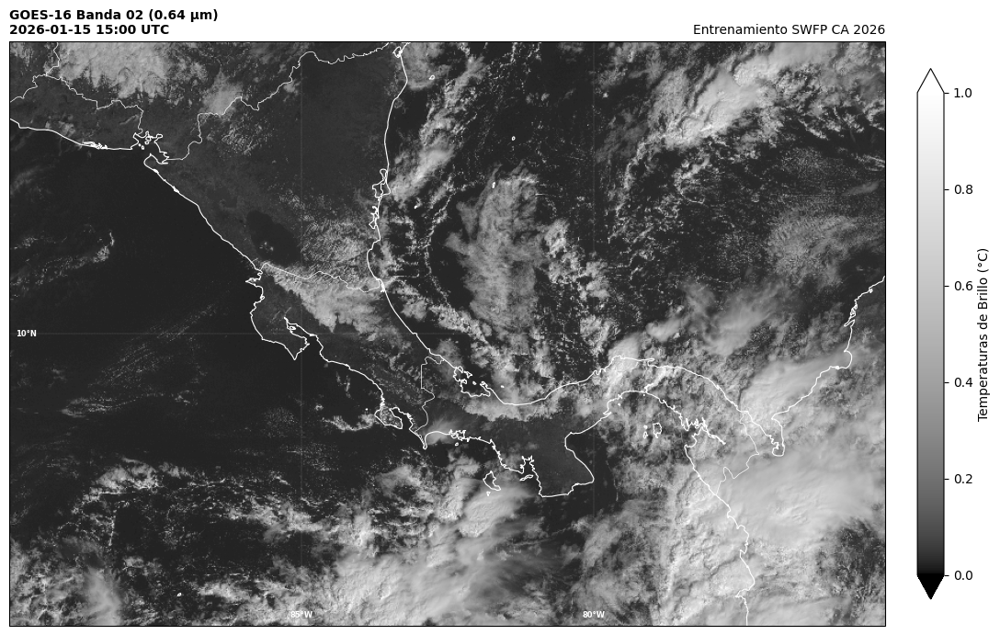

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                                  # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt                      # Creación de gráficos y mapas base
import cartopy.crs as ccrs                           # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature                   # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                                   # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime                        # Manejo básico de fechas y horas
from utilities import download_GOES, remap, loadCPT  # Descarga de archivos GOES-R y reproyección

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -90  ; max_lon = -75
min_lat = 5    ; max_lat = 15

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 2, './samples')

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS
#========================================================================================================================#
# Llama a la función de reproyección (archivo, variable, extensión, resolución), lee los datos devueltos y los convierte a °C
data = remap(file, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
img_extent = [min_lon, max_lon, min_lat, max_lat]

# Read a colormap from file
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap('cpt', loadCPT('Square Root Visible Enhancement.cpt'))
vmin = 0 ; vmax = 1

# Grafica la imagen
img = ax.imshow(data, origin='upper', vmin=vmin, vmax=vmax, extent=img_extent, cmap=cmap)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='white', linestyle='--', linewidth=0.1, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
plt.colorbar(img, label='Temperaturas de Brillo (°C)', extend='both', orientation='vertical', pad=0.03, shrink=0.5)

# Lee la fecha del archivo
ds = xr.open_dataset(file)
date = (datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# Agrega un título
plt.title(f'GOES-16 Banda 02 (0.64 µm)\n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 1.7 Canal 10.3 µm (IR) - Proyección equidistante - Recorte regional

File ./samples/OR_ABI-L2-CMIPF-M6C13_G19_s20260151500214_e20260151509535_c20260151510005.nc already exists
Remapping...
Remap finished! Time: 0.15 seconds


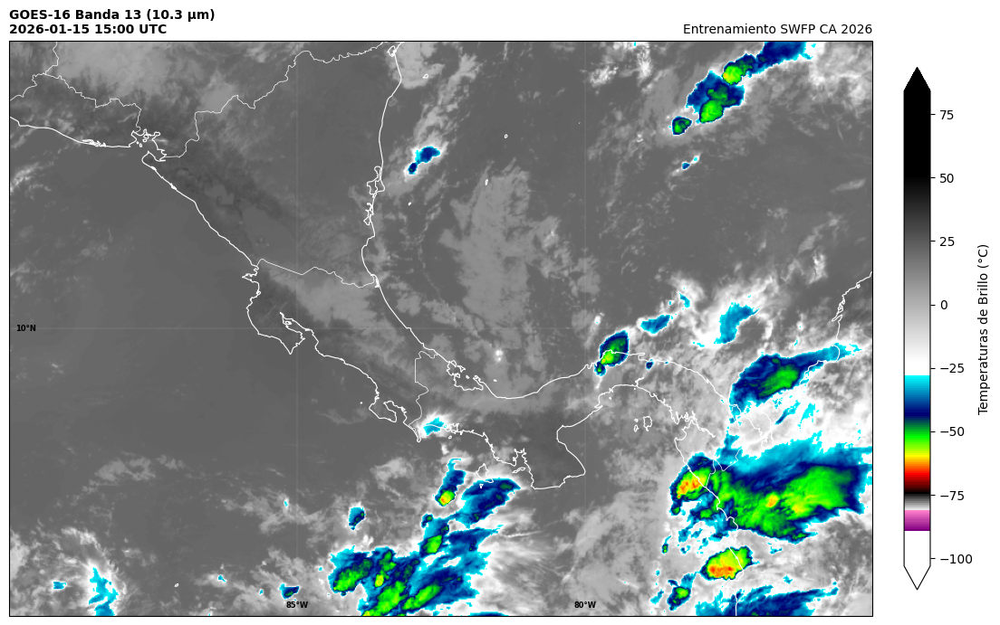

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                                  # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt                      # Creación de gráficos y mapas base
import cartopy.crs as ccrs                           # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature                   # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                                   # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime                        # Manejo básico de fechas y horas
from utilities import download_GOES, remap, loadCPT  # Descarga de archivos GOES-R y reproyección

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -90  ; max_lon = -75
min_lat = 5    ; max_lat = 15

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 13, './samples')

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS
#========================================================================================================================#
# Llama a la función de reproyección (archivo, variable, extensión, resolución), lee los datos devueltos y los convierte a °C
data = remap(file, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
img_extent = [min_lon, max_lon, min_lat, max_lat]

# Read a colormap from file
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap('cpt', loadCPT('IR4AVHRR6.cpt'))
vmin = -103.0 ; vmax = 84.0
#cmap = LinearSegmentedColormap('cpt', loadCPT('SVGAIR_TEMP.cpt'))
#vmin = -112.15 ; vmax = 56.85

# Grafica la imagen
img = ax.imshow(data, origin='upper', vmin=vmin, vmax=vmax, extent=img_extent, cmap=cmap)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='white', linestyle='--', linewidth=0.1, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
plt.colorbar(img, label='Temperaturas de Brillo (°C)', extend='both', orientation='vertical', pad=0.03, shrink=0.5)

# Lee la fecha del archivo
ds = xr.open_dataset(file)
date = (datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# Agrega un título
plt.title(f'GOES-16 Banda 13 (10.3 µm)\n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 1.8 Canal 6.2 µm (WV) - Proyección equidistante - Recorte regional

Successfully downloaded ./samples/OR_ABI-L2-CMIPF-M6C08_G19_s20260151500214_e20260151509523_c20260151509587.nc
Remapping...
Remap finished! Time: 0.13 seconds


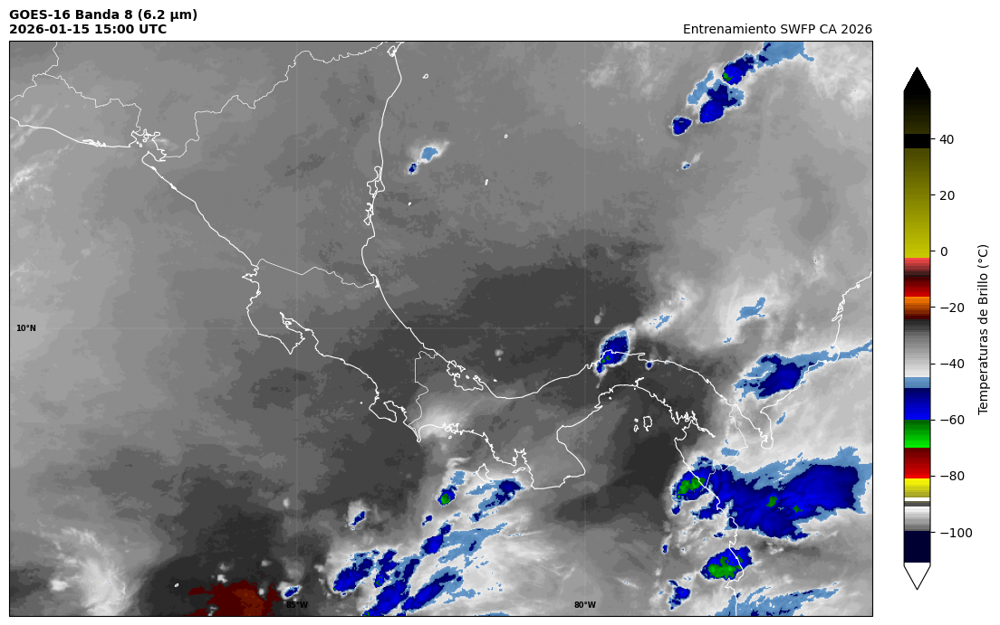

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                                  # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt                      # Creación de gráficos y mapas base
import cartopy.crs as ccrs                           # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature                   # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                                   # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime                        # Manejo básico de fechas y horas
from utilities import download_GOES, remap, loadCPT  # Descarga de archivos GOES-R y reproyección

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -90  ; max_lon = -75
min_lat = 5    ; max_lat = 15

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 8, './samples')

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS
#========================================================================================================================#
# Llama a la función de reproyección (archivo, variable, extensión, resolución), lee los datos devueltos y los convierte a °C
data = remap(file, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
img_extent = [min_lon, max_lon, min_lat, max_lat]

# Read a colormap from file
from matplotlib.colors import LinearSegmentedColormap
cmap = LinearSegmentedColormap('cpt', loadCPT('SVGAWVX_TEMP.cpt'))
#cmap = LinearSegmentedColormap('cpt', loadCPT('WVCOLOR35.cpt'))
vmin = -112.15 ; vmax = 56.85

# Grafica la imagen
img = ax.imshow(data, origin='upper', vmin=vmin, vmax=vmax, extent=img_extent, cmap=cmap)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='white', linestyle='--', linewidth=0.1, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
plt.colorbar(img, label='Temperaturas de Brillo (°C)', extend='both', orientation='vertical', pad=0.03, shrink=0.5)

# Lee la fecha del archivo
ds = xr.open_dataset(file)
date = (datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# Agrega un título
plt.title(f'GOES-16 Banda 8 (6.2 µm) \n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 1.9 RGB Day Cloud Phase Distinction - Recorte Regional
Guía Rápida: https://rammb2.cira.colostate.edu/wp-content/uploads/2024/07/QuickGuide_DayCloudPhaseDistinctionRGB_es.pdf
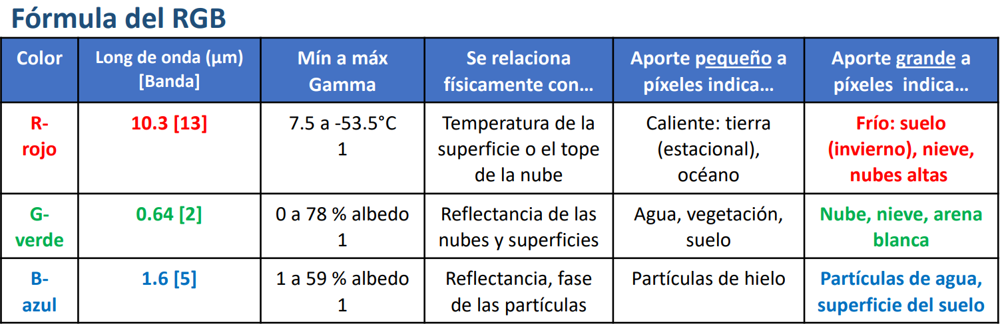

File ./samples/OR_ABI-L2-CMIPF-M6C13_G19_s20260151500214_e20260151509535_c20260151510005.nc already exists
File ./samples/OR_ABI-L2-CMIPF-M6C02_G19_s20260151500214_e20260151509523_c20260151509570.nc already exists
File ./samples/OR_ABI-L2-CMIPF-M6C05_G19_s20260151500214_e20260151509523_c20260151509571.nc already exists
Remapping...
Remap finished! Time: 0.25 seconds
Remapping...
Remap finished! Time: 0.41 seconds
Remapping...
Remap finished! Time: 0.34 seconds


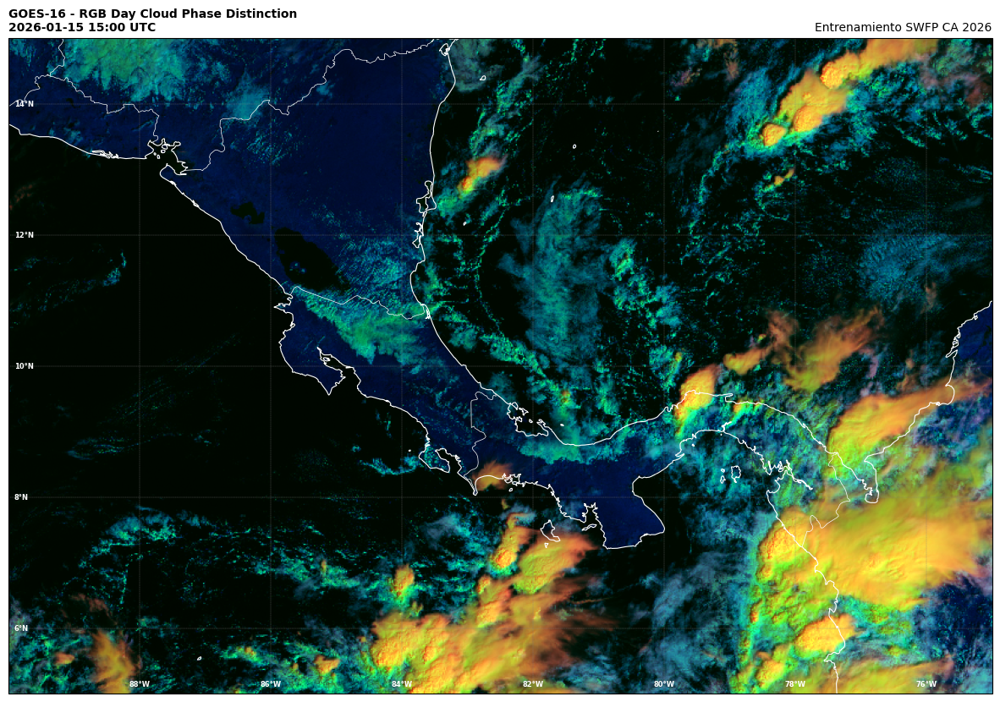

In [ ]:
#========================================================================================================================#
#                                               LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt             # Creación de gráficos y mapas base
import cartopy.crs as ccrs                  # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature          # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                          # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime               # Manejo básico de fechas y horas
from utilities import download_GOES, remap  # Descarga de archivos GOES-R y reproyección

#========================================================================================================================#
#                                                REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -90  ; max_lon = -75
min_lat = 5    ; max_lat = 15

#========================================================================================================================#
#                                                 DESCARGA DE DATOS
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file_13 = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 13, './samples')

# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file_02 = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 2, './samples')

# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file_05 = download_GOES('2026-01-15 15:00', 'G19', 'ABI-L2-CMIPF', 5, './samples')

#========================================================================================================================#
#                                              PROCESAMIENTO DE DATOS
#========================================================================================================================#

# Llama a la función de reproyección (archivo, variable, extensión, resolución), lee los datos devueltos
data_13 = remap(file_13, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15
data_02 = remap(file_02, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()
data_05 = remap(file_05, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()

#========================================================================================================================#
#                                                    RECETA RGB
#========================================================================================================================#
# Guía Rápida: https://rammb2.cira.colostate.edu/wp-content/uploads/2020/01/QuickGuide_DayCloudPhaseDistinctionRGB_es-1.pdf

# Componentes RGB
R = data_13
G = data_02
B = data_05

# Límites recomendados para este RGB
Rmin, Rmax = 7.5, -53.5
Gmin, Gmax = 0.0, 0.78
Bmin, Bmax = 0.01, 0.59

# Recortamos valores fuera de rango
R = np.clip(R, Rmax, Rmin)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Factor gamma
gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalización del dato
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Crea el RGB
RGB = np.stack([R, G, B], axis=2)

#========================================================================================================================#
#                                                  GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
img_extent = [min_lon, max_lon, min_lat, max_lat]

# Grafica la imagen
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 2), ylocs=np.arange(-90, 90, 2), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

# Lee la fecha del archivo
ds = xr.open_dataset(file_13)
date = (datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# Agrega un título
plt.title(f'GOES-16 - RGB Day Cloud Phase Distinction \n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 1.10 RGB Night Microphysics - Recorte Regional
Guía Rápida: https://rammb2.cira.colostate.edu/wp-content/uploads/2024/07/QuickGuide_GOESR_NtMicroRGB_Final_20171026_es.pdf
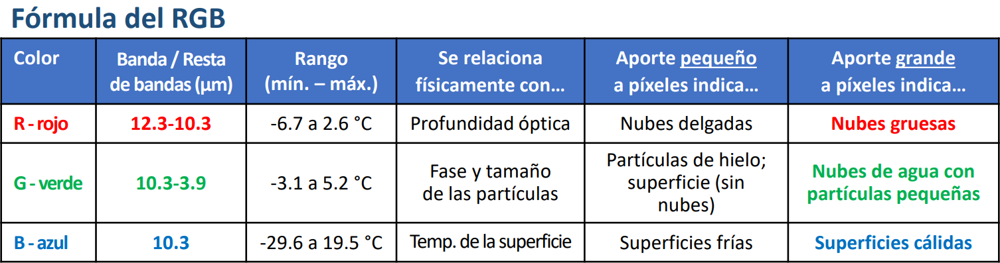

Successfully downloaded ./samples/OR_ABI-L2-CMIPF-M6C15_G19_s20260150300212_e20260150309526_c20260150309590.nc
Successfully downloaded ./samples/OR_ABI-L2-CMIPF-M6C13_G19_s20260150300212_e20260150309532_c20260150309594.nc
Successfully downloaded ./samples/OR_ABI-L2-CMIPF-M6C07_G19_s20260150300212_e20260150309532_c20260150309583.nc
Remapping...
Remap finished! Time: 0.32 seconds
Remapping...
Remap finished! Time: 0.29 seconds
Remapping...
Remap finished! Time: 0.26 seconds


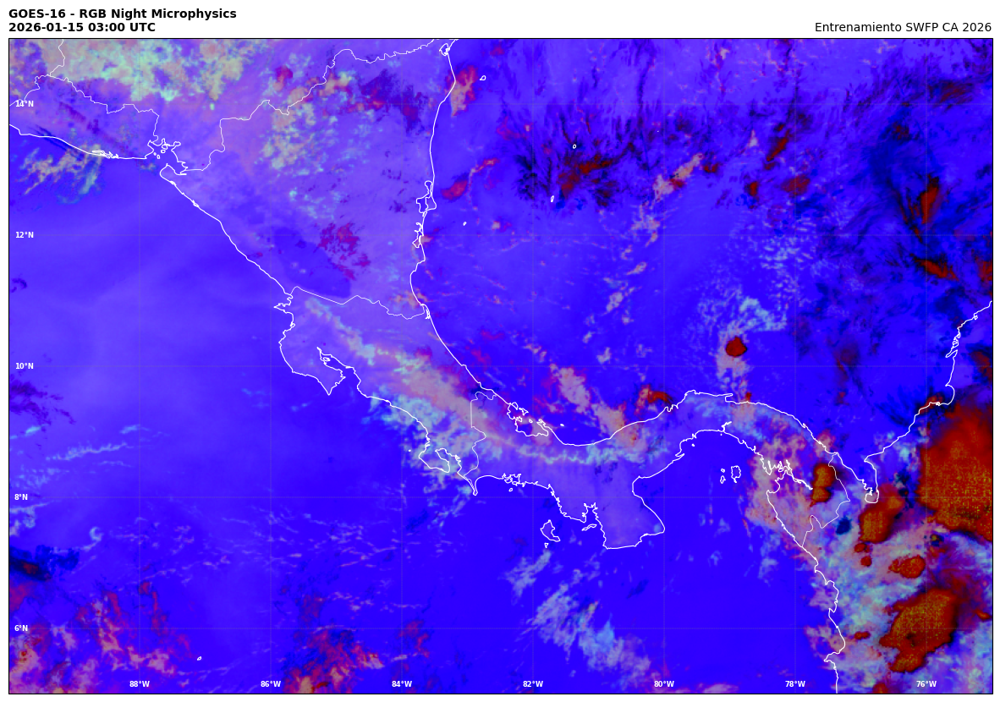

In [ ]:
#========================================================================================================================#
#                                               LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt             # Creación de gráficos y mapas base
import cartopy.crs as ccrs                  # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature          # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                          # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime               # Manejo básico de fechas y horas
from utilities import download_GOES, remap  # Descarga de archivos GOES-R y reproyección

#========================================================================================================================#
#                                                REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -90  ; max_lon = -75
min_lat = 5    ; max_lat = 15

#========================================================================================================================#
#                                                 DESCARGA DE DATOS
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file_15 = download_GOES('2026-01-15 03:00', 'G19', 'ABI-L2-CMIPF', 15, './samples')

# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file_13 = download_GOES('2026-01-15 03:00', 'G19', 'ABI-L2-CMIPF', 13, './samples')

# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file_07 = download_GOES('2026-01-15 03:00', 'G19', 'ABI-L2-CMIPF', 7, './samples')

#========================================================================================================================#
#                                              PROCESAMIENTO DE DATOS
#========================================================================================================================#

# Llama a la función de reproyección (archivo, variable, extensión, resolución), lee los datos devueltos
data_15 = remap(file_15, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15
data_13 = remap(file_13, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15
data_07 = remap(file_07, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15

#========================================================================================================================#
#                                                    RECETA RGB
#========================================================================================================================#
# Guía Rápida: https://rammb2.cira.colostate.edu/wp-content/uploads/2020/01/QuickGuide_DayCloudPhaseDistinctionRGB_es-1.pdf

# Componentes RGB
R = data_15 - data_13
G = data_13 - data_07
B = data_13

# Límites recomendados para este RGB
Rmin, Rmax = -6.7, 2.6
Gmin, Gmax = -3.1, 5.2
Bmin, Bmax = -29.60, 19.50

# Recortamos valores fuera de rango
R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Factor gamma
gamma_R = 1
gamma_G = 1
gamma_B = 1

# Normalización del dato
R = ((R - Rmin) / (Rmax - Rmin)) ** (1/gamma_R)
G = ((G - Gmin) / (Gmax - Gmin)) ** (1/gamma_G)
B = ((B - Bmin) / (Bmax - Bmin)) ** (1/gamma_B)

# Crea el RGB
RGB = np.stack([R, G, B], axis=2)

#========================================================================================================================#
#                                                  GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
img_extent = [min_lon, max_lon, min_lat, max_lat]

# Grafica la imagen
img = ax.imshow(RGB, origin='upper', extent=img_extent)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 2), ylocs=np.arange(-90, 90, 2), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

# Lee la fecha del archivo
ds = xr.open_dataset(file_13)
date = (datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

# Agrega un título
plt.title(f'GOES-16 - RGB Night Microphysics \n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 1.11 GLM - Detección de un único horário

File ./samples/OR_GLM-L2-LCFA_G16_s20201201430000_e20201201430200_c20201201430223.nc already exists


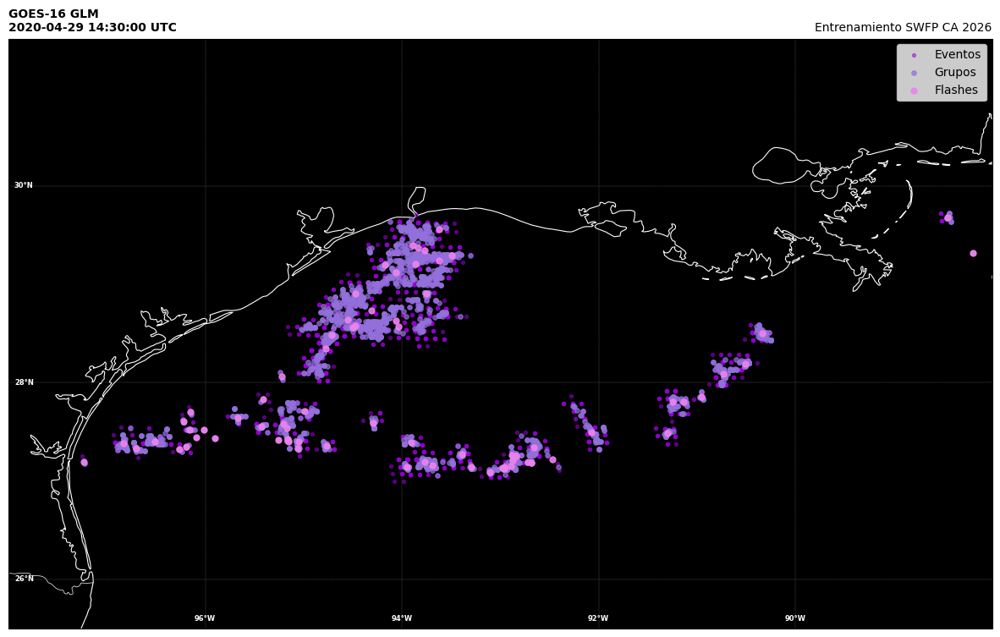

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt             # Creación de gráficos y mapas base
import cartopy.crs as ccrs                  # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature          # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                          # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime               # Manejo básico de fechas y horas
from utilities import download_GOES, remap  # Descarga de archivos GOES-R y reproyección

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -98  ; max_lon = -88
min_lat = 25.5 ; max_lat = 31.5

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file_glm = download_GOES('2020-04-29 14:30:00', 'G16', 'GLM-L2-LCFA', None, './samples')

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS
#========================================================================================================================#

# Lee el archivo
glm_ds = xr.open_dataset(file_glm)

# Obtiene los valores de píxeles glm (eventos, grupos y flashes)
e_lats = glm_ds['event_lat'].values
e_lons = glm_ds['event_lon'].values
g_lats = glm_ds['group_lat'].values
g_lons = glm_ds['group_lon'].values
f_lats = glm_ds['flash_lat'].values
f_lons = glm_ds['flash_lon'].values

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
img_extent = [min_lon, max_lon, min_lat, max_lat]
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Deja el fondo de la imagen negro
ax.set_facecolor('black')

# Eventos
ax.scatter(e_lons, e_lats, marker='o', c='darkviolet', s=8, alpha=0.5, transform=ccrs.PlateCarree(), label='Eventos', zorder=5)
# Grupos
ax.scatter(g_lons, g_lats, marker='o', c='mediumpurple', s=15, alpha=0.7, transform=ccrs.PlateCarree(), label='Grupos', zorder=10)
# Flashes
ax.scatter(f_lons, f_lats, marker='o', c='violet', s=25, alpha=0.9, transform=ccrs.PlateCarree(), label='Flashes', zorder=15)

# Agrega leyendas
ax.legend()

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 2), ylocs=np.arange(-90, 90, 2), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

# Lee la fecha del archivo
date = (datetime.strptime(glm_ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M:%S UTC')

# Agrega un título
plt.title(f'GOES-16 GLM\n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 1.12 GLM - Acumulado de "x" Minutos

Descargando GLM desde 2020-04-29 14:30:00 hasta 2020-04-29 14:35:00
File ./samples/OR_GLM-L2-LCFA_G16_s20201201430000_e20201201430200_c20201201430223.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201430200_e20201201430400_c20201201430425.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201430400_e20201201431000_c20201201431017.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201431000_e20201201431200_c20201201431219.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201431200_e20201201431400_c20201201431429.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201431400_e20201201432000_c20201201432020.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201432000_e20201201432200_c20201201432229.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201432200_e20201201432400_c20201201432429.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201432400_e20201201433000_c20201201433019.nc already exists
File ./samples/OR_GLM-L2-LCFA_G1

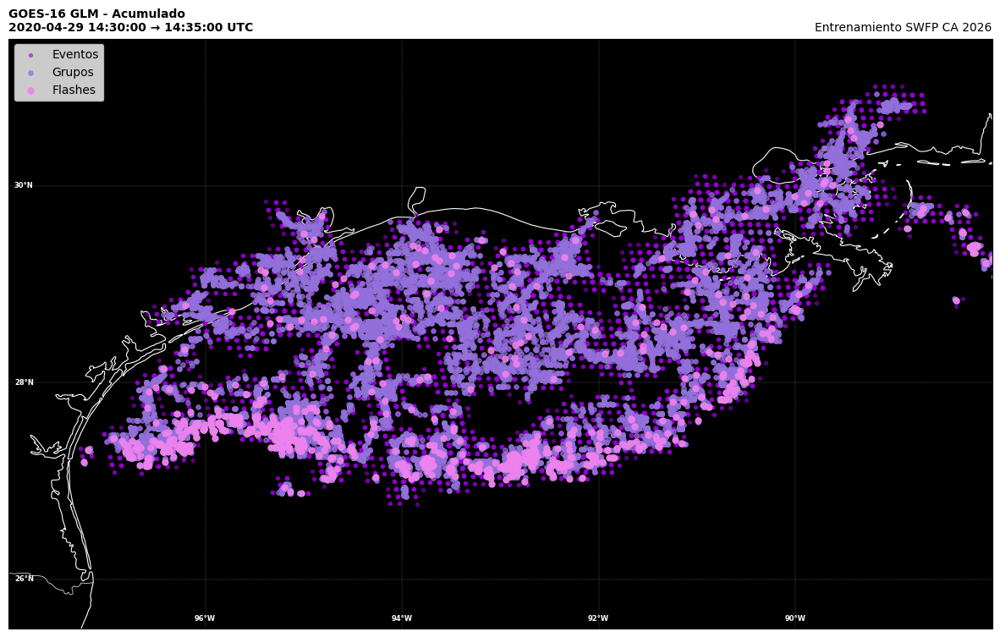

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Para leer y manejar archivos NetCDF (formato típico de datos satelitales)
import matplotlib.pyplot as plt             # Biblioteca principal para crear gráficos y visualizaciones
import cartopy.crs as ccrs                  # Proporciona sistemas de coordenadas y proyecciones geográficas
import cartopy.feature as cfeature          # Conjunto de características geográficas predefinidas (costas, países, etc)
import numpy as np                          # Para manejar arreglos numéricos de forma eficiente
from datetime import datetime, timedelta    # Para trabajar con fechas y horas (datetime) y diferencias de tiempo (timedelta)
from utilities import download_GOES, remap  # Funciones personalizadas: descarga de datos GOES + reproyección (no incluidas aquí)

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -98  ; max_lon = -88
min_lat = 25.5 ; max_lat = 31.5

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R (GLM)
#========================================================================================================================#
# Definimos el intervalo de tiempo que queremos descargar
start_time = datetime(2020, 4, 29, 14, 30, 0)    # Fecha y hora de inicio
end_time   = datetime(2020, 4, 29, 14, 35, 0)   # Fecha y hora de fin deseada

print(f"Descargando GLM desde {start_time} hasta {end_time}")

file_list = []                  # Lista donde guardaremos las rutas de los archivos descargados
current_time = start_time       # Variable auxiliar para recorrer el tiempo

# Bucle que avanza de 20 en 20 segundos (cadencia típica de archivos GLM-LCFA)
while current_time < end_time:
    time_str = current_time.strftime('%Y-%m-%d %H:%M:%S')                    # Formato de fecha que espera la función de descarga
    file = download_GOES(time_str, 'G16', 'GLM-L2-LCFA', None, './samples')  # Descarga el archivo

    if file is not None:        # Solo guardamos si la descarga fue exitosa
        file_list.append(file)

    current_time += timedelta(seconds=20)   # Avanzamos 20 segundos

print(f"Se descargaron {len(file_list)} archivos GLM")

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS
#========================================================================================================================#

# Creamos listas vacías para ir acumulando TODAS las coordenadas de todos los archivos
all_e_lons, all_e_lats = [], []    # Eventos: longitud y latitud
all_g_lons, all_g_lats = [], []    # Grupos
all_f_lons, all_f_lats = [], []    # Flashes

# Recorremos cada archivo descargado
for file_glm in file_list:
    try:
        glm_ds = xr.open_dataset(file_glm)           # Abrimos el archivo NetCDF

        # Extraemos y acumulamos las coordenadas de cada tipo de detección
        all_e_lons.extend(glm_ds['event_lon'].values)   # Eventos - longitudes
        all_e_lats.extend(glm_ds['event_lat'].values)   # Eventos - latitudes
        all_g_lons.extend(glm_ds['group_lon'].values)   # Grupos - longitudes
        all_g_lats.extend(glm_ds['group_lat'].values)   # Grupos - latitudes
        all_f_lons.extend(glm_ds['flash_lon'].values)   # Flashes - longitudes
        all_f_lats.extend(glm_ds['flash_lat'].values)   # Flashes - latitudes

        glm_ds.close()           # Buena práctica: cerramos el archivo para liberar memoria

    except:
        pass                     # Si falla algún archivo → lo ignoramos y continuamos

# Convertimos las listas acumuladas en arreglos NumPy (más rápidos para graficar)
e_lons = np.array(all_e_lons)
e_lats = np.array(all_e_lats)
g_lons = np.array(all_g_lons)
g_lats = np.array(all_g_lats)
f_lons = np.array(all_f_lons)
f_lats = np.array(all_f_lats)

print(f"Total acumulado → Eventos: {len(e_lons):,} | Grupos: {len(g_lons):,} | Flashes: {len(f_lons):,}")

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
plt.figure(figsize=(15,15))                     # Creamos una figura grande (15x15 pulgadas)

# Creamos un eje con proyección geográfica PlateCarree (equidistante simple)
ax = plt.axes(projection=ccrs.PlateCarree())

# Establecemos los límites geográficos exactos que queremos ver
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo completamente negro (estilo típico para detecciones de rayos nocturnas)
ax.set_facecolor('black')

# Graficamos los eventos (más numerosos → tamaño pequeño y transparencia alta)
ax.scatter(e_lons, e_lats, marker='o', c='darkviolet', s=8, alpha=0.5, transform=ccrs.PlateCarree(), label='Eventos', zorder=5)

# Graficamos los grupos (intermedio)
ax.scatter(g_lons, g_lats, marker='o', c='mediumpurple', s=15, alpha=0.7, transform=ccrs.PlateCarree(), label='Grupos', zorder=10)

# Graficamos los flashes (menos cantidad → tamaño grande y alta visibilidad)
ax.scatter(f_lons, f_lats, marker='o', c='violet', s=25, alpha=0.9, transform=ccrs.PlateCarree(), label='Flashes', zorder=15)

# Mostramos la leyenda con los nombres de cada categoría
ax.legend()

# Añadimos elementos geográficos importantes
ax.coastlines(resolution='10m', color='white', linewidth=0.8)      # Líneas de costa
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5) # Fronteras políticas

# Creamos grilla con etiquetas
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 2), ylocs=np.arange(-90, 90, 2), draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

# Determinamos el texto de la fecha que aparecerá en el título
if file_list:
    try:
        first_ds = xr.open_dataset(file_list[0])
        last_ds  = xr.open_dataset(file_list[-1])

        t_start = datetime.strptime(first_ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')
        t_end   = datetime.strptime(last_ds.time_coverage_end,   '%Y-%m-%dT%H:%M:%S.%fZ')

        date_str = f"{t_start.strftime('%Y-%m-%d %H:%M:%S')} → {t_end.strftime('%H:%M:%S UTC')}"

        first_ds.close()
        last_ds.close()
    except:
        # En caso de error → mostramos rango aproximado basado en lo que pidió el usuario
        date_str = f"Acumulado desde {start_time.strftime('%Y-%m-%d %H:%M')} hasta {end_time.strftime('%H:%M UTC')}"
else:
    date_str = "No se descargaron archivos"

# Títulos del gráfico
plt.title(f'GOES-16 GLM - Acumulado\n{date_str}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guardamos la imagen con nombre que incluye la hora de inicio y fin
plt.savefig(f'/content/output/imagen_acum_{start_time.strftime("%H%M")}_{end_time.strftime("%H%M")}.png',
            bbox_inches='tight', dpi=150)

# Mostramos el gráfico en pantalla
plt.show()

### 1.13 RGB + GLM Acumulado

File ./samples/OR_ABI-L2-CMIPF-M6C13_G16_s20201201430157_e20201201439477_c20201201439557.nc already exists
File ./samples/OR_ABI-L2-CMIPF-M6C02_G16_s20201201430157_e20201201439465_c20201201439540.nc already exists
File ./samples/OR_ABI-L2-CMIPF-M6C05_G16_s20201201430157_e20201201439465_c20201201439543.nc already exists
Descargando GLM desde 2020-04-29 14:30:00 hasta 2020-04-29 14:40:00
File ./samples/OR_GLM-L2-LCFA_G16_s20201201430000_e20201201430200_c20201201430223.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201430200_e20201201430400_c20201201430425.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201430400_e20201201431000_c20201201431017.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201431000_e20201201431200_c20201201431219.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201431200_e20201201431400_c20201201431429.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20201201431400_e20201201432000_c20201201432020.nc already exists
File ./samp

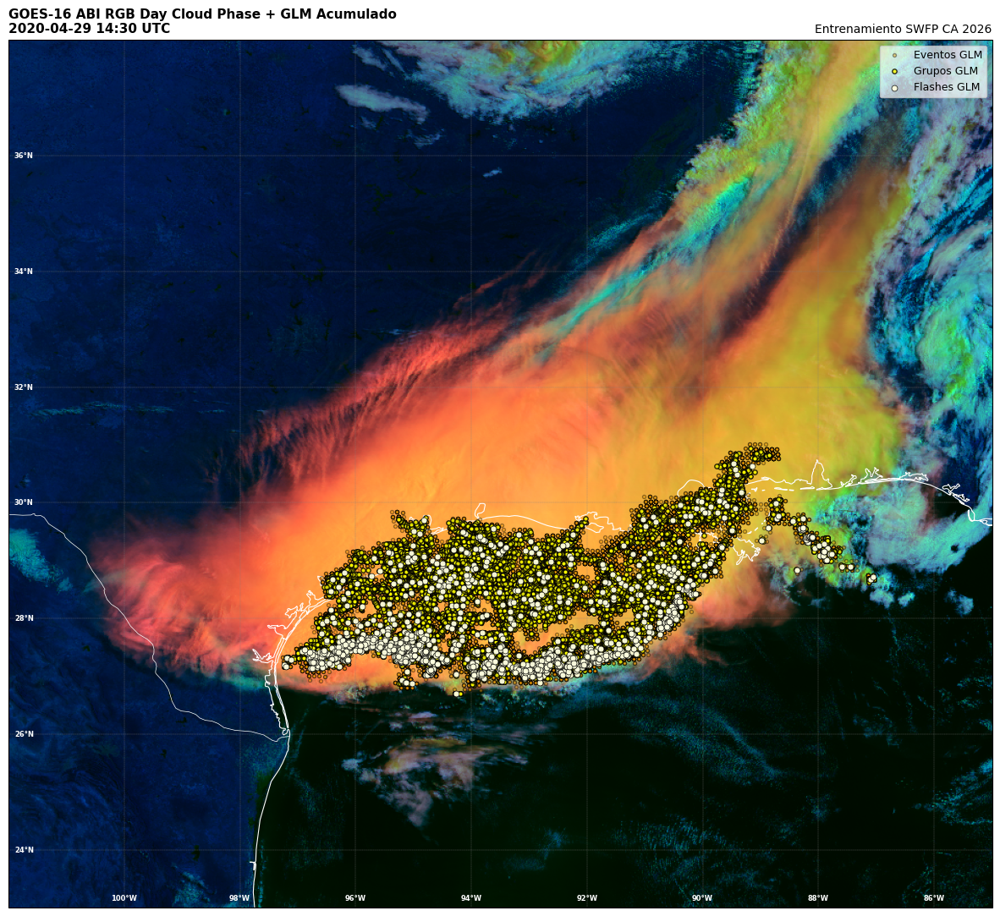

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Para leer y manejar archivos NetCDF (formato típico de datos satelitales)
import matplotlib.pyplot as plt             # Biblioteca principal para crear gráficos y visualizaciones
import cartopy.crs as ccrs                  # Proporciona sistemas de coordenadas y proyecciones geográficas
import cartopy.feature as cfeature          # Conjunto de características geográficas predefinidas (costas, países, etc)
import numpy as np                          # Para manejar arreglos numéricos de forma eficiente
from datetime import datetime, timedelta    # Para trabajar con fechas y horas (datetime) y diferencias de tiempo (timedelta)
from utilities import download_GOES, remap  # Funciones personalizadas: descarga de datos GOES + reproyección (no incluidas aquí)

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -102  ; max_lon = -85
min_lat = 23 ; max_lat = 38

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R (ABI + GLM)
#========================================================================================================================#
# ── ABI ───────────────────────────────────────────────────────────────
# Descarga bandas necesarias para RGB Day Cloud Phase Distinction
file_13 = download_GOES('2020-04-29 14:30', 'G16', 'ABI-L2-CMIPF', 13, './samples')
file_02 = download_GOES('2020-04-29 14:30', 'G16', 'ABI-L2-CMIPF', 2,  './samples')
file_05 = download_GOES('2020-04-29 14:30', 'G16', 'ABI-L2-CMIPF', 5,  './samples')

# ── GLM ───────────────────────────────────────────────────────────────
# Definimos el intervalo de tiempo para acumular rayos (GLM)
start_time = datetime(2020, 4, 29, 14, 30, 0)    # Ajusta para coincidir o estar cerca de la hora ABI
end_time   = datetime(2020, 4, 29, 14, 40, 0)    # Ejemplo: 10 minutos de acumulación

print(f"Descargando GLM desde {start_time} hasta {end_time}")

file_list = []                  # Lista donde guardaremos las rutas de los archivos GLM
current_time = start_time       # Variable auxiliar para recorrer el tiempo

# Bucle que avanza de 20 en 20 segundos (cadencia típica de archivos GLM-LCFA)
while current_time < end_time:
    time_str = current_time.strftime('%Y-%m-%d %H:%M:%S')
    file = download_GOES(time_str, 'G16', 'GLM-L2-LCFA', None, './samples')

    if file is not None:
        file_list.append(file)

    current_time += timedelta(seconds=20)

print(f"Se descargaron {len(file_list)} archivos GLM")

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS ABI (RGB)
#========================================================================================================================#
# Reproyectamos y leemos las bandas ABI en la región deseada
data_13 = remap(file_13, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15
data_02 = remap(file_02, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()
data_05 = remap(file_05, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()

#========================================================================================================================#
#                                                        RECETA RGB
#========================================================================================================================#
# Componentes RGB
R = data_13
G = data_02
B = data_05

# Límites recomendados para este RGB
Rmin, Rmax = -53.5, 7.5
Gmin, Gmax = 0.0, 0.78
Bmin, Bmax = 0.01, 0.59

# Recortamos valores fuera de rango
R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Normalización
R = (R - Rmax) / (Rmin - Rmax)
G = (G - Gmin) / (Gmax - Gmin)
B = (B - Bmin) / (Bmax - Bmin)

# Creamos la imagen RGB
RGB = np.stack([R, G, B], axis=2)

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS GLM
#========================================================================================================================#
# Listas para acumular TODAS las coordenadas de rayos
all_e_lons, all_e_lats = [], []
all_g_lons, all_g_lats = [], []
all_f_lons, all_f_lats = [], []

for file_glm in file_list:
    try:
        glm_ds = xr.open_dataset(file_glm)

        # Acumular coordenadas
        all_e_lons.extend(glm_ds['event_lon'].values)
        all_e_lats.extend(glm_ds['event_lat'].values)
        all_g_lons.extend(glm_ds['group_lon'].values)
        all_g_lats.extend(glm_ds['group_lat'].values)
        all_f_lons.extend(glm_ds['flash_lon'].values)
        all_f_lats.extend(glm_ds['flash_lat'].values)

        glm_ds.close()
    except:
        pass  # Si falla un archivo → lo ignoramos

# Convertimos a arrays NumPy
e_lons = np.array(all_e_lons)
e_lats = np.array(all_e_lats)
g_lons = np.array(all_g_lons)
g_lats = np.array(all_g_lats)
f_lons = np.array(all_f_lons)
f_lats = np.array(all_f_lats)

print(f"Total GLM acumulado → Eventos: {len(e_lons):,} | Grupos: {len(g_lons):,} | Flashes: {len(f_lons):,}")

#========================================================================================================================#
#                                        GRAFICA LA IMAGEN (ABI RGB + GLM overlay)
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Establecemos los límites geográficos
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo negro (por si hay áreas sin datos RGB)
ax.set_facecolor('black')

# Graficamos la imagen RGB de ABI (base)
img = ax.imshow(RGB, origin='upper', extent=[min_lon, max_lon, min_lat, max_lat], transform=ccrs.PlateCarree(), zorder=1)

# ── Superponemos GLM ────────────────────────────────────────────────────────────────
# Eventos (muchos → pequeño y más transparente)
ax.scatter(e_lons, e_lats, marker='o', c='orange', edgecolor='black', s=8, alpha=0.4, transform=ccrs.PlateCarree(), label='Eventos GLM', zorder=5)

# Grupos (intermedio)
ax.scatter(g_lons, g_lats, marker='o', c='yellow', edgecolor='black', s=15, alpha=0.8, transform=ccrs.PlateCarree(), label='Grupos GLM', zorder=10)

# Flashes (destacados - tamaño grande y brillante)
ax.scatter(f_lons, f_lats, marker='o', c='lightyellow', edgecolor='black', s=25, alpha=0.95, linewidth=0.5, transform=ccrs.PlateCarree(), label='Flashes GLM', zorder=15)

# Leyenda
ax.legend(loc='upper right', fontsize=9, framealpha=0.7)

# Elementos geográficos
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)

# Grilla con etiquetas
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180,180,2), ylocs=np.arange(-90,90,2), draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color':'white', 'size':6, 'weight':'bold'}
gl.xlabel_style = {'color':'white', 'size':6, 'weight':'bold'}

# Fecha (usamos la del archivo ABI principal)
try:
    ds = xr.open_dataset(file_13)
    date = datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ').strftime('%Y-%m-%d %H:%M UTC')
    ds.close()
except:
    date = "Fecha ABI no disponible"

# Títulos
plt.title(f'GOES-16 ABI RGB Day Cloud Phase + GLM Acumulado\n{date}', fontweight='bold', fontsize=11, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guardamos la imagen combinada
plt.savefig(f'/content/output/imagen_ABI_RGB_GLM_{start_time.strftime("%H%M")}_{end_time.strftime("%H%M")}.png', bbox_inches='tight', dpi=150)

# Mostramos
plt.show()

## **Ejemplo 2: Datos LEO - Acceso y Procesamiento de Productos NOAA/MetOp/JPSS**

### 2.1 Agua Precipitable MIMIC:
Fuente de Datos: https://bin.ssec.wisc.edu/pub/mtpw2/data/

Guía Rápida: https://rammb2.cira.colostate.edu/wp-content/uploads/2020/01/Blended_TPW_Quick_Guide_v1_update.pdf

Descargando MIMIC TPW v2 desde CIMSS: comp20260115.150000.nc
URL: https://bin.ssec.wisc.edu/pub/mtpw2/data/202601/comp20260115.150000.nc
Descarga exitosa: ./samples/comp20260115.150000.nc


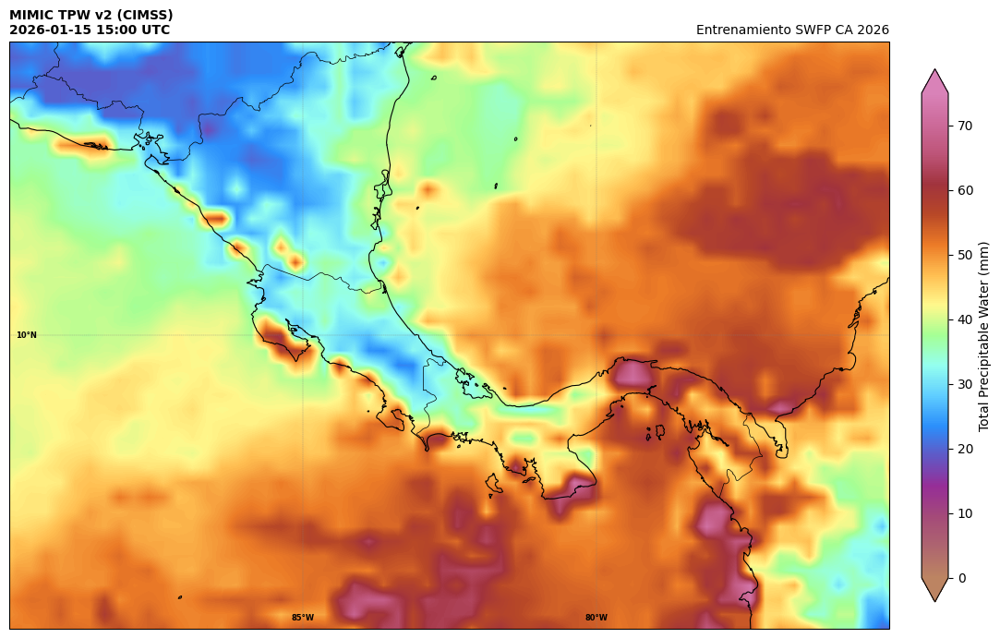

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt             # Creación de gráficos y mapas base
import cartopy.crs as ccrs                  # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature          # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                          # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime               # Manejo básico de fechas y horas
from utilities import download_mimic_tpw    # Función de descarga MIMIC TPW v2 (ya implementada en tu utilities.py)

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -90  ; max_lon = -75
min_lat = 5    ; max_lat = 15

#========================================================================================================================#
#                                       DESCARGA DE DATOS MIMIC TPW v2
#========================================================================================================================#
# Descarga el archivo MIMIC TPW v2 de una fecha/hora específica
file_mimic = download_mimic_tpw('2026-01-15 15:00', output_dir='./samples')

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS
#========================================================================================================================#
# Abrimos el archivo NetCDF descargado
ds = xr.open_dataset(file_mimic)
data = ds['tpwGrid'].values

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (esto "recorta" visualmente la región deseada)
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Paleta de colores típica para MIMIC TPW
from matplotlib.colors import LinearSegmentedColormap
colors = ["#bc8462", "#ae656f", "#a44a79", "#962e97", "#6158c5", "#2b8ffb", "#5fcdff", "#94fff0", "#a5ff94", "#fff88c",
          "#ffbf52", "#ec7b27", "#b84827", "#a1333d", "#bd5478", "#cc6a99", "#d982b8"]
cmap = LinearSegmentedColormap.from_list("mimic_tpw", colors)

# Grafica la imagen completa (Cartopy se encarga del zoom)
img = ax.imshow(data, origin='lower', vmin=0, vmax=75, extent=[-180, 180, -90, 90], cmap=cmap, interpolation='bilinear')

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
plt.colorbar(img, label='Total Precipitable Water (mm)', extend='both', orientation='vertical', pad=0.03, shrink=0.5)

# Fecha aproximada del archivo (del nombre del archivo)
filename = file_mimic.split('/')[-1]
date_str = filename[4:12] + " " + filename[13:17]  # compYYYYMMDD.HHMM00.nc
date = f"{date_str[:4]}-{date_str[4:6]}-{date_str[6:8]} {date_str[9:11]}:{date_str[11:13]} UTC"

# Agrega un título
plt.title(f'MIMIC TPW v2 (CIMSS)\n{date}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen_mimic_tpw.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 2.2 Agua Precipitable Advectada por Capas (ALPW - CIRA)
Fuente de Datos:

https://registry.opendata.aws/noaa-jpss/

https://noaa-jpss.s3.amazonaws.com/index.html#JPSS_Blended_Products/BHP_ALPW/

Guía Rápida: https://rammb2.cira.colostate.edu/wp-content/uploads/2020/01/QuickGuide_ALPW_20250611.pdf

Searching for files in:
JPSS_Blended_Products/BHP_ALPW/2026/01/15/

File found:
BHP-ALPW_v1r0_blend_s202601150600000_e202601151500000_c202601151507135.nc
URL: https://noaa-jpss.s3.amazonaws.com/JPSS_Blended_Products/BHP_ALPW/2026/01/15/BHP-ALPW_v1r0_blend_s202601150600000_e202601151500000_c202601151507135.nc

✓ Download completed
File saved at: ./samples/BHP-ALPW_v1r0_blend_s202601150600000_e202601151500000_c202601151507135.nc
File size: 36,290,239 bytes


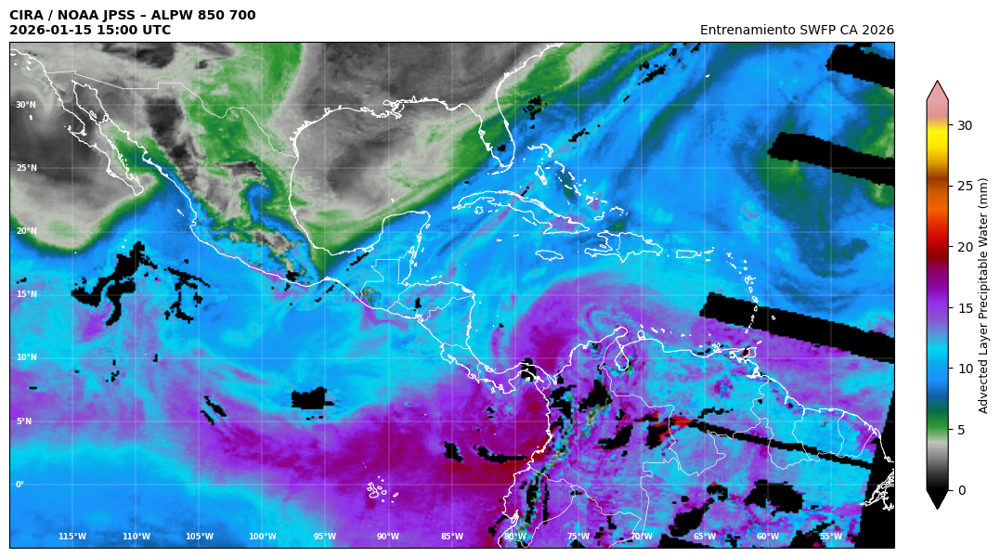

In [ ]:
#========================================================================================================================#
#                                           LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt             # Creación de gráficos y mapas base
import cartopy.crs as ccrs                  # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature          # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                          # Operaciones numéricas (arrays, matemáticas)
from utilities import download_alpw         # Descarga de archivos ALPW

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -120  ; max_lon = -50
min_lat = -5    ; max_lat = 35

#========================================================================================================================#
#                                          DESCARGA DE DATOS ALPW
#========================================================================================================================#
file_alpw = download_alpw("2026-01-15 15:00", output_dir="./samples") # desde 23 de Enero de 2025

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS
#========================================================================================================================#
# Abrimos el archivo - mask_and_scale=True → xarray convierte automáticamente _FillValue a NaN
ds = xr.open_dataset(file_alpw, mask_and_scale=True)

# Selecciona la capa ALPW (opciones: "ALPW_SFC_850", "ALPW_850_700", "ALPW_700_500", "ALPW_500_300")
varname = "ALPW_850_700"
data = ds[varname]

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15, 15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Deja el fondo de la imagen negro
ax.set_facecolor('black')

# Paleta de colores
from matplotlib.colors import LinearSegmentedColormap
colors = ["#000000", "#393939", "#818181", "#bec4ba", "#339831", "#056c47", "#1360a7", "#1b91fc", "#0ca7f0", "#00d6ef",
          "#5c92d8", "#8954d1", "#922fed", "#8b07a0", "#8d0069", "#8c0002", "#cc0000", "#e22a00", "#f56200", "#d25d00",
          "#9b3900", "#dc9e00", "#ffe300", "#fffa08", "#dd928c", "#e5a3a6"]
cmap = LinearSegmentedColormap.from_list("alpw", colors)

# Grafica la imagen
img = ax.imshow(data.values, origin="lower", extent=[-180, 180, -90, 90], cmap=cmap, vmin=0, vmax=32, interpolation="bilinear")

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='white', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
cbar = plt.colorbar(img, extend="both", orientation="vertical", pad=0.03, shrink=0.4)
cbar.set_label("Advected Layer Precipitable Water (mm)", fontsize=9)

# Lee la fecha del archivo
date = (datetime.strptime(ds.attrs.get("time_coverage_end", ""), '%Y-%m-%dT%H:%M:%SZ')).strftime('%Y-%m-%d %H:%M UTC')

# Agrega un título
plt.title(f"CIRA / NOAA JPSS – {varname.replace('_', ' ')}\n{date}", loc="left", fontsize=10, fontweight="bold")
plt.title("Entrenamiento SWFP CA 2026", loc="right", fontsize=10)

# Guarda la imagen
plt.savefig("./output/alpw.png", dpi=150, bbox_inches="tight")

# Muestra la imagen
plt.show()

## **Ejemplo 3: Acceso y Procesamiento de Datos de Modelo (GFS)**

### 3.1. Descarga de datos GFS con la librería `Herbie`: https://herbie.readthedocs.io/en/stable/index.html

In [ ]:
# Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
from herbie import Herbie

# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0) # Fecha y hora de la corrida del modelo (en UTC) / Tiempo de pronóstico en horas (horizonte)

# Carga los campos de interés en un Dataset Xarray
ds = H.xarray(":PRMSL:")

# Mostramos todo el contenido del dataset (dimensiones, variables, atributos)
ds

 ╭─▌▌Herbie─────────────────────────────────────────────╮
 │ INFO: Created a default config file.                 │
 │ You may view/edit Herbie's configuration here:       │
 │          /root/.config/herbie/config.toml            │
 ╰──────────────────────────────────────────────────────╯

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ aws


<xarray.Dataset> Size: 4MB
Dimensions:              (latitude: 721, longitude: 1440)
Coordinates:
  * latitude             (latitude) float64 6kB 90.0 89.75 89.5 ... -89.75 -90.0
  * longitude            (longitude) float64 12kB 0.0 0.25 0.5 ... 359.5 359.8
    time                 datetime64[ns] 8B 2026-01-09T12:00:00
    step                 timedelta64[ns] 8B 00:00:00
    meanSea              float64 8B 0.0
    valid_time           datetime64[ns] 8B 2026-01-09T12:00:00
    gribfile_projection  object 8B None
Data variables:
    prmsl                (latitude, longitude) float32 4MB 1.012e+05 ... 9.96...
Attributes:
    GRIB_edition:            2
    GRIB_centre:             kwbc
    GRIB_centreDescription:  US National Weather Service - NCEP
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             US National Weather Service - NCEP
    model:                   gfs
    product:                 pgrb2.0p25
    description:             NOAA Global Forecast System (GFS)
    remote_grib:             https://noaa-gfs-bdp-pds.s3.amazonaws.com/gfs.20...
    local_grib:              /root/data/gfs/20260109/subset_9eef795e__gfs.t12...
    search:                  :PRMSL:

### 3.2 Fuentes de datos y productos disponibles

In [ ]:
# Fuentes GFS y productos GFS disponibles
H.SOURCES, H.PRODUCTS

({'aws': 'https://noaa-gfs-bdp-pds.s3.amazonaws.com/gfs.20260109/12/atmos/gfs.t12z.pgrb2.0p25.f000',
  'nomads': 'https://nomads.ncep.noaa.gov/pub/data/nccf/com/gfs/prod/gfs.20260109/12/atmos/gfs.t12z.pgrb2.0p25.f000',
  'google': 'https://storage.googleapis.com/global-forecast-system/gfs.20260109/12/atmos/gfs.t12z.pgrb2.0p25.f000',
  'azure': 'https://noaagfs.blob.core.windows.net/gfs/gfs.20260109/12/atmos/gfs.t12z.pgrb2.0p25.f000',
  'ncar_rda': 'https://data.rda.ucar.edu/d084001/2026/20260109/gfs.0p25.2026010912.f000.grib2'},
 {'pgrb2.0p25': 'common fields, 0.25 degree resolution',
  'pgrb2.0p50': 'common fields, 0.50 degree resolution',
  'pgrb2.1p00': 'common fields, 1.00 degree resolution',
  'pgrb2b.0p25': 'uncommon fields, 0.25 degree resolution',
  'pgrb2b.0p50': 'uncommon fields, 0.50 degree resolution',
  'pgrb2b.1p00': 'uncommon fields, 1.00 degree resolution',
  'pgrb2full.0p50': 'combined grids of 0.50 resolution',
  'sfluxgrb': 'surface flux fields, T1534 Semi-Lagrangian

### 3.3 Variables disponibles (Códigos OMM)

In [ ]:
# Variables disponibles (estándar OMM)
H.inventory()["variable"].unique()

array(['PRMSL', 'CLMR', 'ICMR', 'RWMR', 'SNMR', 'GRLE', 'REFD', 'REFC',
       'VIS', 'UGRD', 'VGRD', 'VRATE', 'GUST', 'HGT', 'TMP', 'RH', 'SPFH',
       'VVEL', 'DZDT', 'ABSV', 'O3MR', 'TCDC', 'HINDEX', 'MSLET', 'PRES',
       'TSOIL', 'SOILW', 'SOILL', 'CNWAT', 'WEASD', 'SNOD', 'ICETK',
       'DPT', 'APTMP', 'ICEG', 'CPOFP', 'PRATE', 'CSNOW', 'CICEP',
       'CFRZR', 'CRAIN', 'SFCR', 'FRICV', 'VEG', 'SOTYP', 'WILT', 'FLDCP',
       'SUNSD', 'LFTX', 'CAPE', 'CIN', 'PWAT', 'CWAT', 'TOZNE', 'LCDC',
       'MCDC', 'HCDC', 'HLCY', 'USTM', 'VSTM', 'ICAHT', 'VWSH', '4LFTX',
       'HPBL', 'POT', 'PLPL', 'LAND', 'ICEC', 'ICETMP'], dtype=object)

📘 Variables disponibles (Códigos OMM)

| Código | Nombre / Descripción |
|------|----------------------|
| PRMSL | Presión reducida al nivel medio del mar |
| CLMR | Razón de mezcla de nube (cloud mixing ratio) |
| ICMR | Razón de mezcla de hielo |
| RWMR | Razón de mezcla de lluvia |
| SNMR | Razón de mezcla de nieve |
| GRLE | Granizo (graupel) |
| REFD | Reflectividad radar base |
| REFC | Reflectividad radar compuesta |
| VIS | Visibilidad horizontal |
| UGRD | Componente zonal del viento (u) |
| VGRD | Componente meridional del viento (v) |
| VRATE | Velocidad vertical |
| GUST | Ráfaga máxima de viento |
| HGT | Altura geopotencial |
| TMP | Temperatura del aire |
| RH | Humedad relativa |
| SPFH | Humedad específica |
| VVEL | Velocidad vertical (en coordenadas de presión) |
| DZDT | Tasa de cambio de altura |
| ABSV | Vorticidad absoluta |
| O3MR | Razón de mezcla de ozono |
| TCDC | Cobertura total de nubes |
| HINDEX | Índice de calor |
| MSLET | Presión media al nivel del mar (ETA / alternativa) |
| PRES | Presión atmosférica |
| TSOIL | Temperatura del suelo |
| SOILW | Contenido de humedad del suelo |
| SOILL | Tipo de suelo |
| CNWAT | Contenido de agua en el dosel vegetal |
| WEASD | Equivalente en agua de la nieve |
| SNOD | Profundidad de nieve |
| ICETK | Espesor de hielo |
| DPT | Temperatura de punto de rocío |
| APTMP | Temperatura aparente |
| ICEG | Formación de hielo |
| CPOFP | Probabilidad de precipitación convectiva |
| PRATE | Tasa de precipitación |
| CSNOW | Precipitación convectiva de nieve |
| CICEP | Precipitación convectiva de hielo |
| CFRZR | Precipitación convectiva de lluvia helada |
| CRAIN | Precipitación convectiva de lluvia |
| SFCR | Rugosidad de la superficie |
| FRICV | Velocidad de fricción |
| VEG | Cobertura de vegetación |
| SOTYP | Tipo de suelo |
| WILT | Punto de marchitez del suelo |
| FLDCP | Capacidad de campo del suelo |
| SUNSD | Duración de la insolación |
| LFTX | Índice Lifted |
| CAPE | Energía potencial convectiva disponible |
| CIN | Inhibición convectiva |
| PWAT | Agua precipitable |
| CWAT | Agua total en la columna |
| TOZNE | Ozono total en la columna |
| LCDC | Cobertura de nubes bajas |
| MCDC | Cobertura de nubes medias |
| HCDC | Cobertura de nubes altas |
| HLCY | Helicidad relativa a la tormenta |
| USTM | Componente zonal del movimiento de tormentas |
| VSTM | Componente meridional del movimiento de tormentas |
| ICAHT | Altura de formación de hielo |
| VWSH | Cizalladura vertical del viento |
| 4LFTX | Índice Lifted de 4 capas |
| HPBL | Altura de la capa límite planetaria |
| POT | Temperatura potencial |
| PLPL | Nivel de presión del modelo |
| LAND | Máscara tierra / mar |
| ICEC | Concentración de hielo marino |
| ICETMP | Temperatura del hielo |


### 3.4 Descargando los archivos GRIB completos para procesar con otras herramientas (opcional)

In [ ]:
from herbie import Herbie

H = Herbie("2024-02-18 00:00", model="gfs", product="pgrb2.0p25", fxx=0, save_dir="/content/samples")
H.download()

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2024-Feb-18 00:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ aws
👨🏻‍🏭 Created directory: [/content/samples/gfs/20240218]


PosixPath('/content/samples/gfs/20240218/gfs.t00z.pgrb2.0p25.f000')

### 3.5 Graficación (muy) básica

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


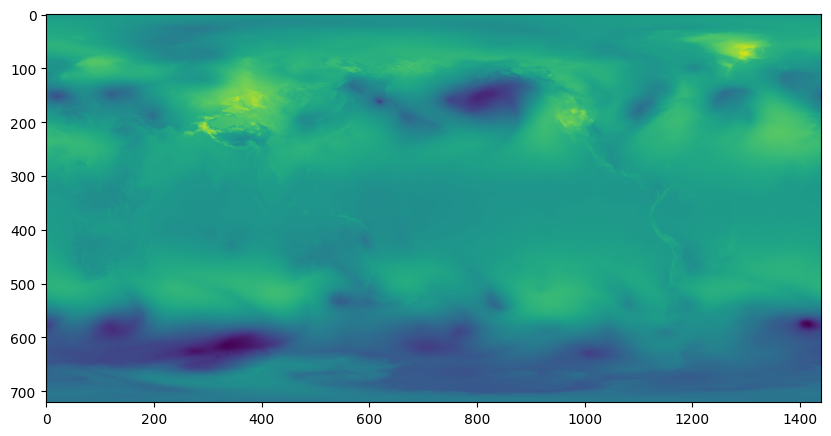

In [ ]:
from herbie import Herbie        # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import matplotlib.pyplot as plt  # Creación de gráficos y mapas base

# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga los datos de interés en un Dataset Xarray
ds = H.xarray(":PRMSL:")

# Crea una nueva figura de 10x10 pulgadas
plt.figure(figsize=(10, 10))

# Muestra los datos como imagen 2D usando el mapa de colores selecionado
plt.imshow(ds.prmsl, cmap="viridis")

# Muestra la imagen en pantalla
plt.show()

### 3.6 Graficación más completa

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


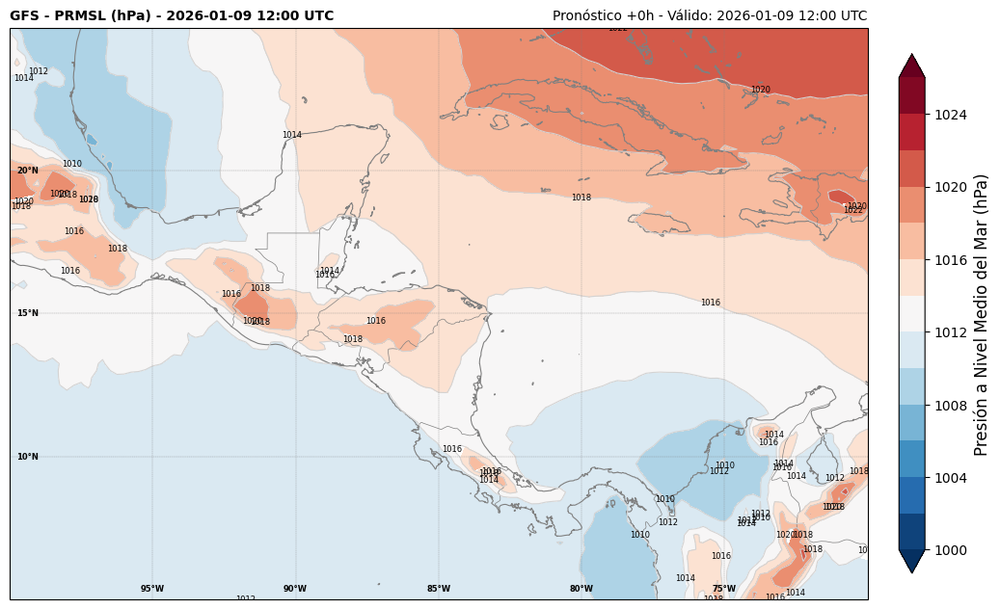

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime       # Manejo básico de fechas y horas

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga los datos de interés en un Dataset Xarray
ds = H.xarray(":PRMSL:")
ds = ds.sel(longitude=slice(min_lon + 360, max_lon + 360), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                       PROCESAMINETO DE LA INFORMACIÓN
#========================================================================================================================#
# Convierte de Pa a hPa
msl_hpa = ds.prmsl / 100

# Lee las coodinadas para la región deseada
lon = ds.longitude.values
lat = ds.latitude.values

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles
levels = np.arange(1000, 1028, 2)

# Contornos rellenos
contour = ax.contourf(lon, lat, msl_hpa, levels=levels, cmap='RdBu_r', extend='both', transform=ccrs.PlateCarree())

# Isóbaras
ax.contour(lon, lat, msl_hpa, levels=levels, colors='lightgray', linewidths=0.8, transform=ccrs.PlateCarree())

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='gray', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='gray', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
cbar = plt.colorbar(contour, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Presión a Nivel Medio del Mar (hPa)', fontsize=12)

# Agrega un título
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS - PRMSL (hPa) - {run_str}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/salida_modelo.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

## **Ejemplo 4: Superponiendo Datos - Satélites y Modelo**

File ./samples/OR_ABI-L2-CMIPF-M6C13_G19_s20260091200208_e20260091209528_c20260091209587.nc already exists
Remapping...
Remap finished! Time: 0.45 seconds
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


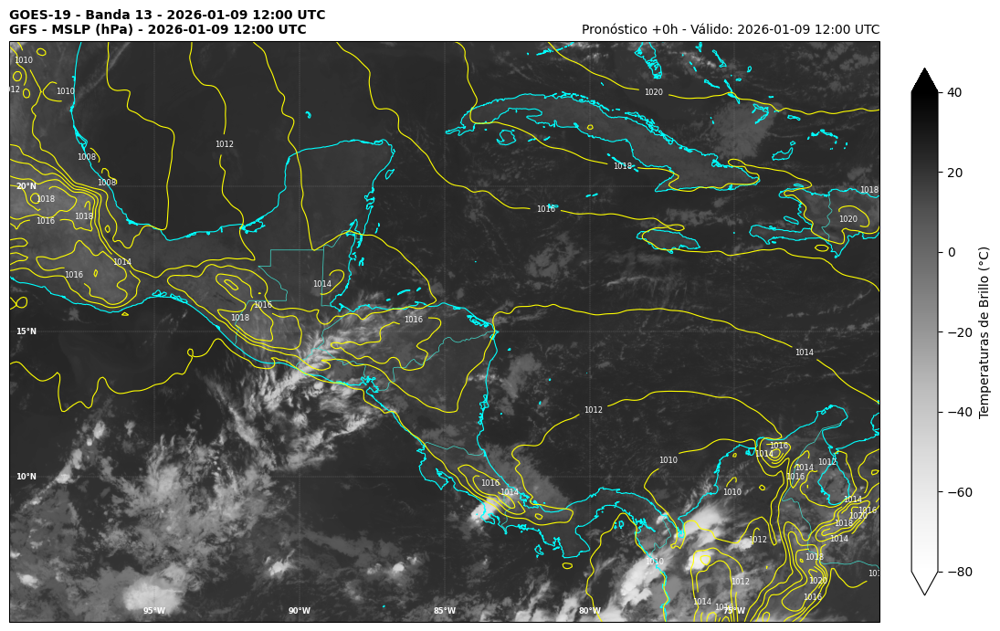

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt             # Creación de gráficos y mapas base
import cartopy.crs as ccrs                  # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature          # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                          # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime               # Manejo básico de fechas y horas
from utilities import download_GOES, remap  # Descarga de archivos GOES-R y reproyección

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                       DESCARGA Y PROCESAMIENTO GOES-R
#========================================================================================================================#
# Descarga el archivo GOES-R de una fecha específica (Disco Completo, CONUS, MESOESCALA, productos, etc)
file = download_GOES('2026-01-09 12:00', 'G19', 'ABI-L2-CMIPF', 13, './samples')

# Llama a la función de reproyección (archivo, variable, extensión, resolución)
grid = remap(file, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2)

# Lee los datos devueltos por la función y los convierte a °C
data_sat = grid.ReadAsArray() - 273.15

#========================================================================================================================#
#                                       DESCARGA Y PROCESAMIENTO GFS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0, override=True)

# Carga los datos de interés en un Dataset Xarray
ds = H.xarray(":PRMSL:")
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

# Convierte de Pa a hPa
data_nwp = ds.prmsl / 100

# Lee las coodinadas para la región deseada
lon = ds.longitude.values
lat = ds.latitude.values

# Suaviza los contornos
import scipy.ndimage
data_nwp = scipy.ndimage.zoom(data_nwp, 3)
lon = scipy.ndimage.zoom(lon, 3)
lat = scipy.ndimage.zoom(lat, 3)

#========================================================================================================================#
#                                             GRAFICA LA IMAGEN
#========================================================================================================================#
# ------------------------------------------------------------
# 1. Tamaño, proyección cartopy y región
# ------------------------------------------------------------

# Elige el tamaño de la figura (ancho x alto, en pulgadas)
plt.figure(figsize=(15,15))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
img_extent = [min_lon, max_lon, min_lat, max_lat]

# ------------------------------------------------------------
# 2. Grafica la imagen GOES-R
# ------------------------------------------------------------
img = ax.imshow(data_sat, origin='upper', vmin=-80, vmax=40, extent=img_extent, cmap='Grays')

# ------------------------------------------------------------
# 3. Grafica los campos de modelo
# ------------------------------------------------------------
# Niveles
levels = np.arange(1000, 1028, 2)

# Contornos rellenos
#contourf = ax.contourf(lon, lat, data_nwp, levels=levels, cmap='RdBu_r', extend='both', alpha=0.5, transform=ccrs.PlateCarree())

# Isóbaras
contour = ax.contour(lon, lat, data_nwp, levels=levels, colors='yellow', linewidths=0.8, transform=ccrs.PlateCarree())

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="white")
for l in labels: l.set_rotation(0)

# ------------------------------------------------------------
# 4. Elementos comunes
# ------------------------------------------------------------

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='cyan', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='turquoise', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
plt.colorbar(img, label='Temperaturas de Brillo (°C)', extend='both', orientation='vertical', pad=0.03, shrink=0.5)

# Agrega un título
ds_goes = xr.open_dataset(file)
date_goes = (datetime.strptime(ds_goes.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ')).strftime('%Y-%m-%d %H:%M UTC')

run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GOES-19 - Banda 13 - {date_goes} \nGFS - MSLP (hPa) - {run_str}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/imagen_goes_gfs.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

## **Ejemplo 5: Líneas de Corriente (Streamlines) + Leyendo Campos por Nivel**

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


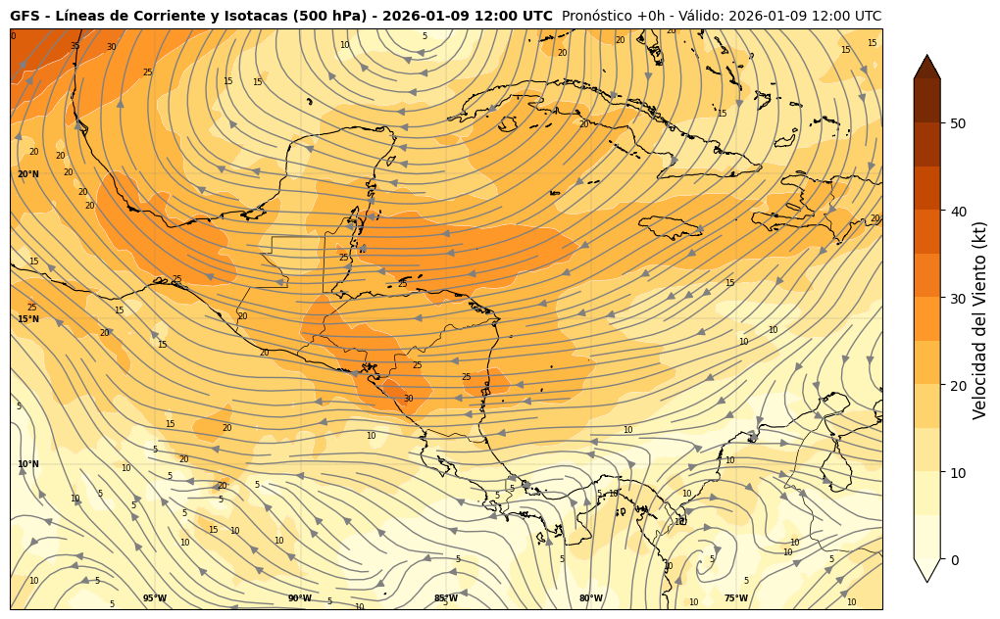

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime       # Manejo básico de fechas y horas

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento a 500 hPa, convierte las longitudes para -180 ~ 180 y selecciona solo la región de interés
ds_viento = H.xarray(":(U|V)GRD:500 mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                       PROCESAMINETO DE LA INFORMACIÓN
#========================================================================================================================#
# Extrae variables deseadas
u = ds_viento['u']  # u-component of wind (zonal)      [m/s]
v = ds_viento['v']  # v-component of wind (meridional) [m/s]

# Calcular velocidad del viento (wind speed) en kt
wind_speed_ms = np.sqrt(u**2 + v**2)
wind_speed_kt = wind_speed_ms * 1.94384

# Lee las coodinadas para la región deseada
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles
levels = np.arange(0, 60, 5)

# Contornos rellenos (isotacas coloreadas)
contourf = ax.contourf(lon, lat, wind_speed_kt, levels=levels, cmap='YlOrBr', extend='both', transform=ccrs.PlateCarree())

# Contornos líneas blancas finas
contour = ax.contour(lon, lat, wind_speed_kt, levels=levels, colors='white', linewidths=0.4, transform=ccrs.PlateCarree())

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Líneas de corriente (streamlines)
skip = 4
ax.streamplot(lon[::skip], lat[::skip], u[::skip, ::skip], v[::skip, ::skip], density=[2, 2], linewidth=1.0, color='gray', arrowsize=1.2, transform=ccrs.PlateCarree())

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Velocidad del Viento (kt)', fontsize=12)

# Agrega un título
run_str = np.datetime_as_string(ds_viento.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_viento.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS - Líneas de Corriente y Isotacas (500 hPa) - {run_str}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/salida_modelo.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

## **Ejemplo 6: Vectores**

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


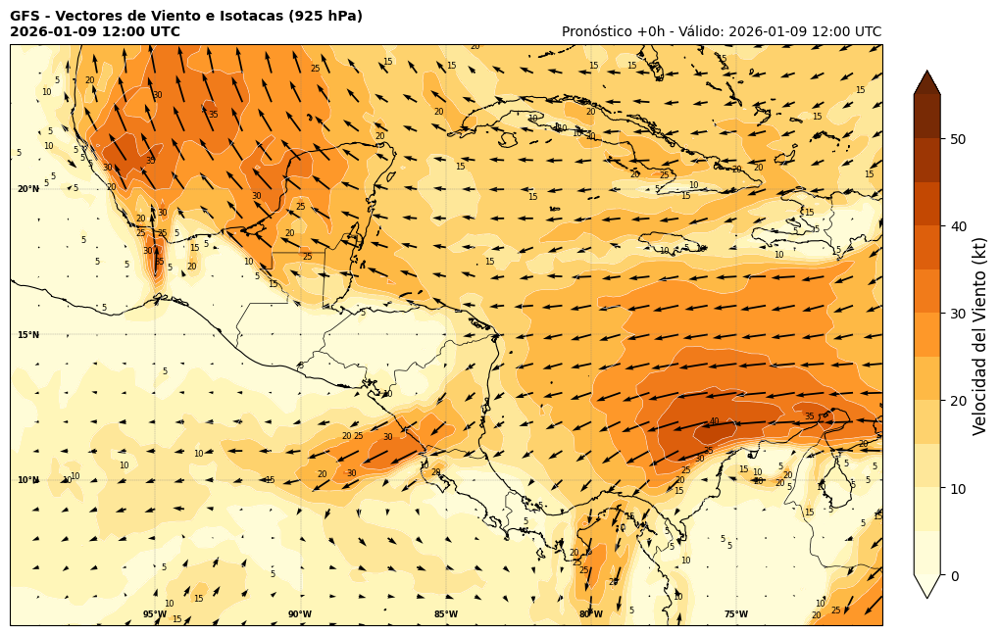

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime       # Manejo básico de fechas y horas

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS GFS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento a 925 hPa, convierte las longitudes para -180 ~ 180 y selecciona solo la región de interés
ds_viento = H.xarray(":(U|V)GRD:925 mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                       PROCESAMINETO DE LA INFORMACIÓN
#========================================================================================================================#
# Extrae las componentes u y v
u = ds_viento['u'] # componente u del viento (zonal) [m/s]
v = ds_viento['v'] # componente v del viento (meridional) [m/s]

# Calcula velocidad del viento (wind speed) en kt
wind_speed_ms = np.sqrt(u**2 + v**2)
wind_speed_kt = wind_speed_ms * 1.94384

# Lee las coodinadas para la región deseada
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles
levels = np.arange(0, 60, 5)

# Contornos rellenos (isotacas coloreadas)
contourf = ax.contourf(lon, lat, wind_speed_kt, levels=levels, cmap='YlOrBr', extend='both', transform=ccrs.PlateCarree())

# Contornos líneas blancas finas
contour = ax.contour(lon, lat, wind_speed_kt, levels=levels, colors='white', linewidths=0.4, transform=ccrs.PlateCarree())

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Vectores de viento (quiver)
skip = 4
quiver = ax.quiver(lon[::skip], lat[::skip], u[::skip, ::skip], v[::skip, ::skip], scale=500, color='black', width=0.002, headwidth=3, transform=ccrs.PlateCarree())

# Leyenda del quiver
ax.quiverkey(quiver, X=0.55, Y=0.895, U=25, label='25 kt', labelpos='E', coordinates='figure')

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Velocidad del Viento (kt)', fontsize=12)

# Agrega un título
run_str = np.datetime_as_string(ds_viento.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_viento.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS - Vectores de Viento e Isotacas (925 hPa)\n{run_str}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/salida_modelo.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

## **Ejemplo 7: Barbas**

### 7.1: Velocidad del Viento + Barbas

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


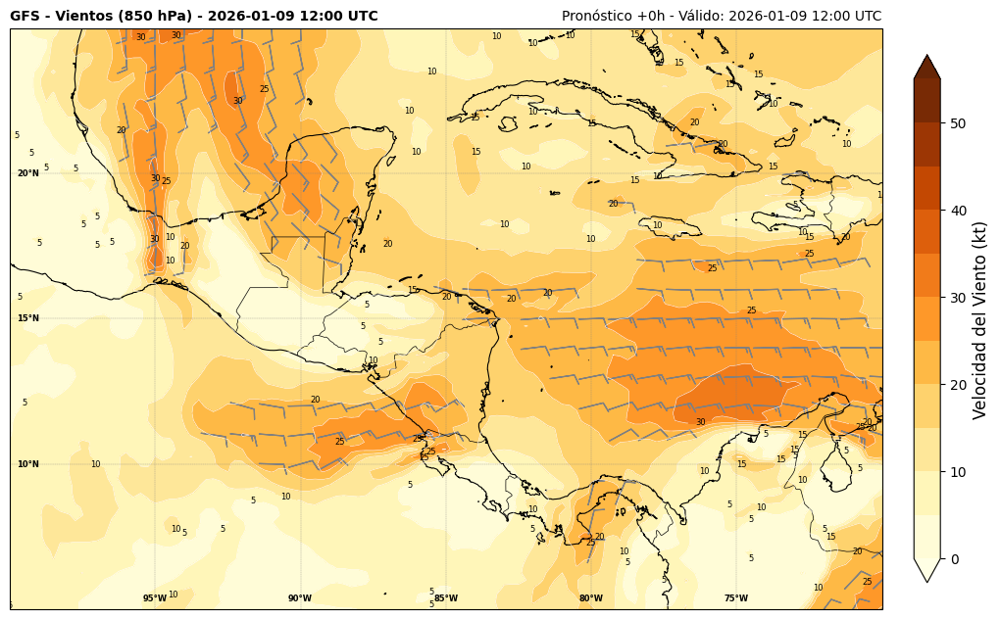

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime       # Manejo básico de fechas y horas

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS GFS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento a 850 hPa, convierte las longitudes para -180 ~ 180 y selecciona solo la región de interés
ds_viento = H.xarray(":(U|V)GRD:850 mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                       PROCESAMINETO DE LA INFORMACIÓN
#========================================================================================================================#
# Extrae las componentes u y v
u = ds_viento['u'] # componente u del viento (zonal) [m/s]
v = ds_viento['v'] # componente v del viento (meridional) [m/s]

# Calcula velocidad del viento (wind speed) en kt
wind_speed_ms = np.sqrt(u**2 + v**2)
wind_speed_kt = wind_speed_ms * 1.94384

# Lee las coodinadas para la región deseada
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values

# Creamos malla 2D consistente para las barbas
Lon, Lat = np.meshgrid(lon, lat)

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles
levels = np.arange(0, 60, 5)

# Contornos rellenos (isotacas coloreadas)
contourf = ax.contourf(lon, lat, wind_speed_kt, levels=levels, cmap='YlOrBr', extend='both', transform=ccrs.PlateCarree())

# Contornos líneas blancas finas
contour = ax.contour(lon, lat, wind_speed_kt, levels=levels, colors='white', linewidths=0.4, transform=ccrs.PlateCarree())

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Umbral de velocidad para mostrar barbas (en kt)
wind_threshold = 20  # ← puedes cambiarlo fácilmente aquí

# Máscara donde el viento es < umbral → ponemos NaN en u y v
u = u.where(wind_speed_kt >= wind_threshold)
v = v.where(wind_speed_kt >= wind_threshold)

# Barbas
skip = 4
ax.barbs(
    Lon[::skip, ::skip], Lat[::skip, ::skip], u[::skip, ::skip], v[::skip, ::skip], length=6, pivot="middle",
    barbcolor="gray", flagcolor="gray", linewidth=0.9, sizes=dict(emptybarb=0.0), flip_barb = (Lat[::skip, ::skip] < 0),
    transform=ccrs.PlateCarree()
)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Velocidad del Viento (kt)', fontsize=12)

# Agrega un título
run_str = np.datetime_as_string(ds_viento.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_viento.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS - Vientos (850 hPa) - {run_str}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/salida_modelo.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 7.2: Otros campos + Barbas

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


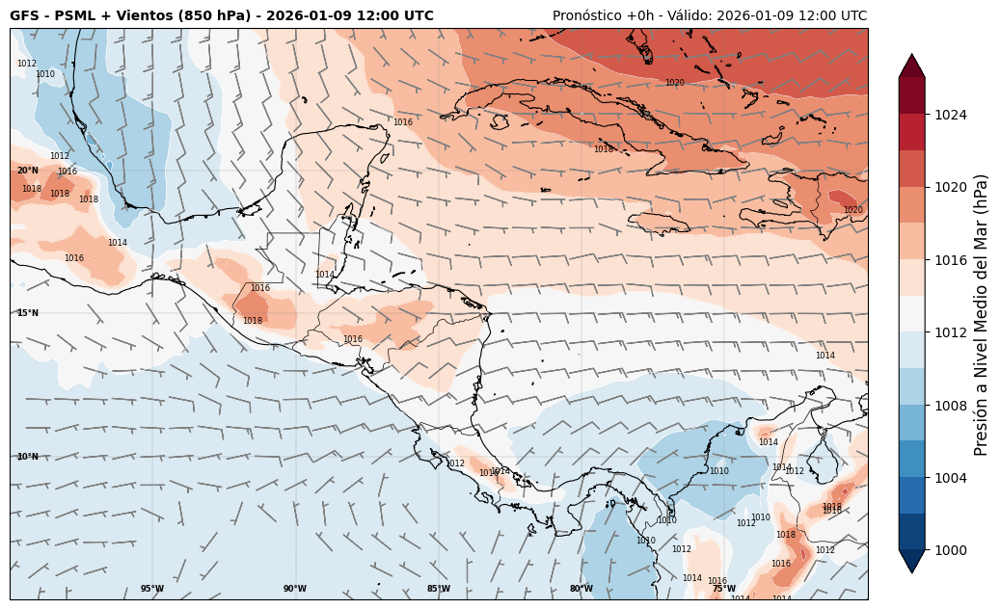

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime       # Manejo básico de fechas y horas

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS GFS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento a 850 hPa, convierte las longitudes para -180 ~ 180 y selecciona solo la región de interés
ds_viento = H.xarray(":(U|V)GRD:850 mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

# Carga presión al nivel del mar (PRMSL), convierte las longitudes para -180 ~ 180 y selecciona solo la región de interés
ds_prmsl = H.xarray(":PRMSL:")
ds_prmsl  = ds_prmsl.assign_coords(longitude=((ds_prmsl.longitude + 180) % 360) - 180).sortby("longitude")
ds_prmsl  = ds_prmsl.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                         PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Conversión de Pa a hPa
prmsl_hpa = ds_prmsl.prmsl / 100.0

# Extrae las componentes u y v
u = ds_viento['u'] # componente u del viento (zonal) [m/s]
v = ds_viento['v'] # componente v del viento (meridional) [m/s]

# Lee las coodinadas para la región deseada
lon = ds_prmsl.longitude.values
lat = ds_prmsl.latitude.values

# Creamos malla 2D consistente para las barbas
Lon, Lat = np.meshgrid(lon, lat)

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles
levels = np.arange(1000, 1028, 2)

# Contornos rellenos (isotacas coloreadas)
contourf = ax.contourf(lon, lat, prmsl_hpa, levels=levels, cmap='RdBu_r', extend='both', transform=ccrs.PlateCarree())

# Contornos líneas blancas finas
contour = ax.contour(lon, lat, prmsl_hpa, levels=levels, colors='white', linewidths=0.4, transform=ccrs.PlateCarree())

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Barbas
skip = 4
ax.barbs(
    Lon[::skip, ::skip], Lat[::skip, ::skip], u[::skip, ::skip], v[::skip, ::skip], length=6, pivot="middle",
    barbcolor="gray", flagcolor="gray", linewidth=0.9, sizes=dict(emptybarb=0.0), flip_barb = (Lat[::skip, ::skip] < 0),
    transform=ccrs.PlateCarree()
)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Presión a Nivel Medio del Mar (hPa)', fontsize=12)

# Agrega un título
run_str = np.datetime_as_string(ds_viento.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_viento.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS - PSML + Vientos (850 hPa) - {run_str}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/salida_modelo.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

### 7.3: RGB ABI + GLM + Barbas GFS

File ./samples/OR_ABI-L2-CMIPF-M6C13_G16_s20212031500232_e20212031509551_c20212031510048.nc already exists
File ./samples/OR_ABI-L2-CMIPF-M6C02_G16_s20212031500232_e20212031509540_c20212031510014.nc already exists
File ./samples/OR_ABI-L2-CMIPF-M6C05_G16_s20212031500232_e20212031509540_c20212031510007.nc already exists
Descargando GLM desde 2021-07-22 15:00:00 hasta 2021-07-22 15:10:00
File ./samples/OR_GLM-L2-LCFA_G16_s20212031500000_e20212031500200_c20212031500214.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031500200_e20212031500400_c20212031500414.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031500400_e20212031501000_c20212031501016.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031501000_e20212031501200_c20212031501215.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031501200_e20212031501400_c20212031501417.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031501400_e20212031502000_c20212031502019.nc already exists
File ./samp

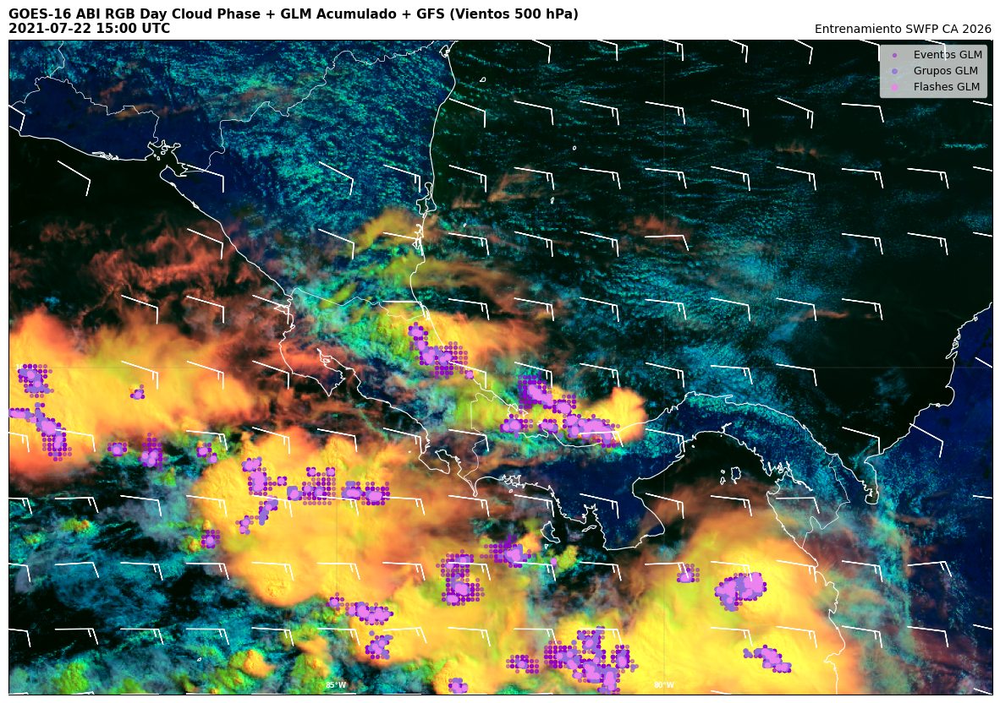

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Para leer y manejar archivos NetCDF (formato típico de datos satelitales)
import matplotlib.pyplot as plt             # Biblioteca principal para crear gráficos y visualizaciones
import cartopy.crs as ccrs                  # Proporciona sistemas de coordenadas y proyecciones geográficas
import cartopy.feature as cfeature          # Conjunto de características geográficas predefinidas (costas, países, etc)
import numpy as np                          # Para manejar arreglos numéricos de forma eficiente
from datetime import datetime, timedelta    # Para trabajar con fechas y horas (datetime) y diferencias de tiempo (timedelta)
from utilities import download_GOES, remap  # Funciones personalizadas: descarga de datos GOES + reproyección (no incluidas aquí)
from herbie import Herbie                   # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc) ← agregado para viento

#========================================================================================================================#
#                                                REGIÓN DE INTERÉS
#========================================================================================================================#
# Coordenadas de la región que queremos visualizar (en grados)
min_lon = -90      # Longitud mínima (oeste)
max_lon = -75      # Longitud máxima (este)
min_lat = 5        # Latitud mínima (sur)
max_lat = 15       # Latitud máxima (norte)

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R (ABI + GLM) + GFS
#========================================================================================================================#
# ── ABI ───────────────────────────────────────────────────────────────
# Descarga bandas necesarias para RGB Day Cloud Phase Distinction
file_13 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 13, './samples')   # Band 13 - Clean IR (~10.3 µm)
file_02 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 2,  './samples')   # Band 2  - Visible rojo (0.64 µm)
file_05 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 5,  './samples')   # Band 5  - Near-IR nieve/hielo (1.6 µm)

# ── GLM ───────────────────────────────────────────────────────────────
# Definimos el intervalo de tiempo para acumular rayos (GLM)
start_time = datetime(2021, 7, 22, 15, 0, 0)    # Ajusta para coincidir o estar cerca de la hora ABI
end_time   = datetime(2021, 7, 22, 15, 10, 0)   # Ejemplo: 10 minutos de acumulación

print(f"Descargando GLM desde {start_time} hasta {end_time}")

file_list = []                  # Lista donde guardaremos las rutas de los archivos GLM
current_time = start_time       # Variable auxiliar para recorrer el tiempo

# Bucle que avanza de 20 en 20 segundos (cadencia típica de archivos GLM-LCFA)
while current_time < end_time:
    time_str = current_time.strftime('%Y-%m-%d %H:%M:%S')
    file = download_GOES(time_str, 'G16', 'GLM-L2-LCFA', None, './samples')

    if file is not None:
        file_list.append(file)

    current_time += timedelta(seconds=20)

print(f"Se descargaron {len(file_list)} archivos GLM")

# ── GFS Viento 850 hPa ───────────────────────────────────────────────────────────────
# Crea el objeto Herbie para acceder a los datos del GFS (ajusta la fecha/hora según disponibilidad)
H = Herbie("2021-07-22 12:00", model="gfs", product="pgrb2.0p25", fxx=0)  # Análisis de las 12 UTC

# Carga viento a 850 hPa y selecciona región
ds_viento = H.xarray(":(U|V)GRD:500 mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS ABI (RGB)
#========================================================================================================================#
# Reproyectamos y leemos las bandas ABI en la región deseada
data_13 = remap(file_13, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15   # Temperatura en °C
data_02 = remap(file_02, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()            # Reflectancia
data_05 = remap(file_05, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()            # Reflectancia

# ── Receta RGB: Day Cloud Phase Distinction ───────────────────────────────────────────────
# Componentes RGB (según guía estándar CIRA/NOAA)
R = data_13
G = data_02
B = data_05

# Límites recomendados para este RGB
Rmin, Rmax = -53.5, 7.5
Gmin, Gmax = 0.0, 0.78
Bmin, Bmax = 0.01, 0.59

# Recortamos valores fuera de rango
R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Normalización (gamma = 1 → lineal)
R = (R - Rmax) / (Rmin - Rmax)
G = (G - Gmin) / (Gmax - Gmin)
B = (B - Bmin) / (Bmax - Bmin)

# Creamos la imagen RGB (altura × ancho × 3)
RGB = np.stack([R, G, B], axis=2)

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS GLM
#========================================================================================================================#
# Listas para acumular TODAS las coordenadas de rayos
all_e_lons, all_e_lats = [], []
all_g_lons, all_g_lats = [], []
all_f_lons, all_f_lats = [], []

for file_glm in file_list:
    try:
        glm_ds = xr.open_dataset(file_glm)

        # Acumular coordenadas
        all_e_lons.extend(glm_ds['event_lon'].values)
        all_e_lats.extend(glm_ds['event_lat'].values)
        all_g_lons.extend(glm_ds['group_lon'].values)
        all_g_lats.extend(glm_ds['group_lat'].values)
        all_f_lons.extend(glm_ds['flash_lon'].values)
        all_f_lats.extend(glm_ds['flash_lat'].values)

        glm_ds.close()
    except:
        pass  # Si falla un archivo → lo ignoramos

# Convertimos a arrays NumPy
e_lons = np.array(all_e_lons)
e_lats = np.array(all_e_lats)
g_lons = np.array(all_g_lons)
g_lats = np.array(all_g_lats)
f_lons = np.array(all_f_lons)
f_lats = np.array(all_f_lats)

print(f"Total GLM acumulado → Eventos: {len(e_lons):,} | Grupos: {len(g_lons):,} | Flashes: {len(f_lons):,}")

#========================================================================================================================#
#                                       PROCESAMIENTO DE DATOS VIENTO (GFS 850 hPa)
#========================================================================================================================#
# Extrae las componentes u y v
u = ds_viento['u']  # componente u del viento (zonal) [m/s]
v = ds_viento['v']  # componente v del viento (meridional) [m/s]

# Calcula velocidad del viento en kt
wind_speed_ms = np.sqrt(u**2 + v**2)
wind_speed_kt = wind_speed_ms * 1.94384

# Lee las coordenadas
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values

# Creamos malla 2D para las barbas
Lon, Lat = np.meshgrid(lon, lat)

#========================================================================================================================#
#                                        GRAFICA LA IMAGEN (ABI RGB + GLM + BARBAS DE VIENTO)
#========================================================================================================================#
plt.figure(figsize=(15,15))                     # Creamos figura grande

# Eje con proyección PlateCarree
ax = plt.axes(projection=ccrs.PlateCarree())

# Establecemos los límites geográficos
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo negro (por si hay áreas sin datos RGB)
ax.set_facecolor('black')

# Graficamos la imagen RGB de ABI (base)
img = ax.imshow(RGB, origin='upper', extent=[min_lon, max_lon, min_lat, max_lat], transform=ccrs.PlateCarree(), zorder=1)

# ── Superponemos GLM ────────────────────────────────────────────────────────────────
# Eventos (muchos → pequeño y más transparente)
ax.scatter(e_lons, e_lats, c='darkviolet', s=8, alpha=0.4, marker='o', transform=ccrs.PlateCarree(), label='Eventos GLM', zorder=5)

# Grupos (intermedio)
ax.scatter(g_lons, g_lats, c='mediumpurple', s=15, alpha=0.8, marker='o', transform=ccrs.PlateCarree(), label='Grupos GLM', zorder=10)

# Flashes (destacados - tamaño grande y brillante)
ax.scatter(f_lons, f_lats, c='violet', s=25, alpha=0.95, marker='o', linewidth=0.5, transform=ccrs.PlateCarree(), label='Flashes GLM', zorder=15)

# ── Superponemos barbas de viento (GFS 500 hPa) ─────────────────────────────────────

skip = 4   # Saltamos puntos para no saturar (ajusta según densidad deseada)

# Umbral de velocidad para mostrar barbas (en kt)
wind_threshold = 20  # ← puedes cambiarlo fácilmente aquí

# Máscara donde el viento es < umbral → ponemos NaN en u y v
u = u.where(wind_speed_kt >= wind_threshold)
v = v.where(wind_speed_kt >= wind_threshold)

ax.barbs(Lon[::skip, ::skip], Lat[::skip, ::skip],
         u[::skip, ::skip], v[::skip, ::skip],
         length=8, pivot="middle",
         barbcolor="white", flagcolor="white", linewidth=0.9,
         sizes=dict(emptybarb=0.0),
         transform=ccrs.PlateCarree(), zorder=20)   # zorder alto para que queden encima

# Leyenda (GLM)
ax.legend(loc='upper right', fontsize=9, framealpha=0.7)

# Elementos geográficos
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)

# Grilla con etiquetas
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180,180,5), ylocs=np.arange(-90,90,5), draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color':'white', 'size':6, 'weight':'bold'}
gl.xlabel_style = {'color':'white', 'size':6, 'weight':'bold'}

# Fecha (usamos la del archivo ABI principal)
try:
    ds = xr.open_dataset(file_13)
    date = datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ').strftime('%Y-%m-%d %H:%M UTC')
    ds.close()
except:
    date = "Fecha ABI no disponible"

# Títulos
plt.title(f'GOES-16 ABI RGB Day Cloud Phase + GLM Acumulado + GFS (Vientos 500 hPa)\n{date}',
          fontweight='bold', fontsize=11, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guardamos la imagen combinada
plt.savefig(f'/content/output/imagen_ABI_RGB_GLM_BARBS_{start_time.strftime("%H%M")}_{end_time.strftime("%H%M")}.png',
            bbox_inches='tight', dpi=150)

# Mostramos
plt.show()

## **Ejemplo 8: Índices Derivados - Galvez Davison Index (GDI)**

Fuente: https://www.wpc.ncep.noaa.gov/international/gdi/
Entrenamiento: https://rammb2.cira.colostate.edu/training/rmtc/focusgroup/
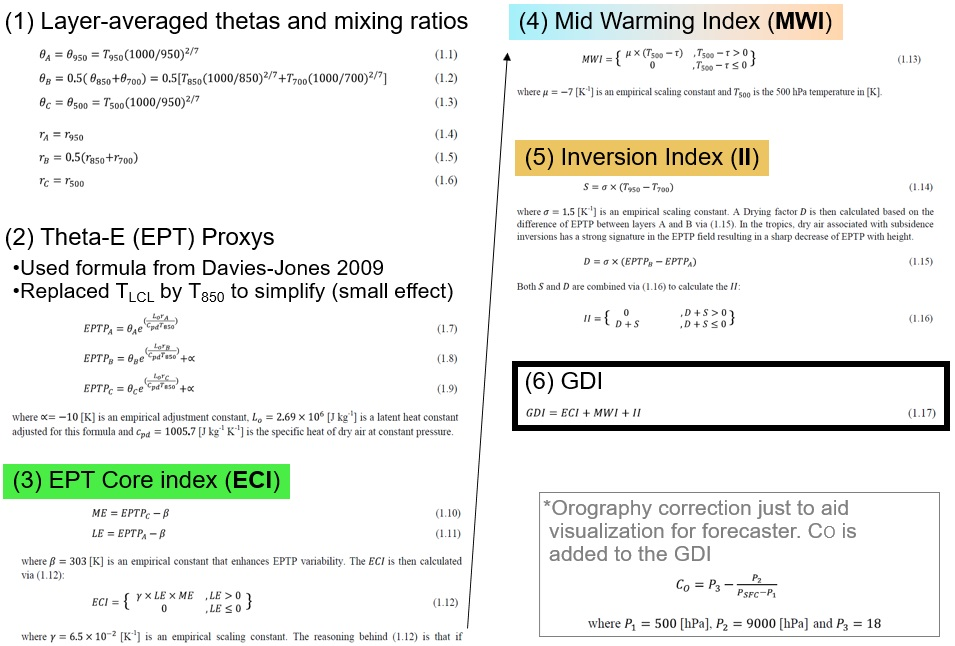
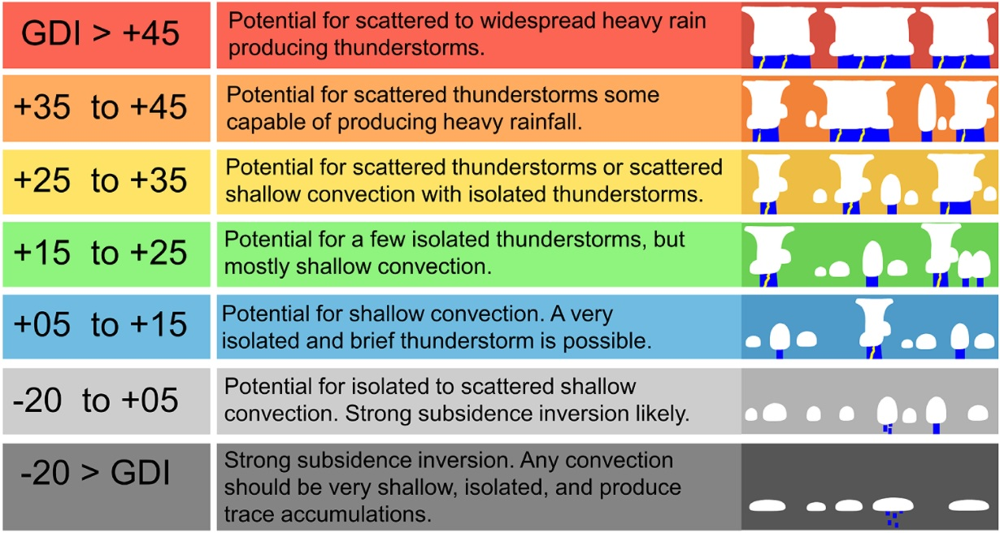

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2021-Jul-23 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga GFS finalizada


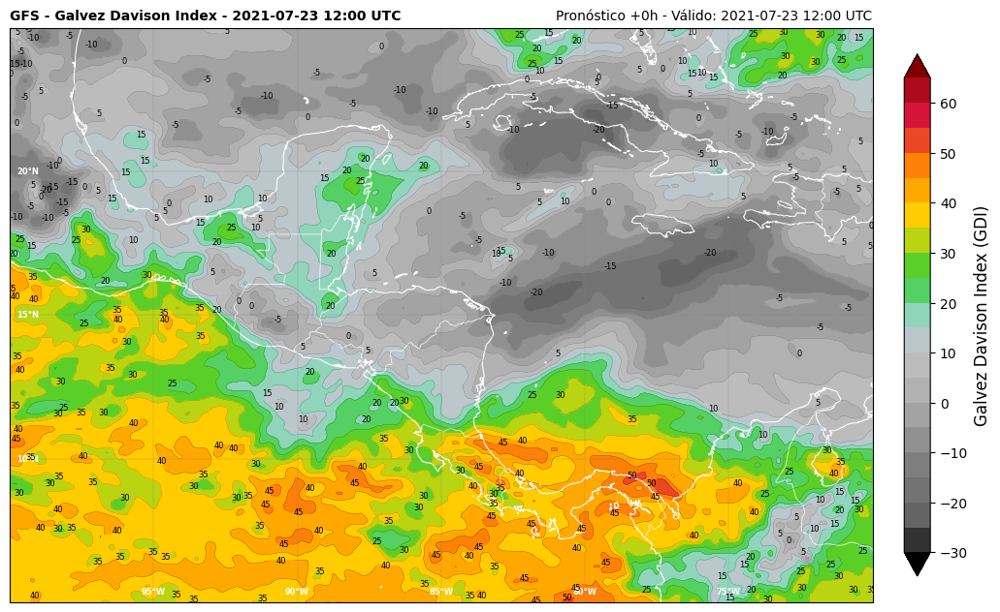

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime       # Manejo básico de fechas y horas

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS GFS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2021-07-23 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Descargamos las temperaturas (TMP) en 950, 850, 700 y 500 hPa
ds_temp = H.xarray("TMP:(950|850|700|500) mb")
ds_temp = ds_temp.assign_coords(longitude=((ds_temp.longitude + 180) % 360) - 180).sortby("longitude")
ds_temp = ds_temp.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

# Descargamos las humedades específicas (SPFH) en los mismos niveles
ds_hum = H.xarray("SPFH:(950|850|700|500) mb")
ds_hum = ds_hum.assign_coords(longitude=((ds_hum.longitude + 180) % 360) - 180).sortby("longitude")
ds_hum = ds_hum.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

# Descargamos la presión (PRES) en superficie
ds_sfc = H.xarray(":PRES:surface")
ds_sfc = ds_sfc.assign_coords(longitude=((ds_sfc.longitude + 180) % 360) - 180).sortby("longitude")
ds_sfc = ds_sfc.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga GFS finalizada")

# ----------------------------------------------------------
# 3. Extrae temperaturas
# ----------------------------------------------------------
t950 = ds_temp.t.sel(isobaricInhPa=950)
t850 = ds_temp.t.sel(isobaricInhPa=850)
t700 = ds_temp.t.sel(isobaricInhPa=700)
t500 = ds_temp.t.sel(isobaricInhPa=500)

# ----------------------------------------------------------
# 4. Extrae humedades específicas
# ----------------------------------------------------------
q_var = ds_hum.q
q950 = q_var.sel(isobaricInhPa=950)
q850 = q_var.sel(isobaricInhPa=850)
q700 = q_var.sel(isobaricInhPa=700)
q500 = q_var.sel(isobaricInhPa=500)

# ----------------------------------------------------------
# 5. Presión
# ----------------------------------------------------------
sfcps = ds_sfc.sp / 100

# Coordenadas
lat = ds_temp.latitude.values
lon = ds_temp.longitude.values
lon2d, lat2d = np.meshgrid(lon, lat)

#========================================================================================================================#
#                                             CALCULO DEL GALVEZ DAVISON INDEX
#========================================================================================================================#
T950 = t950 * (1000 / 950) ** (2 / 7)
T850 = t850 * (1000 / 850) ** (2 / 7)
T700 = t850 * (1000 / 700) ** (2 / 7)
T500 = t500 * (1000 / 500) ** (2 / 7)

THETAA = T950
A1 = T850 + T700
THETAB = 0.5 * A1
THETAC = T500
RA = q950
C2 = q850 + q700
RB = 0.5 * C2
RC = q500

L0 = 2690000
alpha = -10
cpd = 1005.7
p1 = L0 * RA
p2 = L0 * RB
p3 = L0 * RC
p4 = cpd * T850
x1 = p1 / p4
x2 = p2 / p4
x3 = p3 / p4
y1 = np.exp(x1)
y2 = np.exp(x2)
y3 = np.exp(x3)
EPTPA = THETAA * y1
EPTPB = THETAB * y2 + alpha
EPTPC = THETAC * y3 + alpha

beta = 303
ME = EPTPC - beta
LE = EPTPA - beta
gamma = 0.065
ECI = np.where(LE <= 0, 0, gamma * LE * ME)

tau = 263.15
mu = -7
calc1 = t500 - tau
MWI = np.where(calc1 <= 0, 0, calc1 * mu)

sigma = 1.5
op1 = t950 - t700
S = sigma * op1
op2 = EPTPB - EPTPA
D = sigma * op2
calc2 = D + S
II = np.where(calc2 <= 0, D + S, 0)

pp1 = 500
pp2 = 9000
pp3 = 18
divisor = sfcps - pp1
division = pp2 / divisor
C0 = pp3 - division

GDI = ECI + MWI + II
GDIc = GDI + C0

# Suaviza los contornos
import scipy.ndimage
GDIc = scipy.ndimage.zoom(GDIc, 3)
lon2d = scipy.ndimage.zoom(lon2d, 3)
lat2d = scipy.ndimage.zoom(lat2d, 3)

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen (lon mín, lon máx, lat mín, lat máx)
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles
levels = np.arange(-30, 70, 5)

# Colores customizadas
import matplotlib
colors = [
    "#323232", "#646464", "#737373", "#7e7e7e", "#909090",
    "#a3a3a3", "#b1b1b1", "#bcbcbc", "#bbc7cb", "#b2d2dd",
    "#90d5bb", "#55d065", "#5acf28", "#bad411", "#ffcc00",
    "#ffa900", "#fc8106", "#eb4722", "#d8133a", "#ac0a1d"
]
cmap = matplotlib.colors.ListedColormap(colors)
cmap.set_under("#000000")
cmap.set_over("#800000")

# Contornos rellenos (isotacas coloreadas)
contourf = ax.contourf(lon2d, lat2d, GDIc, levels=levels, cmap=cmap, extend="both")

# Contornos líneas blancas finas
contour = ax.contour(lon2d, lat2d, GDIc, levels=levels, colors="black", linewidths=0.1)

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'white', 'size': 6, 'weight': 'bold'}

# Agrega una barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Galvez Davison Index (GDI)', fontsize=12)

# Agrega un título
run_str = np.datetime_as_string(ds_temp.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_temp.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS - Galvez Davison Index - {run_str}', fontweight='bold', fontsize=10, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig(f'/content/output/salida_modelo.png', bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

## **Ejemplo 9: Polígonos en un Mapa Interactivo**

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
import numpy as np                   # Para manejar arrays numéricos
import geopandas as gpd              # Para trabajar con datos geográficos (polígonos)
from shapely.geometry import Polygon # Para crear objetos polígono válidos
from skimage import measure          # Para encontrar contornos automáticos en la matriz
from ipyleaflet import (             # Biblioteca interactiva de mapas en Jupyter
    Map, DrawControl, GeoData, basemaps, WidgetControl, Marker, DivIcon, LayerGroup
)
from IPython.display import display  # Para mostrar el mapa en el notebook
import ipywidgets as widgets         # Para crear botones y controles interactivos

print("=== Preparando mapa interactivo con polígonos automáticos y manuales ===")

# ==========================================================
# PASO 1: Crear polígonos automáticos donde GDIc > 40
# ==========================================================
# Convertimos el array GDIc a formato numérico (por si es xarray)
data = GDIc.values if hasattr(GDIc, "values") else GDIc

# Creamos una máscara booleana: True donde GDIc > 40
mask = data > 40

print(f"Encontramos {np.sum(mask)} celdas con GDI > 40 → buscando contornos...")

# Encontramos los contornos en la máscara (nivel 0.5 es estándar para máscara binaria)
contours = measure.find_contours(mask, level=0.5)

# Coordenadas reales de latitud y longitud (de tu dataset)
lats = lat
lons = lon

# Lista donde guardaremos los polígonos válidos
polygons = []

# Recorremos cada contorno encontrado
for contour in contours:
    row = contour[:, 0]   # índices de fila (latitud)
    col = contour[:, 1]   # índices de columna (longitud)

    # Convertimos índices a coordenadas reales
    lat_coords = np.interp(row, np.arange(len(lats)), lats)
    lon_coords = np.interp(col, np.arange(len(lons)), lons)

    coords = list(zip(lon_coords, lat_coords))

    if len(coords) >= 3:
        coords.append(coords[0])
        poly = Polygon(coords)

        if poly.is_valid and poly.area > 0.01:
            polygons.append(poly)

print(f"Se crearon {len(polygons)} polígonos automáticos válidos (GDI > 40)")

gdf = gpd.GeoDataFrame(geometry=polygons, crs="EPSG:4326")

# ==========================================================
# PASO 2: Crear el mapa base interactivo
# ==========================================================
center = ((min_lat + max_lat) / 2, (min_lon + max_lon) / 2)

print("Creando mapa interactivo grande...")

m = Map(
    center=center,
    zoom=6,
    basemap=basemaps.CartoDB.Positron,
    scroll_wheel_zoom=True
)

m.layout.height = "750px"
m.layout.width = "100%"

# ==========================================================
# PASO 3: Agregar los polígonos automáticos al mapa
# ==========================================================
m.add_layer(
    GeoData(
        geo_dataframe=gdf,
        style={
            "color": "black",
            "weight": 2.5,
            "fillColor": "orange",
            "fillOpacity": 0.6
        },
        name="Zonas GDI > 40 (automáticas)"
    )
)

print("Polígonos automáticos añadidos al mapa")

# ==========================================================
# PASO 3: Marker en Turrialba
# ==========================================================
turrialba_lat = 9.904
turrialba_lon = -83.683

marker_turrialba = Marker(
    location=(turrialba_lat, turrialba_lon),
    draggable=False,
    title="Turrialba"
)

m.add_layer(marker_turrialba)

# ==========================================================
# PASO 4: Herramienta de dibujo manual – solo polígonos, varios colores
# ==========================================================
def crear_control_dibujo(color):
    return DrawControl(
        polygon={
            "shapeOptions": {
                "fill": True,
                "fillColor": color,
                "fillOpacity": 0.1,
                "color": color,
                "opacity": 0.,
                "weight": 2
            }
        },
        polyline={},
        rectangle={},
        circle={},
        circlemarker={},
        marker={},
        edit=False,
        remove=False
    )

colores = {
    "Rojo": "#FF0000",
    "Azul": "#0000FF",
    "Verde": "#00AA00",
    "Amarillo": "#FFD700"
}

controles_dibujo = []
for nombre, color in colores.items():
    dc = crear_control_dibujo(color)
    controles_dibujo.append(dc)
    m.add_control(dc)

# ==========================================================
# PASO 5: Botón para borrar TODOS los polígonos manuales
# ==========================================================
def borrar_todos(boton):
    for dc in controles_dibujo:
        dc.clear()
    print("¡Todos los polígonos manuales borrados!")

boton_borrar = widgets.Button(
    description="🗑️ Borrar todos los polígonos",
    button_style="danger",
    layout=widgets.Layout(width="260px")
)

boton_borrar.on_click(borrar_todos)

control_borrar = WidgetControl(
    widget=boton_borrar,
    position="topright"
)
m.add_control(control_borrar)

# ==========================================================
# PASO 6: Leyenda clara y bonita
# ==========================================================
leyenda_html = """
<div style="
    background-color: rgba(255,255,255,0.9);
    padding: 12px;
    border-radius: 8px;
    font-size: 16px;
    box-shadow: 0 0 8px rgba(0,0,0,0.3);
">
<b style="font-size:18px;">Leyenda</b><br><br>

<span style="background:orange; width:18px; height:18px; display:inline-block;"></span>
&nbsp; Zonas automáticas GDI &gt; 40<br><br>

<span style="background:#FF0000; width:18px; height:18px; display:inline-block;"></span>
&nbsp; Polígono manual – Rojo<br>

<span style="background:#0000FF; width:18px; height:18px; display:inline-block;"></span>
&nbsp; Polígono manual – Azul<br>

<span style="background:#00AA00; width:18px; height:18px; display:inline-block;"></span>
&nbsp; Polígono manual – Verde<br>

<span style="background:#FFD700; width:18px; height:18px; display:inline-block;"></span>
&nbsp; Polígono manual – Amarillo
</div>
"""

leyenda = WidgetControl(
    widget=widgets.HTML(leyenda_html),
    position="bottomright"
)
m.add_control(leyenda)

# ==========================================================
# PASO FINAL
# ==========================================================
print("Ajustando vista al área de interés...")
m.fit_bounds([[min_lat, min_lon], [max_lat, max_lon]])

print("¡Mapa listo! Puedes dibujar polígonos manuales en diferentes colores.")
print("Usa el botón rojo para borrar todos los dibujos manuales cuando quieras.\n")

display(m)

=== Preparando mapa interactivo con polígonos automáticos y manuales ===
Encontramos 893 celdas con GDI > 40 → buscando contornos...
Se crearon 49 polígonos automáticos válidos (GDI > 40)
Creando mapa interactivo grande...
Polígonos automáticos añadidos al mapa
Ajustando vista al área de interés...
¡Mapa listo! Puedes dibujar polígonos manuales en diferentes colores.
Usa el botón rojo para borrar todos los dibujos manuales cuando quieras.



Map(center=[15.0, -85.0], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_ou…

## **Ejemplo 10: Cálculos con MetPy - Vorticidad**

## 10.1 Vorticidad

Successfully downloaded ./samples/OR_ABI-L2-CMIPF-M6C13_G16_s20212031500232_e20212031509551_c20212031510048.nc
Successfully downloaded ./samples/OR_ABI-L2-CMIPF-M6C02_G16_s20212031500232_e20212031509540_c20212031510014.nc
Successfully downloaded ./samples/OR_ABI-L2-CMIPF-M6C05_G16_s20212031500232_e20212031509540_c20212031510007.nc
Descargando GLM desde 2021-07-22 15:00:00 hasta 2021-07-22 15:10:00
Successfully downloaded ./samples/OR_GLM-L2-LCFA_G16_s20212031500000_e20212031500200_c20212031500214.nc
Successfully downloaded ./samples/OR_GLM-L2-LCFA_G16_s20212031500200_e20212031500400_c20212031500414.nc
Successfully downloaded ./samples/OR_GLM-L2-LCFA_G16_s20212031500400_e20212031501000_c20212031501016.nc
Successfully downloaded ./samples/OR_GLM-L2-LCFA_G16_s20212031501000_e20212031501200_c20212031501215.nc
Successfully downloaded ./samples/OR_GLM-L2-LCFA_G16_s20212031501200_e20212031501400_c20212031501417.nc
Successfully downloaded ./samples/OR_GLM-L2-LCFA_G16_s20212031501400_e202120315

/usr/local/lib/python3.12/dist-packages/herbie/core.py:978: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  logic = df.search_this.str.contains(search)
/usr/local/lib/python3.12/dist-packages/cfgrib/xarray_store.py:51: FutureWarning: In a future version of xarray the default value for compat will change from compat='no_conflicts' to compat='override'. This is likely to lead to different results when combining overlapping variables with the same name. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set compat explicitly.
  o = xr.merge([o, ds], **kwargs)
/usr/local/lib/python3.12/dist-packages/osgeo/gdal.py:312: FutureWarning: Neither gdal.UseExceptions() nor gdal.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(


Remapping...
Remap finished! Time: 0.27 seconds
Remapping...
Remap finished! Time: 0.5 seconds
Remapping...
Remap finished! Time: 0.26 seconds
Total GLM acumulado → Eventos: 89,576 | Grupos: 35,130 | Flashes: 2,163


/tmp/ipython-input-3439580346.py:151: UserWarning: More than one time coordinate present for variable  "u".
  vorticity = mpcalc.vorticity(u, v, dx=dx, dy=dy)
/usr/local/lib/python3.12/dist-packages/cartopy/io/__init__.py:242: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/10m_cultural/ne_10m_admin_0_boundary_lines_land.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


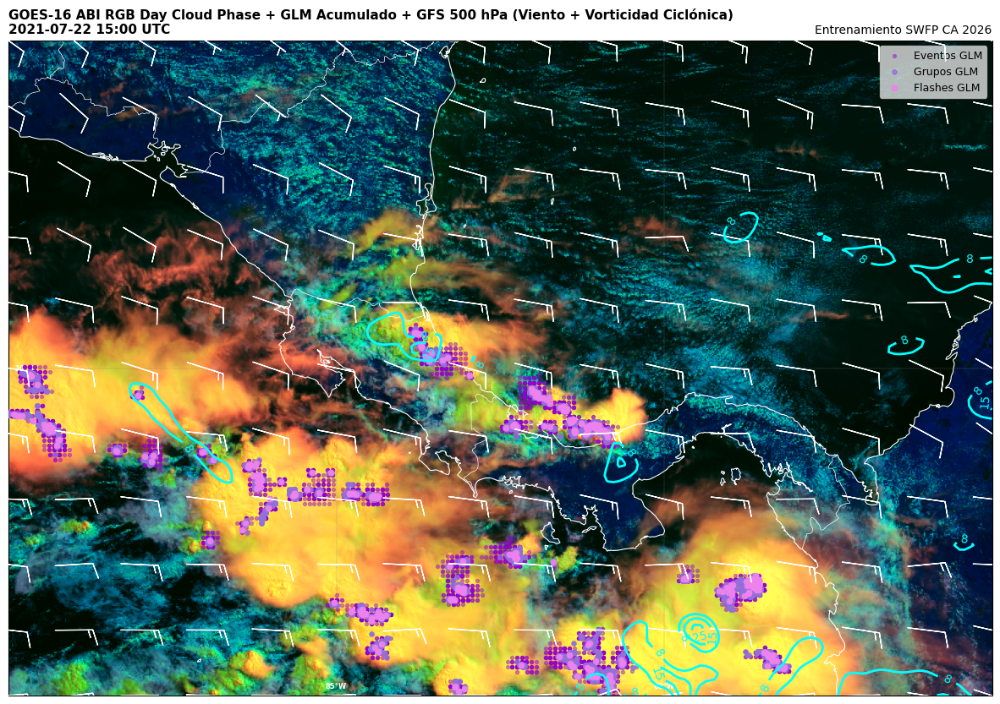

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Para leer y manejar archivos NetCDF (formato típico de datos satelitales)
import matplotlib.pyplot as plt             # Biblioteca principal para crear gráficos y visualizaciones
import cartopy.crs as ccrs                  # Proporciona sistemas de coordenadas y proyecciones geográficas
import cartopy.feature as cfeature          # Conjunto de características geográficas predefinidas (costas, países, etc)
import numpy as np                          # Para manejar arreglos numéricos de forma eficiente
from datetime import datetime, timedelta    # Para trabajar con fechas y horas (datetime) y diferencias de tiempo (timedelta)
from utilities import download_GOES, remap  # Funciones personalizadas: descarga de datos GOES + reproyección (no incluidas aquí)
from herbie import Herbie                   # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import metpy.calc as mpcalc                 # Cálculos meteorológicos precisos (vorticidad, etc)
from metpy.units import units               # Manejo de unidades físicas (requerido por MetPy)

#========================================================================================================================#
#                                                REGIÓN DE INTERÉS
#========================================================================================================================#
# Coordenadas de la región que queremos visualizar (en grados)
min_lon = -90      # Longitud mínima (oeste)
max_lon = -75      # Longitud máxima (este)
min_lat = 5        # Latitud mínima (sur)
max_lat = 15       # Latitud máxima (norte)

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R (ABI + GLM) + GFS
#========================================================================================================================#
# ── ABI ───────────────────────────────────────────────────────────────
# Descarga bandas necesarias para RGB Day Cloud Phase Distinction
file_13 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 13, './samples')   # Band 13 - Clean IR (~10.3 µm)
file_02 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 2,  './samples')   # Band 2  - Visible rojo (0.64 µm)
file_05 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 5,  './samples')   # Band 5  - Near-IR nieve/hielo (1.6 µm)

# ── GLM ───────────────────────────────────────────────────────────────
# Definimos el intervalo de tiempo para acumular rayos (GLM)
start_time = datetime(2021, 7, 22, 15, 0, 0)    # Ajusta para coincidir o estar cerca de la hora ABI
end_time   = datetime(2021, 7, 22, 15, 10, 0)   # Ejemplo: 10 minutos de acumulación

print(f"Descargando GLM desde {start_time} hasta {end_time}")

file_list = []                  # Lista donde guardaremos las rutas de los archivos GLM
current_time = start_time       # Variable auxiliar para recorrer el tiempo

# Bucle que avanza de 20 en 20 segundos (cadencia típica de archivos GLM-LCFA)
while current_time < end_time:
    time_str = current_time.strftime('%Y-%m-%d %H:%M:%S')
    file = download_GOES(time_str, 'G16', 'GLM-L2-LCFA', None, './samples')

    if file is not None:
        file_list.append(file)

    current_time += timedelta(seconds=20)

print(f"Se descargaron {len(file_list)} archivos GLM")

# ── GFS Viento 500 hPa ───────────────────────────────────────────────────────────────
# Crea el objeto Herbie para acceder a los datos del GFS (ajusta la fecha/hora según disponibilidad)
H = Herbie("2021-07-22 12:00", model="gfs", product="pgrb2.0p25", fxx=0)  # Análisis de las 12 UTC

# Carga viento a 500 hPa y selecciona región
ds_viento = H.xarray(":(U|V)GRD:500 mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS ABI (RGB)
#========================================================================================================================#
# Reproyectamos y leemos las bandas ABI en la región deseada
data_13 = remap(file_13, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15   # Temperatura en °C
data_02 = remap(file_02, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()            # Reflectancia
data_05 = remap(file_05, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()            # Reflectancia

# ── Receta RGB: Day Cloud Phase Distinction ───────────────────────────────────────────────
# Componentes RGB (según guía estándar CIRA/NOAA)
R = data_13
G = data_02
B = data_05

# Límites recomendados para este RGB
Rmin, Rmax = -53.5, 7.5
Gmin, Gmax = 0.0, 0.78
Bmin, Bmax = 0.01, 0.59

# Recortamos valores fuera de rango
R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

# Normalización (gamma = 1 → lineal)
R = (R - Rmax) / (Rmin - Rmax)
G = (G - Gmin) / (Gmax - Gmin)
B = (B - Bmin) / (Bmax - Bmin)

# Creamos la imagen RGB (altura × ancho × 3)
RGB = np.stack([R, G, B], axis=2)

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS GLM
#========================================================================================================================#
# Listas para acumular TODAS las coordenadas de rayos
all_e_lons, all_e_lats = [], []
all_g_lons, all_g_lats = [], []
all_f_lons, all_f_lats = [], []

for file_glm in file_list:
    try:
        glm_ds = xr.open_dataset(file_glm)

        # Acumular coordenadas
        all_e_lons.extend(glm_ds['event_lon'].values)
        all_e_lats.extend(glm_ds['event_lat'].values)
        all_g_lons.extend(glm_ds['group_lon'].values)
        all_g_lats.extend(glm_ds['group_lat'].values)
        all_f_lons.extend(glm_ds['flash_lon'].values)
        all_f_lats.extend(glm_ds['flash_lat'].values)

        glm_ds.close()
    except:
        pass  # Si falla un archivo → lo ignoramos

# Convertimos a arrays NumPy
e_lons = np.array(all_e_lons)
e_lats = np.array(all_e_lats)
g_lons = np.array(all_g_lons)
g_lats = np.array(all_g_lats)
f_lons = np.array(all_f_lons)
f_lats = np.array(all_f_lats)

print(f"Total GLM acumulado → Eventos: {len(e_lons):,} | Grupos: {len(g_lons):,} | Flashes: {len(f_lons):,}")

#========================================================================================================================#
#                                       PROCESAMIENTO DE DATOS VIENTO Y VORTICIDAD (GFS 500 hPa)
#========================================================================================================================#
# Extrae las componentes u y v
u = ds_viento['u']  # componente u del viento (zonal) [m/s]
v = ds_viento['v']  # componente v del viento (meridional) [m/s]

# Calcula velocidad del viento en kt
wind_speed_ms = np.sqrt(u**2 + v**2)
wind_speed_kt = wind_speed_ms * 1.94384

# ── Cálculo de vorticidad relativa con MetPy (versión simplificada y actual) ───────────────────────────────
ds_viento = ds_viento.metpy.parse_cf()  # Activa metadatos CF y unidades automáticamente

# Calcula deltas reales en metros (MetPy infiere la proyección del GFS)
dx, dy = mpcalc.lat_lon_grid_deltas(
    ds_viento.longitude,
    ds_viento.latitude
)

# Vorticidad relativa (en s⁻¹)
vorticity = mpcalc.vorticity(u, v, dx=dx, dy=dy)

# Escala a unidades comunes en meteorología: ×10⁵ s⁻¹
vorticity_scaled = vorticity * 1e5

# Coordenadas para contornos
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values
Lon, Lat = np.meshgrid(lon, lat)

# Umbral para mostrar solo vorticidad ciclónica positiva significativa
vort_threshold = 8   # en 10⁻⁵ s⁻¹ (ajusta: 5-12 típico para 500 hPa)

#========================================================================================================================#
#                                        GRAFICA LA IMAGEN (ABI RGB + GLM + BARBAS + VORTICIDAD)
#========================================================================================================================#
plt.figure(figsize=(15,15))                     # Creamos figura grande

# Eje con proyección PlateCarree
ax = plt.axes(projection=ccrs.PlateCarree())

# Establecemos los límites geográficos
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo negro (por si hay áreas sin datos RGB)
ax.set_facecolor('black')

# Graficamos la imagen RGB de ABI (base)
img = ax.imshow(RGB, origin='upper', extent=[min_lon, max_lon, min_lat, max_lat],
                transform=ccrs.PlateCarree(), zorder=1)

# ── Superponemos GLM ────────────────────────────────────────────────────────────────
# Eventos (muchos → pequeño y más transparente)
ax.scatter(e_lons, e_lats, c='darkviolet', s=8, alpha=0.4, marker='o', transform=ccrs.PlateCarree(), label='Eventos GLM', zorder=5)

# Grupos (intermedio)
ax.scatter(g_lons, g_lats, c='mediumpurple', s=15, alpha=0.8, marker='o', transform=ccrs.PlateCarree(), label='Grupos GLM', zorder=10)

# Flashes (destacados - tamaño grande y brillante)
ax.scatter(f_lons, f_lats, c='violet', s=25, alpha=0.95, marker='o', linewidth=0.5, transform=ccrs.PlateCarree(), label='Flashes GLM', zorder=15)

# ── Superponemos barbas de viento (GFS 500 hPa) ─────────────────────────────────────
skip = 4   # Saltamos puntos para no saturar (ajusta según densidad deseada)
ax.barbs(Lon[::skip, ::skip], Lat[::skip, ::skip],
         u[::skip, ::skip], v[::skip, ::skip],
         length=8, pivot="middle",
         barbcolor="white", flagcolor="white", linewidth=0.9,
         sizes=dict(emptybarb=0.0),
         transform=ccrs.PlateCarree(), zorder=20)   # zorder alto para que queden encima

# ── Superponemos contornos de vorticidad ciclónica positiva ─────────────────────────────

# Suaviza los contornos
import scipy.ndimage
vorticity_scaled = scipy.ndimage.zoom(vorticity_scaled, 3)
Lon = scipy.ndimage.zoom(Lon, 3)
Lat = scipy.ndimage.zoom(Lat, 3)

contour_vort = ax.contour(Lon, Lat, vorticity_scaled,
                         levels=[vort_threshold, 15, 25, 35, 50],
                         colors='cyan', linewidths=2.0, linestyles='solid',
                         transform=ccrs.PlateCarree(), zorder=25)

# Opcional: etiquetas en los contornos (descomentar si no satura)
ax.clabel(contour_vort, inline=True, inline_spacing=8, fontsize=10, fmt='%d', colors='cyan')

# Leyenda (GLM)
ax.legend(loc='upper right', fontsize=9, framealpha=0.7)

# Elementos geográficos
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)

# Grilla con etiquetas
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180,180,5), ylocs=np.arange(-90,90,5), draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color':'white', 'size':6, 'weight':'bold'}
gl.xlabel_style = {'color':'white', 'size':6, 'weight':'bold'}

# Fecha (usamos la del archivo ABI principal)
try:
    ds = xr.open_dataset(file_13)
    date = datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ').strftime('%Y-%m-%d %H:%M UTC')
    ds.close()
except:
    date = "Fecha ABI no disponible"

# Títulos
plt.title(f'GOES-16 ABI RGB Day Cloud Phase + GLM Acumulado + GFS 500 hPa (Viento + Vorticidad Ciclónica)\n{date}',
          fontweight='bold', fontsize=11, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

# Guardamos la imagen combinada
plt.savefig(f'/content/output/imagen_ABI_RGB_GLM_BARBS_VORT_{start_time.strftime("%H%M")}_{end_time.strftime("%H%M")}.png',
            bbox_inches='tight', dpi=150)

# Mostramos
plt.show()

### 10.2 Vorticidad - Promedio

File ./samples/OR_ABI-L2-CMIPF-M6C13_G16_s20212031500232_e20212031509551_c20212031510048.nc already exists
File ./samples/OR_ABI-L2-CMIPF-M6C02_G16_s20212031500232_e20212031509540_c20212031510014.nc already exists
File ./samples/OR_ABI-L2-CMIPF-M6C05_G16_s20212031500232_e20212031509540_c20212031510007.nc already exists
Descargando GLM desde 2021-07-22 15:00:00 hasta 2021-07-22 15:10:00
File ./samples/OR_GLM-L2-LCFA_G16_s20212031500000_e20212031500200_c20212031500214.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031500200_e20212031500400_c20212031500414.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031500400_e20212031501000_c20212031501016.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031501000_e20212031501200_c20212031501215.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031501200_e20212031501400_c20212031501417.nc already exists
File ./samples/OR_GLM-L2-LCFA_G16_s20212031501400_e20212031502000_c20212031502019.nc already exists
File ./samp

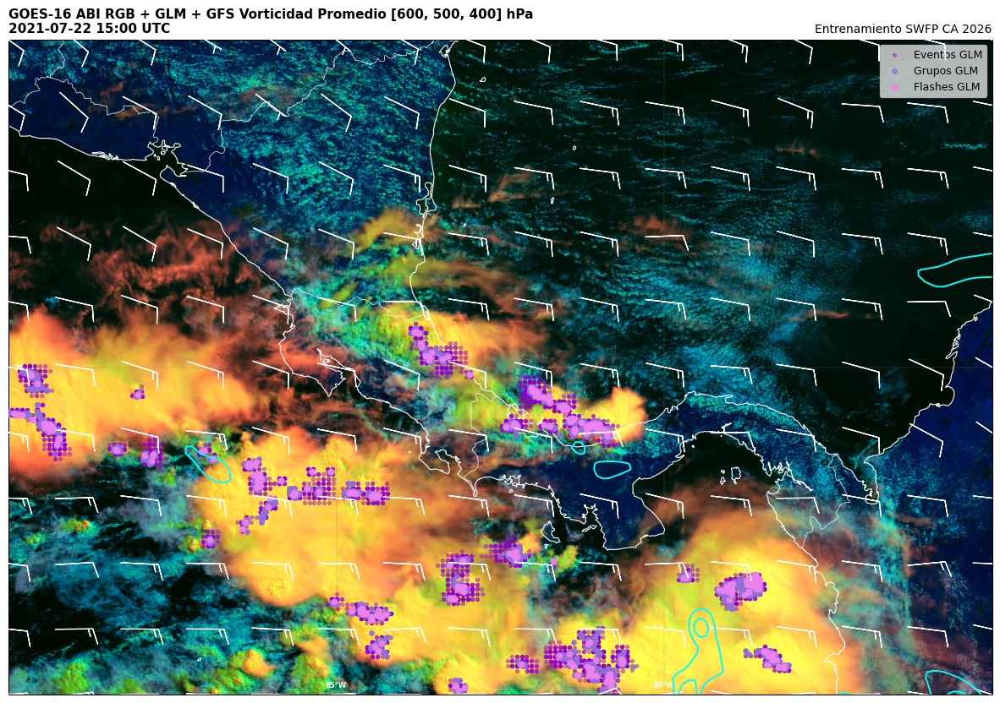

In [ ]:
#========================================================================================================================#
# LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                         # Para leer y manejar archivos NetCDF (formato típico de datos satelitales)
import matplotlib.pyplot as plt             # Biblioteca principal para crear gráficos y visualizaciones
import cartopy.crs as ccrs                  # Proporciona sistemas de coordenadas y proyecciones geográficas
import cartopy.feature as cfeature          # Conjunto de características geográficas predefinidas (costas, países, etc)
import numpy as np                          # Para manejar arreglos numéricos de forma eficiente
from datetime import datetime, timedelta    # Para trabajar con fechas y horas (datetime) y diferencias de tiempo (timedelta)
from utilities import download_GOES, remap  # Funciones personalizadas: descarga de datos GOES + reproyección (no incluidas aquí)
from herbie import Herbie                   # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import metpy.calc as mpcalc                 # Cálculos meteorológicos precisos (vorticidad, etc)
from metpy.units import units               # Manejo de unidades físicas (requerido por MetPy)

#========================================================================================================================#
#                                                REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -90
max_lon = -75
min_lat = 5
max_lat = 15

#========================================================================================================================#
#                                       DESCARGA DE DATOS GOES-R (ABI + GLM) + GFS
#========================================================================================================================#
# ── ABI ───────────────────────────────────────────────────────────────
file_13 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 13, './samples')
file_02 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 2,  './samples')
file_05 = download_GOES('2021-07-22 15:00', 'G16', 'ABI-L2-CMIPF', 5,  './samples')

# ── GLM ───────────────────────────────────────────────────────────────
start_time = datetime(2021, 7, 22, 15, 0, 0)
end_time   = datetime(2021, 7, 22, 15, 10, 0)

print(f"Descargando GLM desde {start_time} hasta {end_time}")

file_list = []
current_time = start_time

while current_time < end_time:
    time_str = current_time.strftime('%Y-%m-%d %H:%M:%S')
    file = download_GOES(time_str, 'G16', 'GLM-L2-LCFA', None, './samples')
    if file is not None:
        file_list.append(file)
    current_time += timedelta(seconds=20)

print(f"Se descargaron {len(file_list)} archivos GLM")

# ── GFS Viento en varios niveles (para promediar vorticidad) ────────────────────────────────
# Fecha/hora del GFS
H = Herbie("2021-07-22 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Lista de niveles de presión que queremos promediar (en hPa)
niveles = [600, 500, 400]  # ¡Aquí puedes cambiar o agregar niveles!

ds_vientos = {}  # Diccionario para guardar datasets por nivel

for nivel in niveles:
    print(f"Descargando/cargando vientos a {nivel} hPa...")
    ds = H.xarray(f":(U|V)GRD:{nivel} mb")
    ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
    ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))
    ds_vientos[nivel] = ds

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS ABI (RGB)
#========================================================================================================================#
data_13 = remap(file_13, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray() - 273.15
data_02 = remap(file_02, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()
data_05 = remap(file_05, 'CMI', [min_lon, min_lat, max_lon, max_lat], 2).ReadAsArray()

R = data_13
G = data_02
B = data_05

Rmin, Rmax = -53.5, 7.5
Gmin, Gmax = 0.0, 0.78
Bmin, Bmax = 0.01, 0.59

R = np.clip(R, Rmin, Rmax)
G = np.clip(G, Gmin, Gmax)
B = np.clip(B, Bmin, Bmax)

R = (R - Rmax) / (Rmin - Rmax)
G = (G - Gmin) / (Gmax - Gmin)
B = (B - Bmin) / (Bmax - Bmin)

RGB = np.stack([R, G, B], axis=2)

#========================================================================================================================#
#                                          PROCESAMIENTO DE DATOS GLM
#========================================================================================================================#
all_e_lons, all_e_lats = [], []
all_g_lons, all_g_lats = [], []
all_f_lons, all_f_lats = [], []

for file_glm in file_list:
    try:
        glm_ds = xr.open_dataset(file_glm)
        all_e_lons.extend(glm_ds['event_lon'].values)
        all_e_lats.extend(glm_ds['event_lat'].values)
        all_g_lons.extend(glm_ds['group_lon'].values)
        all_g_lats.extend(glm_ds['group_lat'].values)
        all_f_lons.extend(glm_ds['flash_lon'].values)
        all_f_lats.extend(glm_ds['flash_lat'].values)
        glm_ds.close()
    except:
        pass

e_lons = np.array(all_e_lons)
e_lats = np.array(all_e_lats)
g_lons = np.array(all_g_lons)
g_lats = np.array(all_g_lats)
f_lons = np.array(all_f_lons)
f_lats = np.array(all_f_lats)

print(f"Total GLM acumulado → Eventos: {len(e_lons):,} | Grupos: {len(g_lons):,} | Flashes: {len(f_lons):,}")

#========================================================================================================================#
#                                       PROCESAMIENTO DE VIENTO Y VORTICIDAD PROMEDIADA
#========================================================================================================================#
vorticidades = []

for nivel, ds in ds_vientos.items():
    print(f"Calculando vorticidad a {nivel} hPa...")

    u = ds['u']
    v = ds['v']

    # Prepara MetPy
    ds = ds.metpy.parse_cf()

    # Deltas en metros
    dx, dy = mpcalc.lat_lon_grid_deltas(ds.longitude, ds.latitude)

    # Vorticidad relativa
    vort = mpcalc.vorticity(u, v, dx=dx, dy=dy) * 1e5  # en 10⁻⁵ s⁻¹

    vorticidades.append(vort)

# Promedio de vorticidad en los niveles seleccionados
vorticity_mean = sum(vorticidades) / len(vorticidades)

# Coordenadas (usamos las del primer nivel, todas tienen la misma grilla)
lon = ds_vientos[niveles[0]].longitude.values
lat = ds_vientos[niveles[0]].latitude.values
Lon, Lat = np.meshgrid(lon, lat)

# Umbral para contornos de vorticidad ciclónica promedio
vort_threshold = 8   # ajusta según necesites

# ... (continúa con la gráfica igual que antes)

#========================================================================================================================#
#                                        GRAFICA LA IMAGEN
#========================================================================================================================#
plt.figure(figsize=(15,15))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())
ax.set_facecolor('black')

img = ax.imshow(RGB, origin='upper', extent=[min_lon, max_lon, min_lat, max_lat],
                transform=ccrs.PlateCarree(), zorder=1)

# GLM
ax.scatter(e_lons, e_lats, c='darkviolet', s=8, alpha=0.4, marker='o',
           transform=ccrs.PlateCarree(), label='Eventos GLM', zorder=5)
ax.scatter(g_lons, g_lats, c='mediumpurple', s=15, alpha=0.8, marker='o',
           transform=ccrs.PlateCarree(), label='Grupos GLM', zorder=10)
ax.scatter(f_lons, f_lats, c='violet', s=25, alpha=0.95, marker='o', linewidth=0.5,
           transform=ccrs.PlateCarree(), label='Flashes GLM', zorder=15)

# Barbas (usamos el nivel medio como referencia, por ej. 500 hPa)
ds_ref = ds_vientos[500]
u_ref = ds_ref['u']
v_ref = ds_ref['v']
skip = 4
ax.barbs(Lon[::skip, ::skip], Lat[::skip, ::skip],
         u_ref[::skip, ::skip], v_ref[::skip, ::skip],
         length=8, pivot="middle",
         barbcolor="white", flagcolor="white", linewidth=0.9,
         sizes=dict(emptybarb=0.0),
         transform=ccrs.PlateCarree(), zorder=20)

# Suavizando los contornos
import scipy.ndimage
vorticity_mean = scipy.ndimage.zoom(vorticity_mean, 3)
Lon = scipy.ndimage.zoom(Lon, 3)
Lat = scipy.ndimage.zoom(Lat, 3)

# Contornos de vorticidad PROMEDIADA
contour_vort = ax.contour(Lon, Lat, vorticity_mean,
                         levels=[vort_threshold, 15, 25, 35, 50],
                         colors='cyan', linewidths=1.4, linestyles='solid',
                         transform=ccrs.PlateCarree(), zorder=25)

# Leyenda, costas, grilla, títulos, guardar y mostrar (igual que antes)
ax.legend(loc='upper right', fontsize=9, framealpha=0.7)
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)

gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180,180,5), ylocs=np.arange(-90,90,5), draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color':'white', 'size':6, 'weight':'bold'}
gl.xlabel_style = {'color':'white', 'size':6, 'weight':'bold'}

try:
    ds = xr.open_dataset(file_13)
    date = datetime.strptime(ds.time_coverage_start, '%Y-%m-%dT%H:%M:%S.%fZ').strftime('%Y-%m-%d %H:%M UTC')
    ds.close()
except:
    date = "Fecha ABI no disponible"

plt.title(f'GOES-16 ABI RGB + GLM + GFS Vorticidad Promedio {niveles} hPa\n{date}',
          fontweight='bold', fontsize=11, loc='left')
plt.title(f'Entrenamiento SWFP CA 2026', fontsize=10, loc='right')

plt.savefig(f'/content/output/imagen_ABI_RGB_GLM_VORT_PROM_{start_time.strftime("%H%M")}_{end_time.strftime("%H%M")}.png',
            bbox_inches='tight', dpi=150)

plt.show()

## **Ejemplo 11: Cálculos con MetPy - Convergencia / Divergencia**

Descargando viento a 925 hPa...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Calculando divergencia y convergencia en 925 hPa...
Cálculo completado


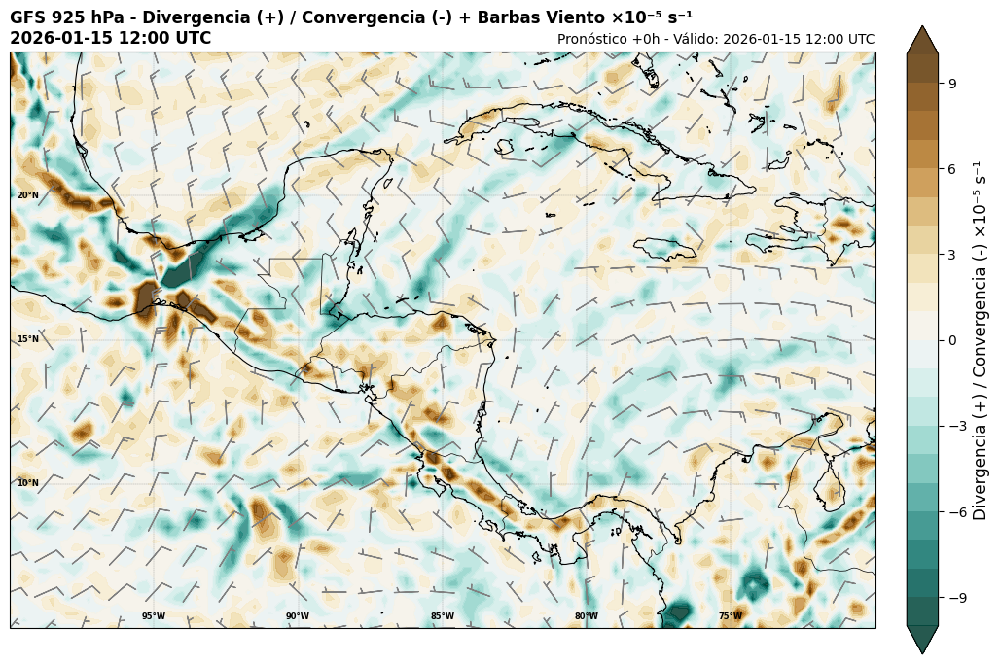

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
import metpy.calc as mpcalc         # Cálculos meteorológicos (vorticidad, gradientes, viento, etc.)
from metpy.units import units       # Manejo de unidades físicas con soporte de MetPy (Pa, K, m/s, etc.)

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
print("Descargando viento a 925 hPa...")
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento a 925 hPa, convierte las longitudes para -180 ~ 180 y selecciona la región
ds_viento = H.xarray(":(U|V)GRD:925 mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Extrae las componentes u y v (solo 925 hPa)
u = ds_viento['u'].metpy.unit_array   # componente zonal (m/s)
v = ds_viento['v'].metpy.unit_array   # componente meridional (m/s)

# Leemos las coordenadas (vectores 1D)
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values

# Creamos las grillas 2D necesarias para contourf y barbs
lon2d, lat2d = np.meshgrid(lon, lat)

# Calculamos las distancias entre puntos de la grilla (dx, dy en metros)
lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

# Cálculo de divergencia y convergencia (solo nivel 925 hPa)
print("Calculando divergencia y convergencia en 925 hPa...")
divergencia = mpcalc.divergence(u, v, dx=dx, dy=dy)

# CORRECCIÓN DEL SIGNO: negativo = convergencia (para que marrón = convergencia en BrBG_r)
convergencia = divergencia * 1e5   # ×10⁻⁵ s⁻¹   (positivo = divergencia, negativo = convergencia)

# Valores numéricos para el gráfico
conv_values = convergencia.magnitude

print("Cálculo completado")

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo: Convergencia / Divergencia (marrón = convergencia)
contourf = ax.contourf(lon2d, lat2d, conv_values,
                       levels=np.linspace(-10, 10, 21),
                       cmap='BrBG_r', extend='both',
                       transform=ccrs.PlateCarree(),
                       alpha=0.85)

# Superposición de barbas de viento a 925 hPa
skip = 5  # Ajusta según necesites (4 = más denso, 6-7 = más limpio)

ax.barbs(lon2d[::skip, ::skip], lat2d[::skip, ::skip],
         u[::skip, ::skip].m, v[::skip, ::skip].m,
         length=6, pivot="middle", barbcolor="gray", flagcolor="gray",
         linewidth=0.9, sizes=dict(emptybarb=0.0),
         flip_barb=(lat2d[::skip, ::skip] < 0),
         transform=ccrs.PlateCarree())

# Barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label('Divergencia (+) / Convergencia (-) ×10⁻⁵ s⁻¹', fontsize=12)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5),
                  draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega un título claro con la convención de signos
run_str = np.datetime_as_string(ds_viento.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_viento.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS 925 hPa - Divergencia (+) / Convergencia (-) + Barbas Viento ×10⁻⁵ s⁻¹\n{run_str}',
          fontweight='bold', fontsize=12, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig('/content/output/GFS_925hPa_DIVERGENCIA_CONVERGENCIA_BARBS.png',
            bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

## **Ejemplo 12: Cálculos con MetPy - Vorticidad Relativa**

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2021-Jul-23 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


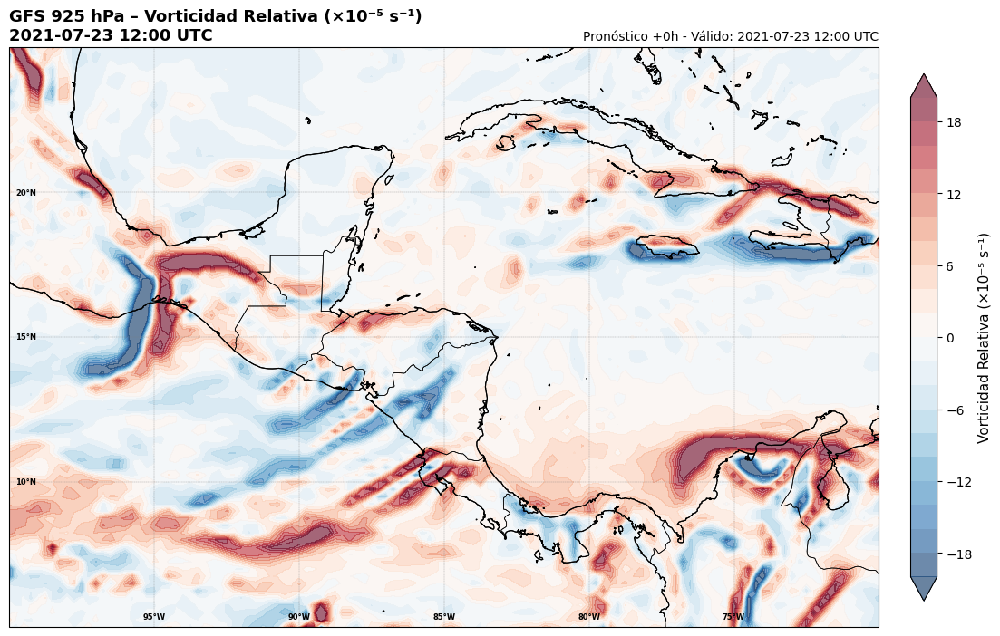

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Manejo de datos multidimensionales (NetCDF, GRIB)
import matplotlib.pyplot as plt     # Creación de gráficos y mapas
import cartopy.crs as ccrs          # Proyecciones cartográficas
import cartopy.feature as cfeature  # Costas, fronteras y elementos geográficos
import numpy as np                  # Operaciones numéricas
import metpy.calc as mpcalc         # Cálculos meteorológicos (vorticidad, gradientes, etc)
from metpy.units import units       # Manejo de unidades físicas con MetPy

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión espacial del mapa (lon min, lon max, lat min, lat max)
min_lon = -100 ; max_lon = -70
min_lat = 5    ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del modelo GFS
H = Herbie("2021-07-23 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Descarga únicamente las componentes del viento (u, v) a 925 hPa
ds = H.xarray(":(U|V)GRD:925 mb")

# Convierte longitudes de 0–360 a -180–180 y ordena correctamente
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")

# Selecciona la región de interés
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#

# Extrae las componentes del viento con unidades físicas
u = ds['u'].metpy.unit_array   # Componente zonal del viento (m/s)
v = ds['v'].metpy.unit_array   # Componente meridional del viento (m/s)

# Lee las coordenadas
lon = ds.longitude.values
lat = ds.latitude.values

# Convierte coordenadas a objetos con unidades para MetPy
lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees

# Calcula distancias horizontales entre puntos de grilla (en metros)
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

# Calcula la vorticidad relativa y la escala a ×10⁻⁵ s⁻¹
vorticidad_rel = mpcalc.vorticity(u, v, dx=dx, dy=dy) * 1e5

# Extrae valores numéricos para graficar
vort_values = vorticidad_rel.magnitude

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#

# Define el tamaño de la figura
fig = plt.figure(figsize=(12, 10))

# Usa proyección PlateCarree (lat/lon)
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión del mapa
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Agrega costas y fronteras
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5),
                  draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Contornos rellenos de vorticidad
levels = np.linspace(-20, 20, 21)
cf = ax.contourf(lon, lat, vort_values, levels=levels, cmap='RdBu_r', extend='both', transform=ccrs.PlateCarree(), alpha=0.6)

# Barra de colores
cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label('Vorticidad Relativa (×10⁻⁵ s⁻¹)', fontsize=11)

# Tiempo de corrida y validez
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

# Títulos del mapa
plt.title(f'GFS 925 hPa – Vorticidad Relativa (×10⁻⁵ s⁻¹)\n{run_str}', fontweight='bold', fontsize=13, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Ajusta el layout, guarda y muestra la figura
plt.tight_layout()
plt.savefig('/content/output/GFS_925hPa_VORTICIDAD.png', bbox_inches='tight', dpi=150)
plt.show()


## **Ejemplo 13: Cálculos con MetPy - Divergencia Media en Altura**

Descargando viento en capas altas (200 y 250 hPa)...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2021-Jul-23 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Cálculo de divergencia en altura completado


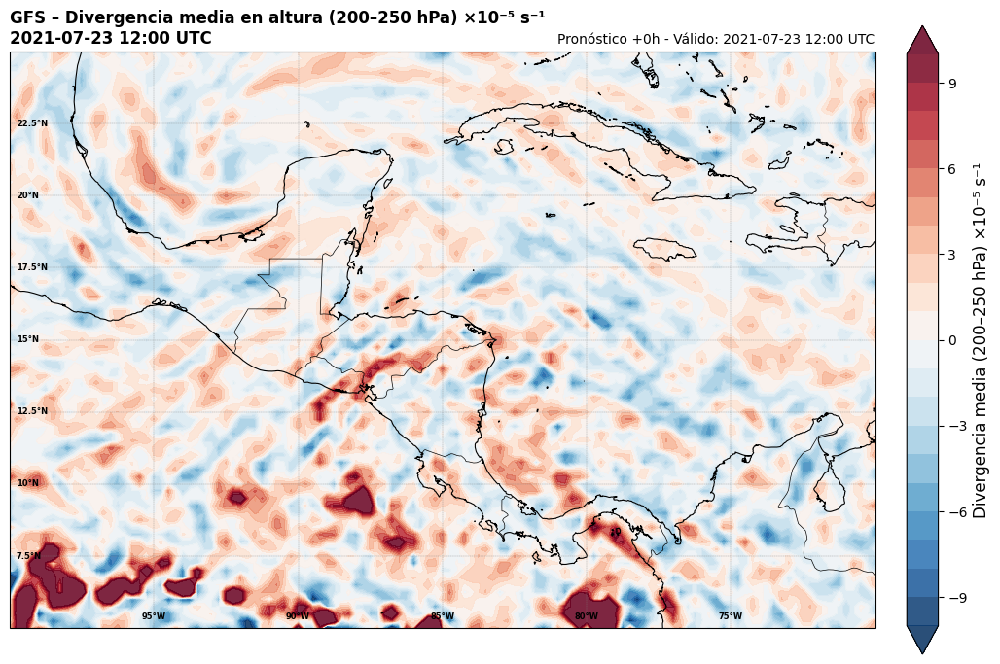

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import metpy.calc as mpcalc
from metpy.units import units

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
print("Descargando viento en capas altas (200 y 250 hPa)...")
H = Herbie("2021-07-23 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento en 200 y 250 hPa
ds = H.xarray(":(U|V)GRD:(200|250) mb")

# Ajusta longitudes y selecciona región
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#

# Coordenadas
lon = ds.longitude.values
lat = ds.latitude.values

lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

# --- Divergencia en 200 hPa ---
u200 = ds['u'].sel(isobaricInhPa=200).metpy.unit_array
v200 = ds['v'].sel(isobaricInhPa=200).metpy.unit_array
div200 = mpcalc.divergence(u200, v200, dx=dx, dy=dy)

# --- Divergencia en 250 hPa ---
u250 = ds['u'].sel(isobaricInhPa=250).metpy.unit_array
v250 = ds['v'].sel(isobaricInhPa=250).metpy.unit_array
div250 = mpcalc.divergence(u250, v250, dx=dx, dy=dy)

# Promedio vertical (200–250 hPa)
div_media = (div200 + div250) / 2
div_media = div_media * 1e5  # ×10⁻⁵ s⁻¹

div_values = div_media.magnitude

print("Cálculo de divergencia en altura completado")

#========================================================================================================================#
#                                              GRAFICACIÓN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo: divergencia en altura
cf = ax.contourf(
    lon, lat, div_values,
    levels=np.linspace(-10, 10, 21),
    cmap='RdBu_r',
    extend='both',
    transform=ccrs.PlateCarree(),
    alpha=0.85
)

# Barra de colores
cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label('Divergencia media (200–250 hPa) ×10⁻⁵ s⁻¹', fontsize=12)

# Elementos geográficos
ax.coastlines(resolution='10m', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, linewidth=0.5)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    color='gray',
    linestyle='--',
    linewidth=0.25,
    draw_labels=True
)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.xlabel_style = {'size': 6, 'weight': 'bold'}
gl.ylabel_style = {'size': 6, 'weight': 'bold'}

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(
    f'GFS – Divergencia media en altura (200–250 hPa) ×10⁻⁵ s⁻¹\n{run_str}',
    fontweight='bold',
    fontsize=12,
    loc='left'
)
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

plt.savefig('/content/output/GFS_DIVERGENCIA_200_250hPa.png', bbox_inches='tight', dpi=150)
plt.show()


Descargando viento en capas altas (250 y 300 hPa)...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2021-Jul-23 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Cálculo de divergencia en altura completado


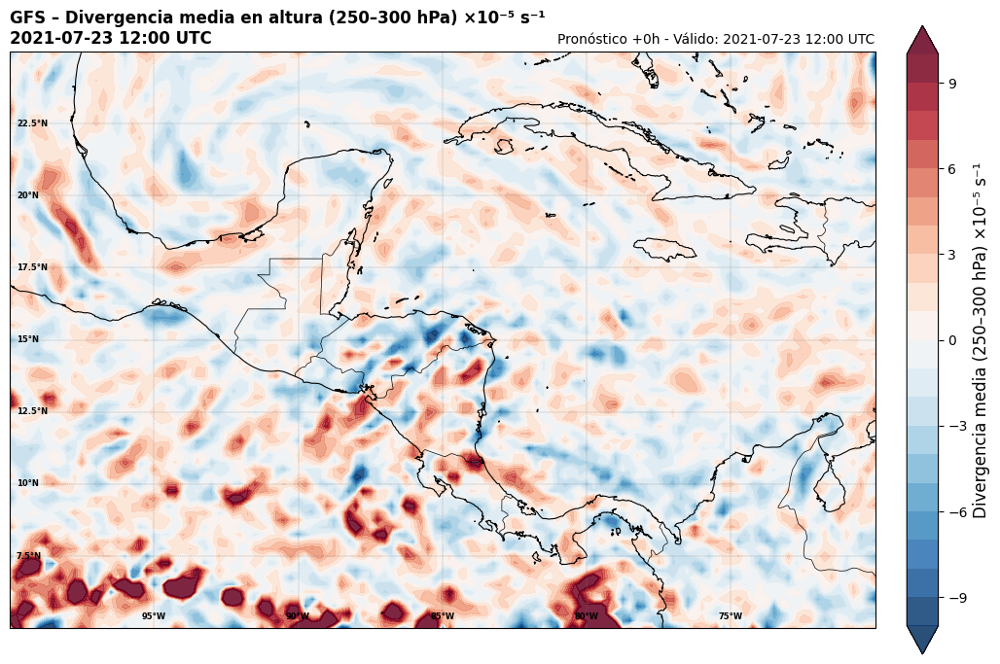

In [ ]:
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import metpy.calc as mpcalc
from metpy.units import units

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
print("Descargando viento en capas altas (250 y 300 hPa)...")
H = Herbie("2021-07-23 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento en 250 y 300 hPa
ds = H.xarray(":(U|V)GRD:(250|300) mb")

# Ajusta longitudes y selecciona región
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#

# Coordenadas
lon = ds.longitude.values
lat = ds.latitude.values

lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

# --- Divergencia en 250 hPa ---
u250 = ds['u'].sel(isobaricInhPa=250).metpy.unit_array
v250 = ds['v'].sel(isobaricInhPa=250).metpy.unit_array
div250 = mpcalc.divergence(u250, v250, dx=dx, dy=dy)

# --- Divergencia en 300 hPa ---
u300 = ds['u'].sel(isobaricInhPa=300).metpy.unit_array
v300 = ds['v'].sel(isobaricInhPa=300).metpy.unit_array
div300 = mpcalc.divergence(u300, v300, dx=dx, dy=dy)

# Promedio vertical (250–300 hPa)
div_media = (div250 + div300) / 2
div_media = div_media * 1e5  # ×10⁻⁵ s⁻¹

div_values = div_media.magnitude

print("Cálculo de divergencia en altura completado")

#========================================================================================================================#
#                                              GRAFICACIÓN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo: divergencia en altura
cf = ax.contourf(
    lon, lat, div_values,
    levels=np.linspace(-10, 10, 21),
    cmap='RdBu_r',
    extend='both',
    transform=ccrs.PlateCarree(),
    alpha=0.85
)

# Barra de colores
cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label('Divergencia media (250–300 hPa) ×10⁻⁵ s⁻¹', fontsize=12)

# Elementos geográficos
ax.coastlines(resolution='10m', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, linewidth=0.5)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    color='gray',
    linestyle='--',
    linewidth=0.25,
    draw_labels=True
)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.xlabel_style = {'size': 6, 'weight': 'bold'}
gl.ylabel_style = {'size': 6, 'weight': 'bold'}

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(
    f'GFS – Divergencia media en altura (250–300 hPa) ×10⁻⁵ s⁻¹\n{run_str}',
    fontweight='bold',
    fontsize=12,
    loc='left'
)
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

plt.savefig('/content/output/GFS_DIVERGENCIA_250_300hPa.png', bbox_inches='tight', dpi=150)
plt.show()


Descargando viento en capas altas (300 y 400 hPa)...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2021-Jul-23 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Cálculo de divergencia en altura (300–400 hPa) completado


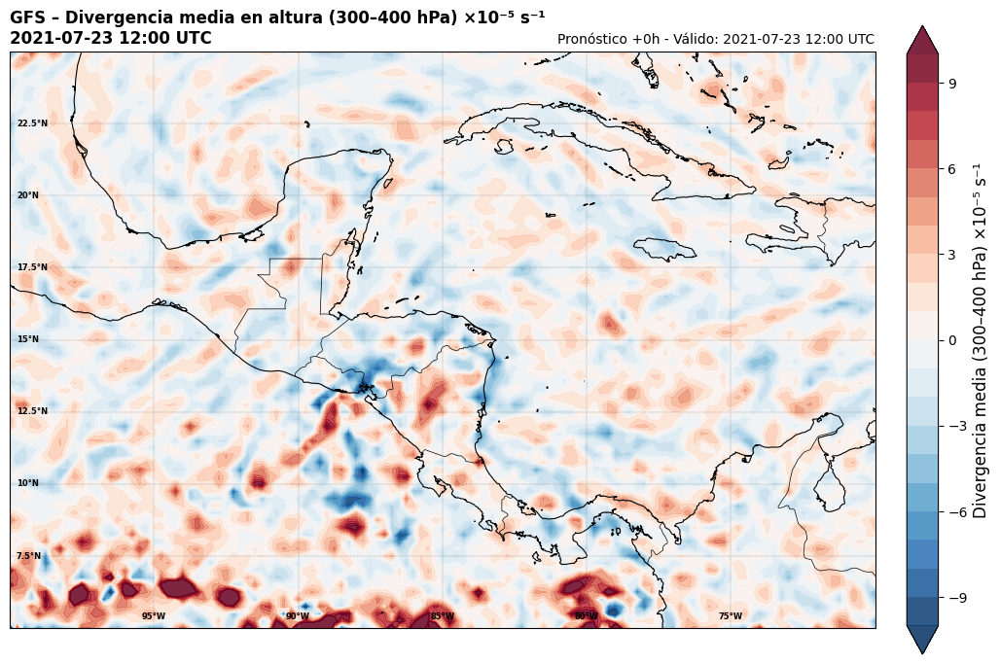

In [ ]:
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import metpy.calc as mpcalc
from metpy.units import units

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
print("Descargando viento en capas altas (300 y 400 hPa)...")
H = Herbie("2021-07-23 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento en 300 y 400 hPa
ds = H.xarray(":(U|V)GRD:(300|400) mb")

# Ajusta longitudes y selecciona región
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#

# Coordenadas
lon = ds.longitude.values
lat = ds.latitude.values

lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

# --- Divergencia en 300 hPa ---
u300 = ds['u'].sel(isobaricInhPa=300).metpy.unit_array
v300 = ds['v'].sel(isobaricInhPa=300).metpy.unit_array
div300 = mpcalc.divergence(u300, v300, dx=dx, dy=dy)

# --- Divergencia en 400 hPa ---
u400 = ds['u'].sel(isobaricInhPa=400).metpy.unit_array
v400 = ds['v'].sel(isobaricInhPa=400).metpy.unit_array
div400 = mpcalc.divergence(u400, v400, dx=dx, dy=dy)

# Promedio vertical (300–400 hPa)
div_media = (div300 + div400) / 2
div_media = div_media * 1e5  # ×10⁻⁵ s⁻¹
div_values = div_media.magnitude

print("Cálculo de divergencia en altura (300–400 hPa) completado")

#========================================================================================================================#
#                                              GRAFICACIÓN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo: divergencia en altura
cf = ax.contourf(
    lon, lat, div_values,
    levels=np.linspace(-10, 10, 21),
    cmap='RdBu_r',
    extend='both',
    transform=ccrs.PlateCarree(),
    alpha=0.85
)

# Barra de colores
cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label('Divergencia media (300–400 hPa) ×10⁻⁵ s⁻¹', fontsize=12)

# Elementos geográficos
ax.coastlines(resolution='10m', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, linewidth=0.5)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(),
    color='gray',
    linestyle='--',
    linewidth=0.25,
    draw_labels=True
)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.xlabel_style = {'size': 6, 'weight': 'bold'}
gl.ylabel_style = {'size': 6, 'weight': 'bold'}

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(
    f'GFS – Divergencia media en altura (300–400 hPa) ×10⁻⁵ s⁻¹\n{run_str}',
    fontweight='bold',
    fontsize=12,
    loc='left'
)
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

plt.savefig('/content/output/GFS_DIVERGENCIA_300_400hPa.png', bbox_inches='tight', dpi=150)
plt.show()


## **Extra: Acceso y Procesamiento WRF IMN**

In [1]:
!wget -c -q --show-progress "https://wrf1-5.imn.ac.cr/modelo/backup/CONIFOR/WRF8-15KM/202512290600_arw_wrfout_d01.grb2" -P /content/samples/

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, etc.)

#========================================================================================================================#
#                                                   ARCHIVO WRF
#========================================================================================================================#
file = "/content/samples/202512290600_arw_wrfout_d01.grb2"

#========================================================================================================================#
#                                             LECTURA DE DATOS WRF (MSLP)
#========================================================================================================================#
ds = xr.open_dataset(file, engine="cfgrib", filter_by_keys={'typeOfLevel': 'meanSea', 'stepType': 'instant'})

# Seleccionamos el primer step disponible (análisis o lead-time 0 normalmente)
mslp = ds['prmsl'].isel(step=0) / 100.0  # convertimos de Pa → hPa

#========================================================================================================================#
#                                       PROCESAMIENTO DE COORDENADAS (WRF)
#========================================================================================================================#
# Coordenadas 1D originales
lat_1d = ds.latitude.values
lon_1d = ds.longitude.values.copy()

# Convertimos longitudes 0–360 → -180/+180
lon_1d[lon_1d > 180] -= 360

# Reconstruimos grids 2D (muy típico en archivos WRF)
ny = len(np.unique(lat_1d))
nx = len(np.unique(ds.longitude.values))

lat_2d = lat_1d.reshape((ny, nx))
lon_2d = lon_1d.reshape((ny, nx))
mslp_2d = mslp.values.reshape((ny, nx))

# Límites del dominio (para set_extent y estadísticas)
min_lon = lon_2d.min()
max_lon = lon_2d.max()
min_lat = lat_2d.min()
max_lat = lat_2d.max()

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Tamaño de figura (recomendado para buena resolución)
fig = plt.figure(figsize=(14, 14))

# Proyección PlateCarree (la más común para este tipo de mapas)
ax = plt.axes(projection=ccrs.PlateCarree())

# Definimos la extensión exacta del dominio del WRF
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--', linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5), draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Niveles de presión típicos para análisis superficial
levels = np.arange(980, 1040, 2)

# Contorno relleno (fondo de color)
cf = ax.contourf(lon_2d, lat_2d, mslp_2d, levels=levels, cmap='RdBu_r', extend='both', transform=ccrs.PlateCarree())

# Contornos negros finos + etiquetas
cont = ax.contour(lon_2d, lat_2d, mslp_2d, levels=levels, colors='lightgray', linewidths=0.6, transform=ccrs.PlateCarree())
labels = ax.clabel(cont, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Barra de colores
cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Presión a Nivel del Mar (hPa)', fontsize=11)

# Hora de validez para el título
valid_time_str = (ds.time + ds.step.isel(step=0)).dt.strftime('%d %b %Y %H:%M UTC').values

# Títulos (estilo similar al ejemplo GFS)
plt.title('WRF-IMN  -  Presión al Nivel del Mar (MSLP)', fontweight='bold', fontsize=13, loc='left')
plt.title(f'Válido: {valid_time_str}', fontsize=11, loc='right')

# Opcional: información adicional del dominio en consola
print("Dominio del WRF:")
print(f"  Lon: {min_lon:.2f}°E  →  {max_lon:.2f}°E")
print(f"  Lat: {min_lat:.2f}°  →  {max_lat:.2f}°")
print(f"  MSLP min: {mslp_2d.min():.1f} hPa")
print(f"  MSLP max: {mslp_2d.max():.1f} hPa")

# Mostrar
plt.show()

ERROR:cfgrib.messages:Can't create file '/content/samples/202512290600_arw_wrfout_d01.grb2.5b7b6.idx'
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/cfgrib/messages.py", line 539, in from_indexpath_or_filestream
    self = cls.from_fieldset(filestream, index_keys, computed_keys)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/cfgrib/messages.py", line 379, in from_fieldset
    return cls.from_fieldset_and_iteritems(fieldset, iteritems, index_keys, computed_keys)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/cfgrib/messages.py", line 392, in from_fieldset_and_iteritems
    for field_id, raw_field in iteritems:
                               ^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/cfgrib/messages.py", line 292, in __iter__
    for message in self.itervalues():
                

FileNotFoundError: [Errno 2] No such file or directory: '/content/samples/202512290600_arw_wrfout_d01.grb2'

# **Actividades Prácticas**
---

## **Estudio de Caso 1: Huracán Julia (8 - 10 de Octubre de 2022)**
Copia y pega las celdas de código de ejemplo para generar tus propias imágenes correspondientes a este estudio de caso.

**Datos sugeridos:**
* Satélite: Visible
* Satélite: 6.2µm: Sistemas de altura y outflow del ciclón.
* Satélite: 10.3µm: Temperatura de topes de nubes.
* Satélite: RGB Nighttime Microphysics
* Satélite: RGB Day Cloud Phase Distinction
* Satélite: TPW
* GFS: Cizalla vertical 850-250 hPa (diferencia vectorial del viento).
* GFS: Vientos en 1000 y 925 850 hPa. Encontrar la capa de mayores vientos.
* GFS: Convergencia en 1000 y 925 850 hPa. Encontrar la capa de mayor convergencia.
* GFS: Convergencia del flujo de razon de mezcla entre 1000 y 850 hPa. Buscar los niveles de mayor convergencia.
* GFS: Vientos de altura y divergencia: Encontrar capa de mayor divergencia entre 300-250, 250-200, 200-150 hPa.
* GFS: Viento promedio de varios niveles, especialmente de 850 a 300 usando todos los niveles. Ayuda a tener una idea del movimiento del sistema.
* GFS: Agua precipitable.
* GFS: Cambio de agua precipitable con respecto a periodos anteriores.
* GFS: Galvez Davison Index (GDI).
* GFS: Cambio de Galvez Davison Index (GDI) con respecto a periodos anteriores.

## **Estudio de Caso 2: Frente (18 - 22 de Febrero de 2024)**
Copia y pega las celdas de código de ejemplo para generar tus propias imágenes correspondientes a este estudio de caso.

**Datos sugeridos:**
* Satélite: Visible
* Satélite: 6.2µm: Diagnosticar el flujo de altura difluente, identificar an anticiclón de altura.
* Satélite: 10.3µm: Topes de nubes
* Satélite: RGB Nighttime Microphysics
* Satélite: RGB Day Cloud Phase Distinction
* Satélite: TPW
* GFS: Espesor 1000-925 hPa (es la diferencia de altura geopotencial entre 1000 y 925 hPa).
* GFS: Humedad relativa en 925 y en 850 hPa. Resaltar valores mayores a 90%.
* GFS: Vientos en 1000 y 925 hPa.
* GFS: Convergencia en 1000 y 925 hPa.
* GFS: Convergencia del flujo de razon de mezcla 1000 hPa.
* GFS: Temperaturas de rocío de 1000 y de 925 hPa.
* GFS: Vientos de altura y divergencia: Encontrar capa de mayor Divergencia entre 400-300, 300-250 y 250-200.
* GFS: Agua precipitable.
* GFS: Galvez Davison Index (GDI).
* GFS: Cambio de temperatura en 1000 y 925 con respecto a periodos anteriores. Simple resta de tiempos distintos.


## **Estudio de Caso 3: Lluvias en Turrialba (21 - 23 de Julio de 2021)**
Copia y pega las celdas de código de ejemplo para generar tus propias imágenes correspondientes a este estudio de caso.

**Datos sugeridos:**
* Satélite: 6.2µm: Diagnosticar el flujo de altura difluente, identificar an anticiclón de altura.
* Satélite: 10.3µm: Topes de nubes.
* Satélite: RGB Day Cloud Phase Distinction (mañana del 23 de julio).
* Satélite: RGB Nighttime microphysics (madrugada del 23 de julio).
* GFS: Vientos en 600, 500 y 400 hPa. Encontrar capa de vientos del este-sureste.
* GFS: Vientos en 1000, 925 y 850 hPa. Encontrar la capa de mayores vientos.
* GFS: Convergencia en 1000, 925 y 850 hPa. Encontrar la capa de mayor convergencia.
* GFS: Convergencia en 1000, 925 y 850 hPa y vorticidad ciclonica. Encontrar la capa de mayor vorticidad.
* GFS: Convergencia del flujo de razon de mezcla 1000, 925 y 850 hPa. Encontrar la capa de mayor Convergencia.
* GFS: Vientos de altura: vientos en 200 y 250 hPa. Encontrar capa de mayor divergencia.
* GFS: Agua precipitable.
* GFS: Galvez Davison Index (GDI).

Agua Precipitable

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


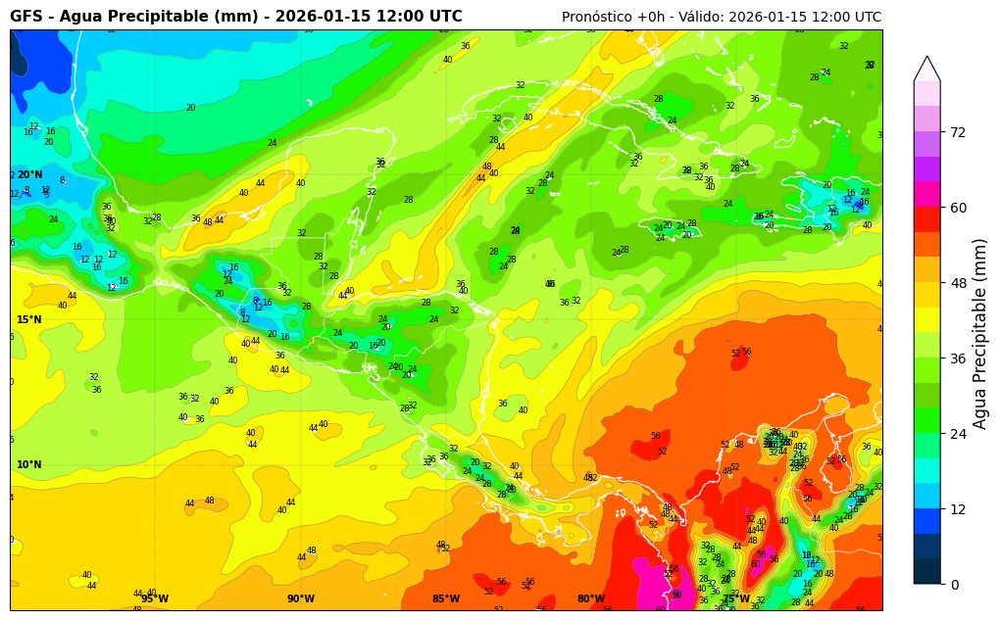

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
from datetime import datetime       # Manejo básico de fechas y horas

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga los datos de Agua Precipitable (PWAT) / Puedes usar también: ":PWAT:surface:"   o   "PWAT"   o   ":PWAT:"
ds = H.xarray(":PWAT:")

# Recorta la región de interés
# Nota: longitude en GFS va de 0 a 360 → sumamos 360 a los valores negativos
ds = ds.sel(longitude=slice(min_lon + 360, max_lon + 360), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Extraemos la variable (generalmente se llama 'pwat')
pwat = ds['pwat'] # ya viene en mm (o kg/m²) en GFS

# Coordenadas para graficar
lon = ds.longitude.values
lat = ds.latitude.values

# Suaviza los contornos
import scipy.ndimage
pwat = scipy.ndimage.zoom(pwat, 3)
lon = scipy.ndimage.zoom(lon, 3)
lat = scipy.ndimage.zoom(lat, 3)

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))

# Proyección PlateCarree
ax = plt.axes(projection=ccrs.PlateCarree())

# Extensión geográfica
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles sugeridos para PWAT (puedes ajustar según la región/época)
levels = np.arange(0, 81, 4)          # cada 4 mm

# Contornos rellenos (relleno suave)
contour = ax.contourf(lon, lat, pwat, levels=levels, cmap='gist_ncar', extend='max', transform=ccrs.PlateCarree())

# Líneas de contorno adicionales (opcional)
ax.contour(lon, lat, pwat, levels=levels, colors='gray', linewidths=0.6, alpha=0.5, transform=ccrs.PlateCarree())

# Etiquetas en los contornos (puede ser pesado si hay muchos niveles)
# Comenta esta parte si se ve muy cargado
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=8, colors="black")
for l in labels: l.set_rotation(0)

# Mapa base
ax.coastlines(resolution='10m', color='white', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='white', linewidth=0.5)

# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8,
                  linestyle='--', linewidth=0.3,
                  xlocs=np.arange(-180, 181, 5),
                  ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

# Barra de colores
cbar = plt.colorbar(contour, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Agua Precipitable (mm)', fontsize=12)

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GFS - Agua Precipitable (mm) - {run_str}', fontweight='bold', fontsize=11, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guardar y mostrar
plt.savefig('pwat_gfs_region.png', bbox_inches='tight', dpi=150)
plt.show()

Cizalla Vertical 850-250

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


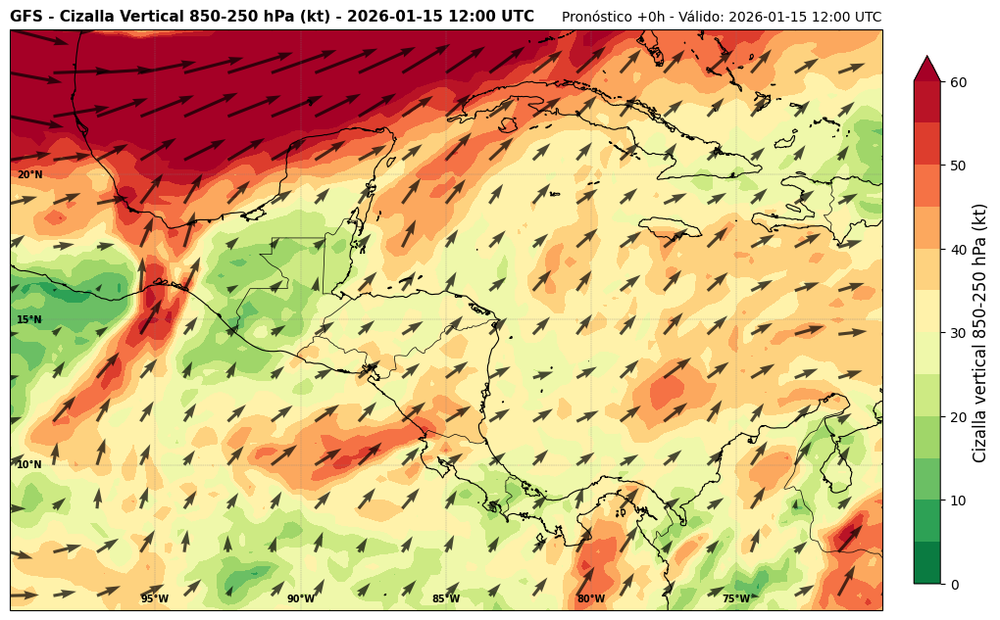

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from datetime import datetime

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Fecha de ejemplo (cámbiala según necesites)
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Cargamos vientos a 850 hPa y 250 hPa en una sola llamada
# Nota: GFS tiene 250 hPa, no siempre 200 hPa en todos los productos
ds = H.xarray(":(U|V)GRD:(850|250) mb")

# Ajustamos coordenadas a -180° ~ +180° (muy recomendado para regiones del oeste)
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")

# Recortamos la región de interés
ds = ds.sel(longitude=slice(min_lon, max_lon),
            latitude=slice(max_lat, min_lat))   # latitud descendente

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Extraemos componentes del viento
u850 = ds['u'].sel(isobaricInhPa=850)
v850 = ds['v'].sel(isobaricInhPa=850)

u250 = ds['u'].sel(isobaricInhPa=250)
v250 = ds['v'].sel(isobaricInhPa=250)

# Diferencia vectorial (cizalla)
du = u250 - u850
dv = v250 - v850

# Magnitud de la cizalla en m/s y conversión a nudos (kt)
shear_ms = np.sqrt(du**2 + dv**2)
shear_kt = shear_ms * 1.94384   # 1 m/s ≈ 1.94384 kt

# Coordenadas para graficar
lon = ds.longitude.values
lat = ds.latitude.values

# Opcional: dirección de la cizalla (puedes graficarla con quiver si quieres)
shear_dir = np.degrees(np.arctan2(dv, du)) % 360

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles recomendados para cizalla 850-250 hPa (kt)
# <10 kt → muy baja, 10-20 → moderada, 20-40 → alta, >40 → muy alta (inhibe ciclones)
levels = np.arange(0, 61, 5)

# Fondo de color (magnitud de la cizalla)
cf = ax.contourf(lon, lat, shear_kt,
                 levels=levels,
                 cmap='RdYlGn_r',          # rojo = alta cizalla, verde = baja
                 extend='max',
                 transform=ccrs.PlateCarree())

# Contornos negros finos
#ax.contour(lon, lat, shear_kt, levels=levels,
#           colors='black', linewidths=0.5, alpha=0.6,
#           transform=ccrs.PlateCarree())

# Opcional: flechas de dirección de la cizalla (vectorial)
skip = 6
ax.quiver(lon[::skip], lat[::skip],
          du[::skip, ::skip], dv[::skip, ::skip],
          scale=600, color='black', alpha=0.7,
          transform=ccrs.PlateCarree())

# Mapa base
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
ax.add_feature(cfeature.LAND, facecolor='lightgray', alpha=0.15)

# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8,
                  linestyle='--', linewidth=0.3,
                  xlocs=np.arange(-180, 181, 5),
                  ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

# Barra de color
cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Cizalla vertical 850-250 hPa (kt)', fontsize=12)

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GFS - Cizalla Vertical 850-250 hPa (kt) - {run_str}', fontweight='bold', fontsize=11, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guardar y mostrar
plt.savefig('cizalla_850_250_gfs.png', bbox_inches='tight', dpi=150)
plt.show()

Cizalla Vertical 500-200

✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


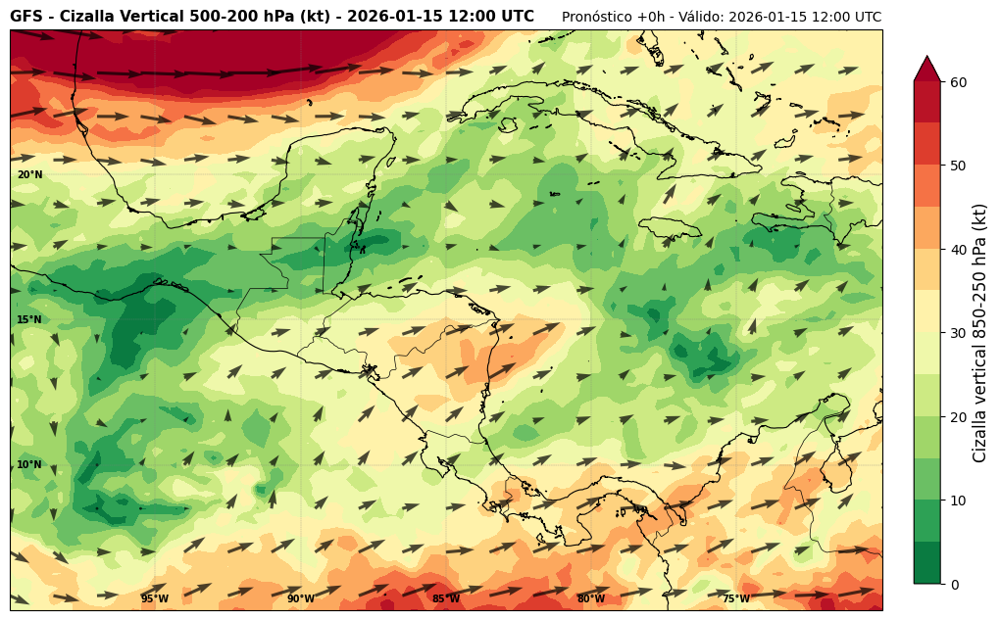

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from datetime import datetime

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100  ; max_lon = -70
min_lat = 5     ; max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Fecha de ejemplo (cámbiala según necesites)
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Cargamos vientos a 850 hPa y 250 hPa en una sola llamada
# Nota: GFS tiene 250 hPa, no siempre 200 hPa en todos los productos
ds = H.xarray(":(U|V)GRD:(500|200) mb")

# Ajustamos coordenadas a -180° ~ +180° (muy recomendado para regiones del oeste)
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")

# Recortamos la región de interés
ds = ds.sel(longitude=slice(min_lon, max_lon),
            latitude=slice(max_lat, min_lat))   # latitud descendente

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Extraemos componentes del viento
u500 = ds['u'].sel(isobaricInhPa=500)
v500 = ds['v'].sel(isobaricInhPa=500)

u200 = ds['u'].sel(isobaricInhPa=200)
v200 = ds['v'].sel(isobaricInhPa=200)

# Diferencia vectorial (cizalla)
du = u200 - u500
dv = v200 - v500

# Magnitud de la cizalla en m/s y conversión a nudos (kt)
shear_ms = np.sqrt(du**2 + dv**2)
shear_kt = shear_ms * 1.94384   # 1 m/s ≈ 1.94384 kt

# Coordenadas para graficar
lon = ds.longitude.values
lat = ds.latitude.values

# Opcional: dirección de la cizalla (puedes graficarla con quiver si quieres)
shear_dir = np.degrees(np.arctan2(dv, du)) % 360

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles recomendados para cizalla 850-250 hPa (kt)
# <10 kt → muy baja, 10-20 → moderada, 20-40 → alta, >40 → muy alta (inhibe ciclones)
levels = np.arange(0, 61, 5)

# Fondo de color (magnitud de la cizalla)
cf = ax.contourf(lon, lat, shear_kt,
                 levels=levels,
                 cmap='RdYlGn_r',          # rojo = alta cizalla, verde = baja
                 extend='max',
                 transform=ccrs.PlateCarree())

# Contornos negros finos
#ax.contour(lon, lat, shear_kt, levels=levels,
#           colors='black', linewidths=0.5, alpha=0.6,
#           transform=ccrs.PlateCarree())

# Opcional: flechas de dirección de la cizalla (vectorial)
skip = 6
ax.quiver(lon[::skip], lat[::skip],
          du[::skip, ::skip], dv[::skip, ::skip],
          scale=600, color='black', alpha=0.7,
          transform=ccrs.PlateCarree())

# Mapa base
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
ax.add_feature(cfeature.LAND, facecolor='lightgray', alpha=0.15)

# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8,
                  linestyle='--', linewidth=0.3,
                  xlocs=np.arange(-180, 181, 5),
                  ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

# Barra de color
cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Cizalla vertical 850-250 hPa (kt)', fontsize=12)

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GFS - Cizalla Vertical 500-200 hPa (kt) - {run_str}', fontweight='bold', fontsize=11, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guardar y mostrar
plt.savefig('cizalla_850_250_gfs.png', bbox_inches='tight', dpi=150)
plt.show()

Convergencia / Divergencia (una sola capa)

Descargando viento a 925 hPa...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Calculando divergencia y convergencia en 925 hPa...
Cálculo completado


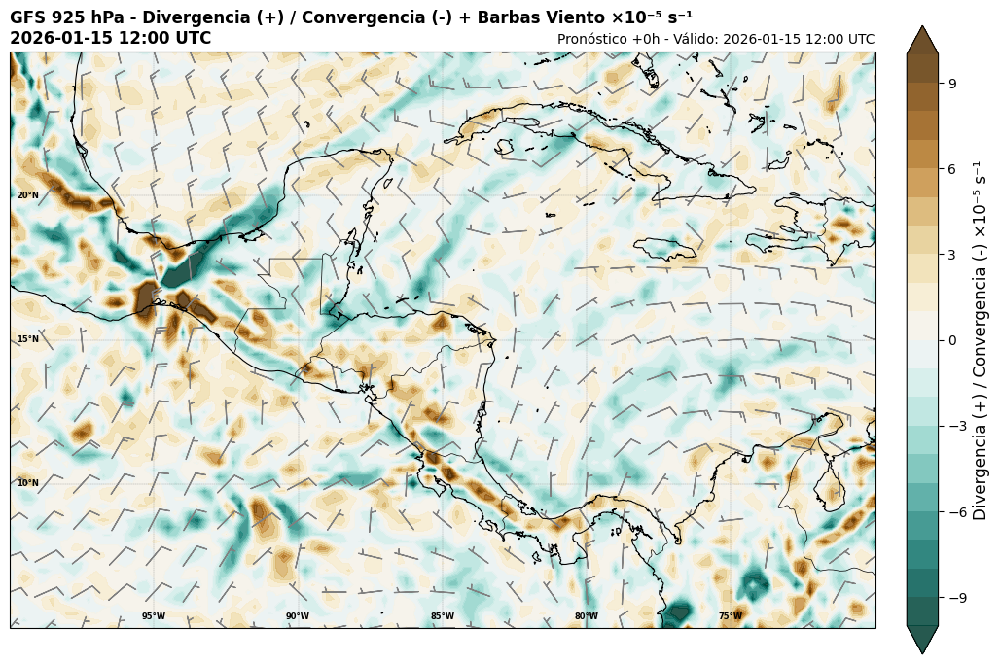

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
import metpy.calc as mpcalc         # Cálculos meteorológicos (vorticidad, gradientes, viento, etc.)
from metpy.units import units       # Manejo de unidades físicas con soporte de MetPy (Pa, K, m/s, etc.)

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
print("Descargando viento a 925 hPa...")
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Carga viento a 925 hPa, convierte las longitudes para -180 ~ 180 y selecciona la región
ds_viento = H.xarray(":(U|V)GRD:925 mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Extrae las componentes u y v (solo 925 hPa)
u = ds_viento['u'].metpy.unit_array   # componente zonal (m/s)
v = ds_viento['v'].metpy.unit_array   # componente meridional (m/s)

# Leemos las coordenadas (vectores 1D)
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values

# Creamos las grillas 2D necesarias para contourf y barbs
lon2d, lat2d = np.meshgrid(lon, lat)

# Calculamos las distancias entre puntos de la grilla (dx, dy en metros)
lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

# Cálculo de divergencia y convergencia (solo nivel 925 hPa)
print("Calculando divergencia y convergencia en 925 hPa...")
divergencia = mpcalc.divergence(u, v, dx=dx, dy=dy)

# CORRECCIÓN DEL SIGNO: negativo = convergencia (para que marrón = convergencia en BrBG_r)
convergencia = divergencia * 1e5   # ×10⁻⁵ s⁻¹   (positivo = divergencia, negativo = convergencia)

# Valores numéricos para el gráfico
conv_values = convergencia.magnitude

print("Cálculo completado")

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo: Convergencia / Divergencia (marrón = convergencia)
contourf = ax.contourf(lon2d, lat2d, conv_values,
                       levels=np.linspace(-10, 10, 21),
                       cmap='BrBG_r', extend='both',
                       transform=ccrs.PlateCarree(),
                       alpha=0.85)

# Superposición de barbas de viento a 925 hPa
skip = 5  # Ajusta según necesites (4 = más denso, 6-7 = más limpio)

ax.barbs(lon2d[::skip, ::skip], lat2d[::skip, ::skip],
         u[::skip, ::skip].m, v[::skip, ::skip].m,
         length=6, pivot="middle", barbcolor="gray", flagcolor="gray",
         linewidth=0.9, sizes=dict(emptybarb=0.0),
         flip_barb=(lat2d[::skip, ::skip] < 0),
         transform=ccrs.PlateCarree())

# Barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label('Divergencia (+) / Convergencia (-) ×10⁻⁵ s⁻¹', fontsize=12)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5),
                  draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega un título claro con la convención de signos
run_str = np.datetime_as_string(ds_viento.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_viento.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS 925 hPa - Divergencia (+) / Convergencia (-) + Barbas Viento ×10⁻⁵ s⁻¹\n{run_str}',
          fontweight='bold', fontsize=12, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig('/content/output/GFS_925hPa_DIVERGENCIA_CONVERGENCIA_BARBS.png',
            bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

Convergencia / Divergencia (promedio)

Descargando viento a 1000 hPa y 925 hPa...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Calculando divergencia en 1000 hPa y 925 hPa...
Cálculo completado


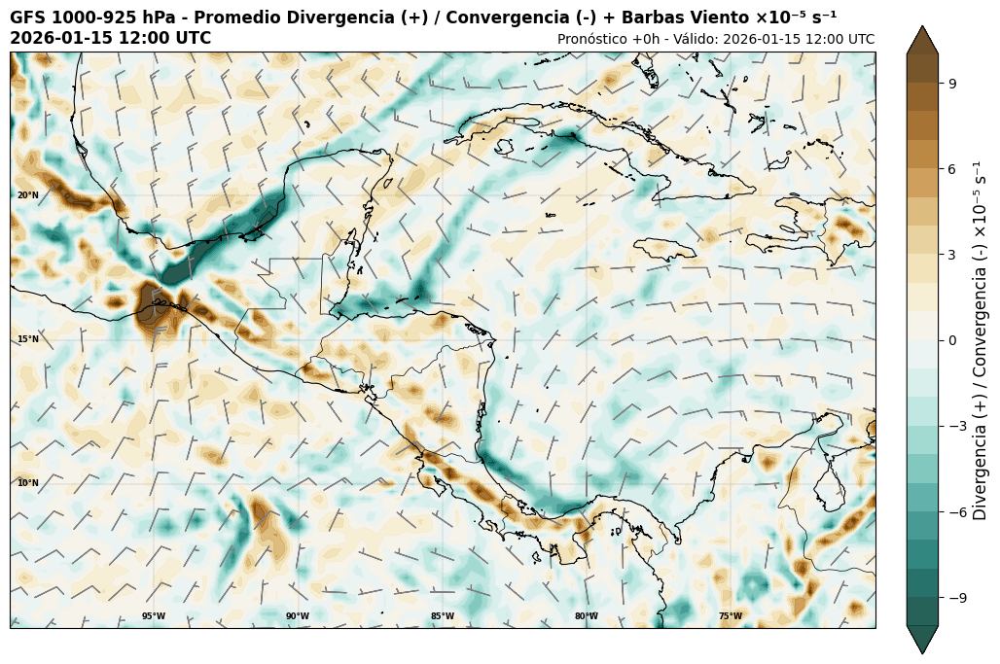

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
import metpy.calc as mpcalc         # Cálculos meteorológicos (vorticidad, gradientes, viento, etc.)
from metpy.units import units       # Manejo de unidades físicas con soporte de MetPy (Pa, K, m/s, etc.)

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
print("Descargando viento a 1000 hPa y 925 hPa...")
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Ahora cargamos DOS niveles a la vez (más eficiente)
ds_viento = H.xarray(":(U|V)GRD:(1000|925) mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Extraemos u y v para cada nivel
u1000 = ds_viento['u'].sel(isobaricInhPa=1000).metpy.unit_array
v1000 = ds_viento['v'].sel(isobaricInhPa=1000).metpy.unit_array

u925  = ds_viento['u'].sel(isobaricInhPa=925).metpy.unit_array
v925  = ds_viento['v'].sel(isobaricInhPa=925).metpy.unit_array

# Promedio vectorial de las componentes del viento (1000-925 hPa)
u_mean = (u1000 + u925) / 2
v_mean = (v1000 + v925) / 2

# Leemos las coordenadas (vectores 1D)
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values

# Creamos las grillas 2D necesarias para contourf y barbs
lon2d, lat2d = np.meshgrid(lon, lat)

# Calculamos las distancias entre puntos de la grilla (dx, dy en metros)
lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

# Calculamos divergencia en cada nivel
print("Calculando divergencia en 1000 hPa y 925 hPa...")
div_1000 = mpcalc.divergence(u1000, v1000, dx=dx, dy=dy)
div_925  = mpcalc.divergence(u925,  v925,  dx=dx, dy=dy)

# Promedio simple entre las dos capas
divergencia_promedio = (div_1000 + div_925) / 2

# CORRECCIÓN DEL SIGNO: ahora positivo = divergencia, negativo = convergencia
convergencia = divergencia_promedio * 1e5   # ×10⁻⁵ s⁻¹

# Valores numéricos para el gráfico
conv_values = convergencia.magnitude

print("Cálculo completado")

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo: Convergencia / Divergencia (con BrBG_r: marrones = valores negativos = convergencia)
contourf = ax.contourf(lon2d, lat2d, conv_values,
                       levels=np.linspace(-10, 10, 21),
                       cmap='BrBG_r', extend='both',
                       transform=ccrs.PlateCarree(),
                       alpha=0.85)

# Superposición de barbas (viento promedio 1000-925 hPa)
skip = 5  # Ajusta este valor según densidad deseada (4 más denso, 6-7 más limpio)

ax.barbs(lon2d[::skip, ::skip], lat2d[::skip, ::skip],
         u_mean[::skip, ::skip].m, v_mean[::skip, ::skip].m,
         length=6, pivot="middle", barbcolor="gray", flagcolor="gray",
         linewidth=0.9, sizes=dict(emptybarb=0.0),
         flip_barb=(lat2d[::skip, ::skip] < 0),
         transform=ccrs.PlateCarree())

# Barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label('Divergencia (+) / Convergencia (-) ×10⁻⁵ s⁻¹', fontsize=12)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5),
                  draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega un título claro con la convención de signos
run_str = np.datetime_as_string(ds_viento.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_viento.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS 1000-925 hPa - Promedio Divergencia (+) / Convergencia (-) + Barbas Viento ×10⁻⁵ s⁻¹\n{run_str}',
          fontweight='bold', fontsize=12, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig('/content/output/GFS_1000-925hPa_CONVERGENCIA_PROMEDIO_BARBS_CORREGIDO.png',
            bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

Vientos de altura y divergencia

Descargando viento a 1000 hPa y 925 hPa...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p50 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Calculando divergencia en 300 hPa y 250 hPa...
Cálculo completado


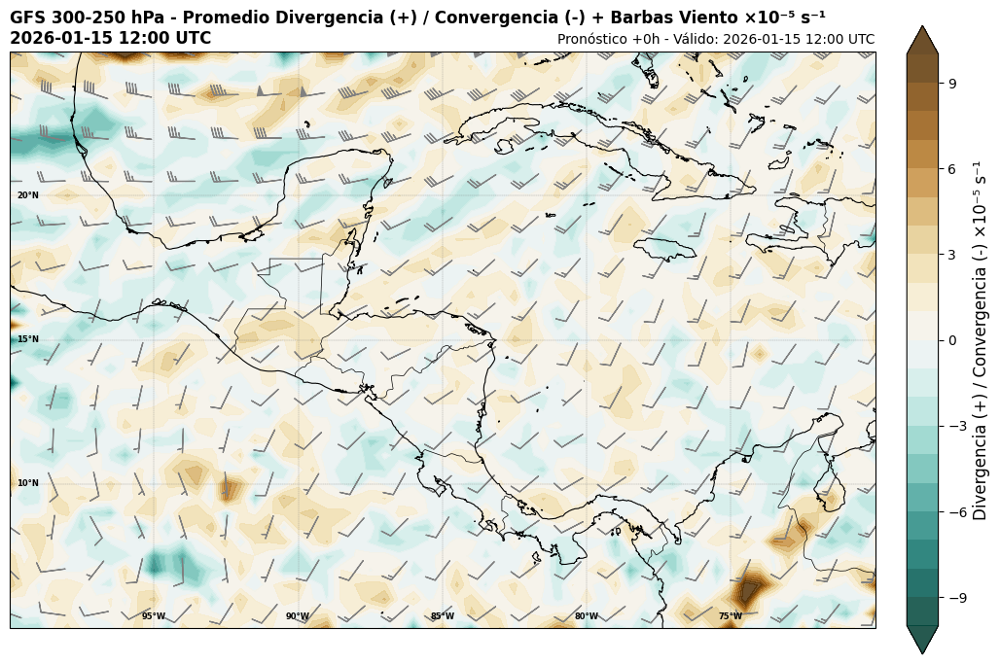

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
import metpy.calc as mpcalc         # Cálculos meteorológicos (vorticidad, gradientes, viento, etc.)
from metpy.units import units       # Manejo de unidades físicas con soporte de MetPy (Pa, K, m/s, etc.)

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
# Define la extensión deseada (lon min, lat min, lon max, lat max)
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Crea el objeto Herbie para acceder a los datos del GFS
print("Descargando viento a 1000 hPa y 925 hPa...")
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p50", fxx=0)

# Ahora cargamos DOS niveles a la vez (más eficiente)
ds_viento = H.xarray(":(U|V)GRD:(300|250) mb")
ds_viento = ds_viento.assign_coords(longitude=((ds_viento.longitude + 180) % 360) - 180).sortby("longitude")
ds_viento = ds_viento.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Extraemos u y v para cada nivel
u300 = ds_viento['u'].sel(isobaricInhPa=300).metpy.unit_array
v300 = ds_viento['v'].sel(isobaricInhPa=300).metpy.unit_array

u250  = ds_viento['u'].sel(isobaricInhPa=250).metpy.unit_array
v250  = ds_viento['v'].sel(isobaricInhPa=250).metpy.unit_array

# Promedio vectorial de las componentes del viento (1000-925 hPa)
u_mean = (u300 + u250) / 2
v_mean = (v300 + v250) / 2

# Leemos las coordenadas (vectores 1D)
lon = ds_viento.longitude.values
lat = ds_viento.latitude.values

# Creamos las grillas 2D necesarias para contourf y barbs
lon2d, lat2d = np.meshgrid(lon, lat)

# Calculamos las distancias entre puntos de la grilla (dx, dy en metros)
lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

# Calculamos divergencia en cada nivel
print("Calculando divergencia en 300 hPa y 250 hPa...")
div_300 = mpcalc.divergence(u300, v300, dx=dx, dy=dy)
div_250  = mpcalc.divergence(u250,  v250,  dx=dx, dy=dy)

# Promedio simple entre las dos capas
divergencia_promedio = (div_300 + div_250) / 2

# CORRECCIÓN DEL SIGNO: ahora positivo = divergencia, negativo = convergencia
convergencia = divergencia_promedio * 1e5   # ×10⁻⁵ s⁻¹

# Valores numéricos para el gráfico
conv_values = convergencia.magnitude

print("Cálculo completado")

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
# Elige el tamaño de la figura (ancho x alto, en pulgadas)
fig = plt.figure(figsize=(14, 14))

# Usa la proyección equidistante (PlateCarree) en cartopy
ax = plt.axes(projection=ccrs.PlateCarree())

# Define la extensión de la imagen
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo: Convergencia / Divergencia (con BrBG_r: marrones = valores negativos = convergencia)
contourf = ax.contourf(lon2d, lat2d, conv_values,
                       levels=np.linspace(-10, 10, 21),
                       cmap='BrBG_r', extend='both',
                       transform=ccrs.PlateCarree(),
                       alpha=0.85)

# Superposición de barbas (viento promedio 1000-925 hPa)
skip = 3  # Ajusta este valor según densidad deseada (4 más denso, 6-7 más limpio)

ax.barbs(lon2d[::skip, ::skip], lat2d[::skip, ::skip],
         u_mean[::skip, ::skip].m, v_mean[::skip, ::skip].m,
         length=6, pivot="middle", barbcolor="gray", flagcolor="gray",
         linewidth=0.9, sizes=dict(emptybarb=0.0),
         flip_barb=(lat2d[::skip, ::skip] < 0),
         transform=ccrs.PlateCarree())

# Barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label('Divergencia (+) / Convergencia (-) ×10⁻⁵ s⁻¹', fontsize=12)

# Agrega costas, fronteras y líneas
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
                  linewidth=0.25, xlocs=np.arange(-180, 180, 5), ylocs=np.arange(-90, 90, 5),
                  draw_labels=True)
gl.top_labels = False; gl.right_labels = False
gl.xpadding = -5; gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Agrega un título claro con la convención de signos
run_str = np.datetime_as_string(ds_viento.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_viento.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
plt.title(f'GFS 300-250 hPa - Promedio Divergencia (+) / Convergencia (-) + Barbas Viento ×10⁻⁵ s⁻¹\n{run_str}',
          fontweight='bold', fontsize=12, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guarda la imagen
plt.savefig('/content/output/GFS_1000-925hPa_CONVERGENCIA_PROMEDIO_BARBS_CORREGIDO.png',
            bbox_inches='tight', dpi=150)

# Muestra la imagen
plt.show()

Convergencia del flujo de razon de mezcla entre 1000 y 850 hPa




Descargando datos para 1000 hPa y 850 hPa (u, v, q)...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p50 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ aws


/usr/local/lib/python3.12/dist-packages/herbie/core.py:978: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  logic = df.search_this.str.contains(search)
/usr/local/lib/python3.12/dist-packages/cfgrib/xarray_store.py:51: FutureWarning: In a future version of xarray the default value for compat will change from compat='no_conflicts' to compat='override'. This is likely to lead to different results when combining overlapping variables with the same name. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set compat explicitly.
  o = xr.merge([o, ds], **kwargs)
/usr/local/lib/python3.12/dist-packages/herbie/core.py:978: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  logic = df.search_this.str.contains(search)


Descarga completada
Calculando MFC en 1000 hPa y 850 hPa...
Cálculo completado


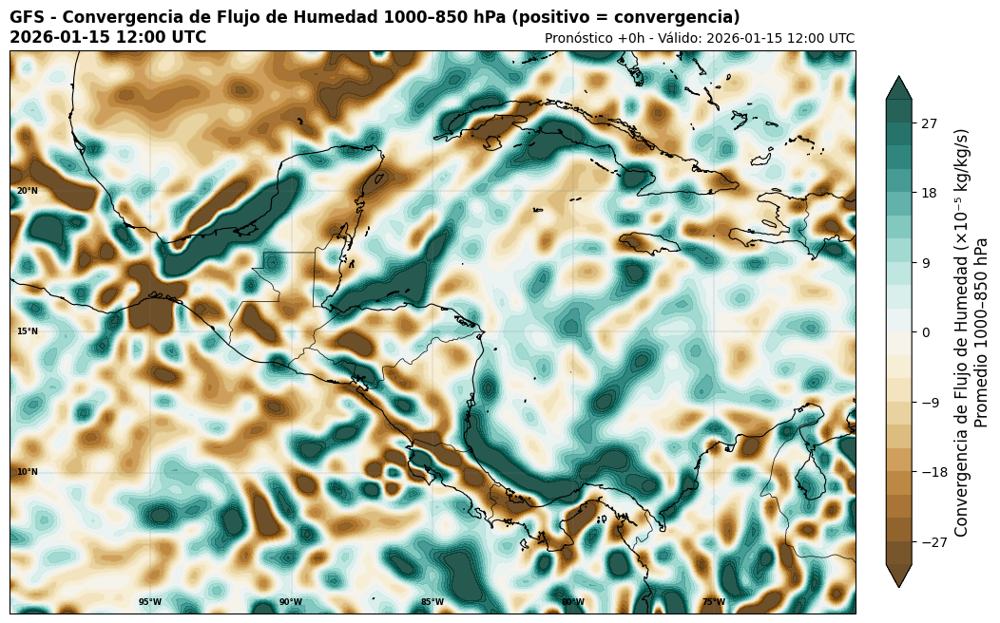

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie           # Descarga y lectura sencilla de archivos GRIB (GFS, HRRR, etc)
import xarray as xr                 # Lectura de NetCDF, GRIB, datos multidimensionales
import matplotlib.pyplot as plt     # Creación de gráficos y mapas base
import cartopy.crs as ccrs          # Sistemas de referencia de coordenadas (proyecciones)
import cartopy.feature as cfeature  # Elementos geográficos listos (costas, países, ríos, etc.)
import numpy as np                  # Operaciones numéricas (arrays, matemáticas)
import metpy.calc as mpcalc         # Cálculos meteorológicos
from metpy.units import units       # Manejo de unidades físicas con soporte de MetPy

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
print("Descargando datos para 1000 hPa y 850 hPa (u, v, q)...")

H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p50", fxx=0)

# -----------------------------
# Viento (u, v)
# -----------------------------
ds_uv = H.xarray(":(U|V)GRD:(1000|850) mb")
ds_uv = ds_uv.assign_coords(longitude=((ds_uv.longitude + 180) % 360) - 180).sortby("longitude")
ds_uv = ds_uv.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

# -----------------------------
# Humedad específica (q)
# -----------------------------
ds_q = H.xarray("SPFH:(1000|850) mb")
ds_q = ds_q.assign_coords(longitude=((ds_q.longitude + 180) % 360) - 180).sortby("longitude")
ds_q = ds_q.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# PROCESAMIENTO
q1000 = ds_q['q'].sel(isobaricInhPa=1000).metpy.unit_array * 1000
q850  = ds_q['q'].sel(isobaricInhPa=850).metpy.unit_array * 1000

u1000 = ds_uv['u'].sel(isobaricInhPa=1000).metpy.unit_array
v1000 = ds_uv['v'].sel(isobaricInhPa=1000).metpy.unit_array
u850  = ds_uv['u'].sel(isobaricInhPa=850).metpy.unit_array
v850  = ds_uv['v'].sel(isobaricInhPa=850).metpy.unit_array

# Coordenadas y deltas (igual)
lon = ds_uv.longitude.values
lat = ds_uv.latitude.values
lon2d, lat2d = np.meshgrid(lon, lat)

lon_metpy = lon * units.degrees
lat_metpy = lat * units.degrees
dx, dy = mpcalc.lat_lon_grid_deltas(lon_metpy, lat_metpy)

print("Calculando MFC en 1000 hPa y 850 hPa...")

qu_1000 = q1000 * u1000
qv_1000 = q1000 * v1000
qu_850  = q850 * u850
qv_850  = q850 * v850

mfc_1000 = mpcalc.divergence(qu_1000, qv_1000, dx=dx, dy=dy)
mfc_850  = mpcalc.divergence(qu_850, qv_850, dx=dx, dy=dy)

mfc_promedio = (mfc_1000 + mfc_850) / 2

mfc_values = -mfc_promedio.magnitude * 1e5   # positivo = convergencia (g kg⁻¹ s⁻¹ ×10⁻⁵)

print("Cálculo completado")

# Suaviza los contornos
import scipy.ndimage
mfc_values = scipy.ndimage.zoom(mfc_values, 3)
lon2d = scipy.ndimage.zoom(lon, 3)
lat2d = scipy.ndimage.zoom(lat, 3)

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Campo de convergencia de humedad
contourf = ax.contourf(lon2d, lat2d, mfc_values,
                       levels=np.linspace(-30, 30, 21),
                       cmap='BrBG', extend='both',
                       transform=ccrs.PlateCarree(),
                       alpha=0.85)

# Barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Convergencia de Flujo de Humedad (×10⁻⁵ kg/kg/s)\nPromedio 1000–850 hPa', fontsize=12)

# Mapa base
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)

gl = ax.gridlines(
    crs=ccrs.PlateCarree(), color='gray', alpha=1.0, linestyle='--',
    linewidth=0.25, xlocs=np.arange(-180, 180, 5),
    ylocs=np.arange(-90, 90, 5), draw_labels=True
)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 6, 'weight': 'bold'}

# Títulos
run_str = np.datetime_as_string(ds_uv.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_uv.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(
    f'GFS - Convergencia de Flujo de Humedad 1000–850 hPa (positivo = convergencia)\n{run_str}',
    fontweight='bold', fontsize=12, loc='left'
)
plt.title(
    f'Pronóstico +{H.fxx}h - Válido: {valid_str}',
    fontsize=10, loc='right'
)

# Guardar y mostrar
plt.savefig('/content/output/GFS_MFC_1000_850hPa.png', bbox_inches='tight', dpi=150)
plt.show()

Temperatura de Rocio

Descargando Temperatura (TMP) y Humedad Relativa (RH) a 1000 hPa...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


/usr/local/lib/python3.12/dist-packages/herbie/core.py:978: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  logic = df.search_this.str.contains(search)
/usr/local/lib/python3.12/dist-packages/cfgrib/xarray_store.py:51: FutureWarning: In a future version of xarray the default value for compat will change from compat='no_conflicts' to compat='override'. This is likely to lead to different results when combining overlapping variables with the same name. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set compat explicitly.
  o = xr.merge([o, ds], **kwargs)


Descarga completada. Variables disponibles: ['time', 'step', 'isobaricInhPa', 'latitude', 'valid_time', 't', 'r', 'gribfile_projection', 'longitude']
Cálculo de Td completado. Rango aproximado: -1.7 a 27.2 °C


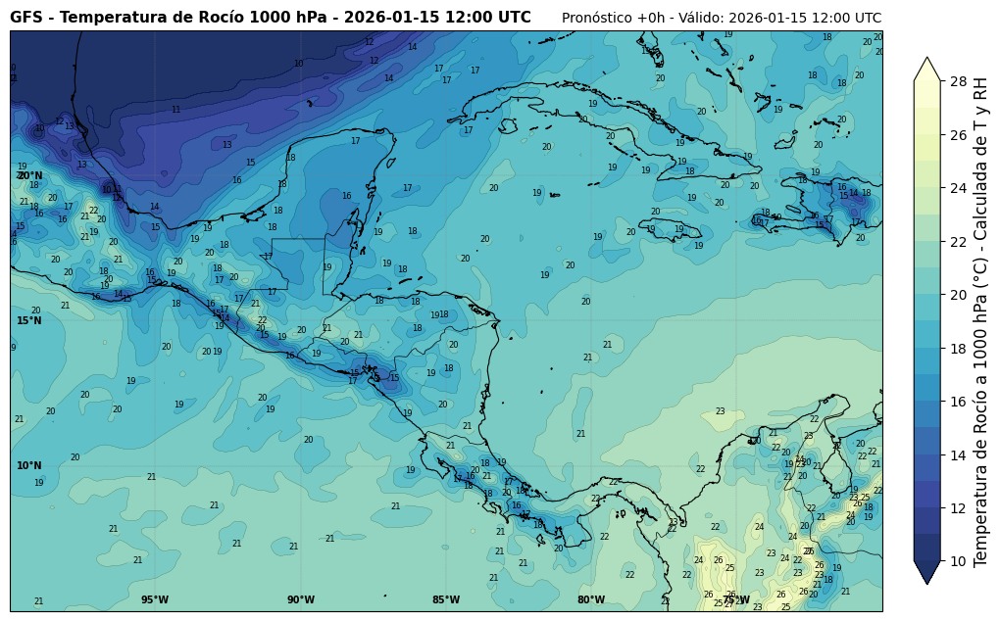

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
import metpy.calc as mpcalc
from metpy.units import units
from datetime import datetime

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
print("Descargando Temperatura (TMP) y Humedad Relativa (RH) a 1000 hPa...")
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Cargamos exactamente las variables confirmadas
ds = H.xarray(":(TMP|RH):1000 mb")
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#print("Descarga completada. Variables disponibles:", list(ds.variables))

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Temperatura del aire en Kelvin → convertimos a °C
T_1000 = ds['t'].metpy.unit_array.to('degC')

# Humedad Relativa (viene en %)
RH_1000 = ds['r'].metpy.unit_array

# Cálculo de Temperatura de Rocío usando MetPy
td_1000 = mpcalc.dewpoint_from_relative_humidity(T_1000, RH_1000)

# Coordenadas 2D para graficar
lon = ds.longitude.values
lat = ds.latitude.values
lon2d, lat2d = np.meshgrid(lon, lat)

#print("Cálculo de Td completado. Rango aproximado:",
#      round(td_1000.min().magnitude, 1), "a", round(td_1000.max().magnitude, 1), "°C")

# Suaviza los contornos
import scipy.ndimage
td_1000 = scipy.ndimage.zoom(td_1000, 3)
lon2d = scipy.ndimage.zoom(lon2d, 3)
lat2d = scipy.ndimage.zoom(lat2d, 3)

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles para Td a 1000 hPa (zona tropical: ajusta si necesitas)
levels = np.arange(10, 29, 1)   # cada 1°C

# Contornos rellenos
contourf = ax.contourf(lon2d, lat2d, td_1000,
                      levels=levels,
                      cmap='YlGnBu_r',
                      extend='both',
                      transform=ccrs.PlateCarree(),
                      alpha=0.9)

# Contornos negros finos (cada 2°C)
contour = ax.contour(lon2d, lat2d, td_1000, levels=levels, colors='black', linewidths=0.1, alpha=1.0, transform=ccrs.PlateCarree())

# Etiquetas en contornos principales (cada 4°C)
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=8, colors="black")
for l in labels: l.set_rotation(0)

# Mapa base
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)

# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8, linestyle='--',
                  linewidth=0.3, xlocs=np.arange(-180, 181, 5), ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

# Barra de colores
cbar = plt.colorbar(contourf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Temperatura de Rocío a 1000 hPa (°C) - Calculada de T y RH', fontsize=12)

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GFS - Temperatura de Rocío 1000 hPa - {run_str}', fontweight='bold', fontsize=11, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guardar y mostrar
plt.savefig('/content/output/GFS_DewPoint_1000hPa_Calculado.png', bbox_inches='tight', dpi=150)
plt.show()

Espesor 1000-925 hPa

Descargando altura geopotencial (HGT) a 1000 hPa y 925 hPa...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


/usr/local/lib/python3.12/dist-packages/herbie/core.py:978: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  logic = df.search_this.str.contains(search)


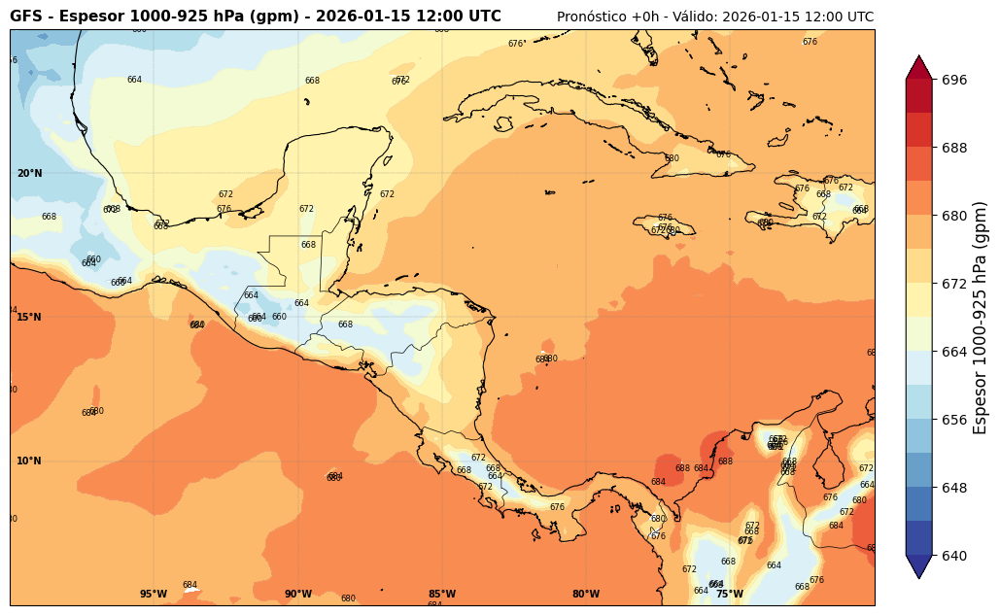

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from datetime import datetime

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
print("Descargando altura geopotencial (HGT) a 1000 hPa y 925 hPa...")
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Cargamos HGT a ambos niveles
ds = H.xarray(":HGT:(1000|925) mb")
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Altura geopotencial a 1000 hPa y 925 hPa (en metros geopotenciales - gpm)
hgt_1000 = ds['gh'].sel(isobaricInhPa=1000)
hgt_925  = ds['gh'].sel(isobaricInhPa=925)

# Espesor 1000-925 hPa = HGT925 - HGT1000
espesor = hgt_925 - hgt_1000

# Coordenadas para graficar
lon = ds.longitude.values
lat = ds.latitude.values
lon2d, lat2d = np.meshgrid(lon, lat)

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles típicos para espesor 1000-925 hPa en zona tropical
# ~820-880 m (valores bajos = aire frío, altos = cálido)
levels = np.arange(640, 700, 4)  # cada 4 metros

# Contornos rellenos
contour = ax.contourf(lon2d, lat2d, espesor, levels=levels, cmap='RdYlBu_r', extend='both', transform=ccrs.PlateCarree())

# Isóbaras
ax.contour(lon2d, lat2d, espesor, levels=levels, colors='lightgray', linewidths=0.1, transform=ccrs.PlateCarree())

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Mapa base
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)

# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8, linestyle='--',
                  linewidth=0.3, xlocs=np.arange(-180, 181, 5), ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

# Barra de colores
cbar = plt.colorbar(contour, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Espesor 1000-925 hPa (gpm)', fontsize=12)

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GFS - Espesor 1000-925 hPa (gpm) - {run_str}',
          fontweight='bold', fontsize=11, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

# Guardar y mostrar
plt.savefig('/content/output/GFS_Espesor_1000_925hPa.png', bbox_inches='tight', dpi=150)
plt.show()

Cambio de temperatura

Calculando cambio de temperatura a 1000 hPa: 2026-01-15 12:00 - 2026-01-15 06:00 (6h)
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 06:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Cálculo de ΔT 1000 hPa completado
Rango ΔT: -5.0 delta_degree_Celsius a 2.2 delta_degree_Celsius °C


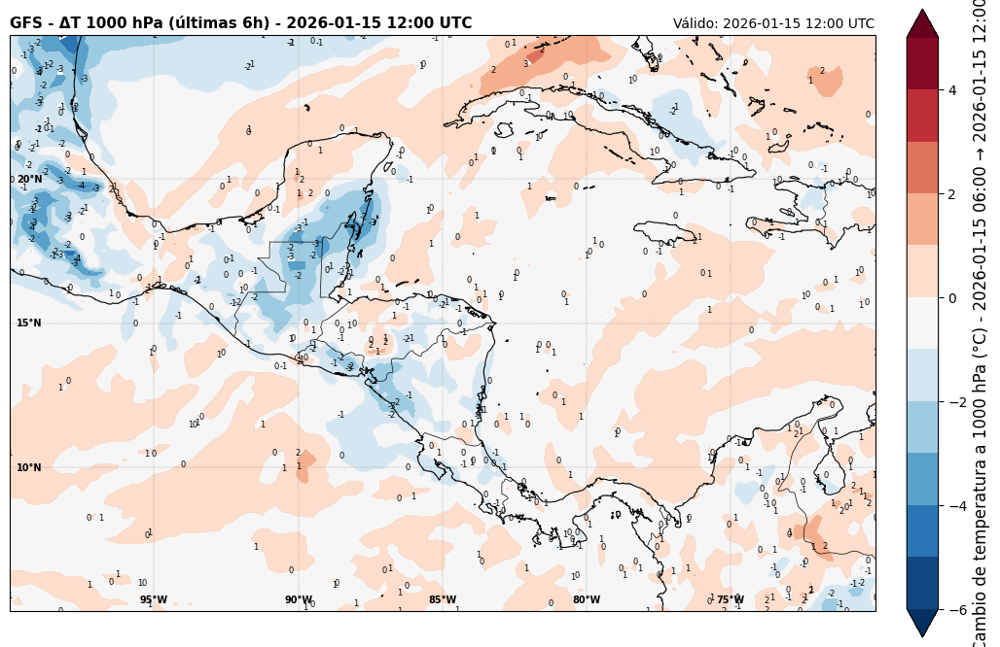

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from datetime import datetime, timedelta

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             CONFIGURACIÓN DE TIEMPOS
#========================================================================================================================#
# Tiempo actual
fecha_actual = "2026-01-15 12:00"   # ← CAMBIA AQUÍ según necesites
fxx_actual = 0

# Tiempo anterior (ej: 6 horas antes)
delta_horas = 6                     # cambia a 12, 24, etc. si quieres
fecha_anterior = (datetime.strptime(fecha_actual, "%Y-%m-%d %H:%M") -
                  timedelta(hours=delta_horas)).strftime("%Y-%m-%d %H:%M")

print(f"Calculando cambio de temperatura a 1000 hPa: {fecha_actual} - {fecha_anterior} ({delta_horas}h)")

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
# Tiempo actual
H_actual = Herbie(fecha_actual, model="gfs", product="pgrb2.0p25", fxx=fxx_actual)
ds_actual = H_actual.xarray(":TMP:1000 mb")
ds_actual = ds_actual.assign_coords(longitude=((ds_actual.longitude + 180) % 360) - 180).sortby("longitude")
ds_actual = ds_actual.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

# Tiempo anterior
H_anterior = Herbie(fecha_anterior, model="gfs", product="pgrb2.0p25", fxx=fxx_actual)
ds_anterior = H_anterior.xarray(":TMP:1000 mb")
ds_anterior = ds_anterior.assign_coords(longitude=((ds_anterior.longitude + 180) % 360) - 180).sortby("longitude")
ds_anterior = ds_anterior.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Temperatura en °C
T_actual_1000 = ds_actual['t'].metpy.unit_array.to('degC')
T_anterior_1000 = ds_anterior['t'].metpy.unit_array.to('degC')

# Cambio (ΔT = actual - anterior)
deltaT_1000 = T_actual_1000 - T_anterior_1000

# Coordenadas
lon = ds_actual.longitude.values
lat = ds_actual.latitude.values
lon2d, lat2d = np.meshgrid(lon, lat)

print("Cálculo de ΔT 1000 hPa completado")
print(f"Rango ΔT: {deltaT_1000.min().item():.1f} a {deltaT_1000.max().item():.1f} °C")

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Niveles para cambio de temperatura (simétricos alrededor de cero)
levels = np.arange(-6, 6, 1)

# Contornos rellenos
contour = ax.contourf(lon2d, lat2d, deltaT_1000, levels=levels, cmap='RdBu_r', extend='both', transform=ccrs.PlateCarree())

# Isóbaras
ax.contour(lon2d, lat2d, deltaT_1000, levels=levels, colors='lightgray', linewidths=0.1, transform=ccrs.PlateCarree())

# Etiquetas en las líneas de contorno
labels = ax.clabel(contour, fmt="%d", fontsize=6, inline=True, inline_spacing=10, colors="black")
for l in labels: l.set_rotation(0)

# Mapa base
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
ax.add_feature(cfeature.LAND, facecolor='lightgray', alpha=0.15)
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.2)

# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8, linestyle='--',
                  linewidth=0.3, xlocs=np.arange(-180, 181, 5), ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

# Barra de colores
cbar = plt.colorbar(contour, ax=ax, orientation='vertical', pad=0.03, shrink=0.6)
cbar.set_label(f'Cambio de temperatura a 1000 hPa (°C) - {fecha_anterior} → {fecha_actual}', fontsize=12)

# Títulos
run_str = np.datetime_as_string(ds_actual.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds_actual.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GFS - ΔT 1000 hPa (últimas {delta_horas}h) - {run_str}',
          fontweight='bold', fontsize=11, loc='left')
plt.title(f'Válido: {valid_str}', fontsize=10, loc='right')

plt.savefig('/content/output/GFS_DeltaT_1000hPa.png', bbox_inches='tight', dpi=150)
plt.show()

Viento promedio de varios niveles, especialmente de 850 a 300 usando todos los niveles.

Descargando viento (u,v) en niveles 850 a 300 hPa...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2022-Oct-09 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local


/usr/local/lib/python3.12/dist-packages/herbie/core.py:978: UserWarning: This pattern is interpreted as a regular expression, and has match groups. To actually get the groups, use str.extract.
  logic = df.search_this.str.contains(search)
/usr/local/lib/python3.12/dist-packages/cfgrib/xarray_store.py:51: FutureWarning: In a future version of xarray the default value for compat will change from compat='no_conflicts' to compat='override'. This is likely to lead to different results when combining overlapping variables with the same name. To opt in to new defaults and get rid of these warnings now use `set_options(use_new_combine_kwarg_defaults=True) or set compat explicitly.
  o = xr.merge([o, ds], **kwargs)


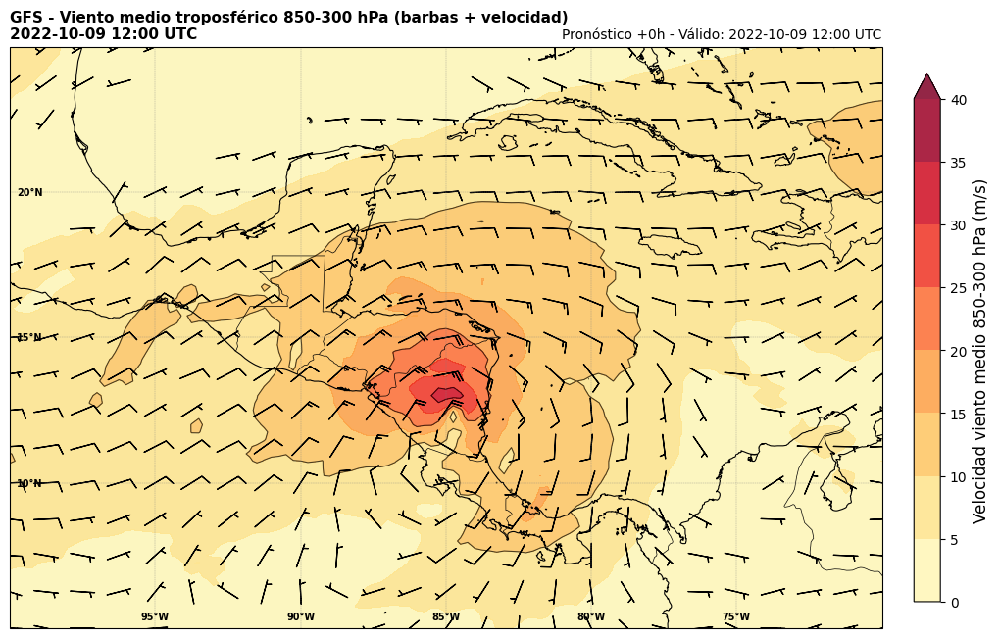

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from datetime import datetime

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
print("Descargando viento (u,v) en niveles 850 a 300 hPa...")
H = Herbie("2022-10-09 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

# Cargamos u y v en todos los niveles de presión entre 850 y 300 hPa
ds = H.xarray(":(U|V)GRD:(850|800|750|700|650|600|550|500|450|400|350|300) mb")
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Lista de niveles que vamos a promediar (todos los disponibles entre 850 y 300)
niveles = [850, 800, 750, 700, 650, 600, 550, 500, 450, 400, 350, 300]

# Promedio de u y v en todos los niveles
u_all = ds['u'].sel(isobaricInhPa=niveles)
v_all = ds['v'].sel(isobaricInhPa=niveles)

u_mean = u_all.mean(dim='isobaricInhPa')
v_mean = v_all.mean(dim='isobaricInhPa')

# Velocidad del viento medio (para contourf)
wind_speed_mean = np.sqrt(u_mean**2 + v_mean**2)

# Coordenadas
lon = ds.longitude.values
lat = ds.latitude.values
lon2d, lat2d = np.meshgrid(lon, lat)

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

# Fondo: velocidad del viento medio (m/s)
levels_speed = np.arange(0, 41, 5)  # 0-40 m/s, paso 5

cf = ax.contourf(lon2d, lat2d, wind_speed_mean,
                 levels=levels_speed,
                 cmap='YlOrRd', extend='max',
                 transform=ccrs.PlateCarree(),
                 alpha=0.85)

# Barbas del viento promedio (850-300 hPa)
skip = 5
ax.barbs(lon2d[::skip, ::skip], lat2d[::skip, ::skip],
         u_mean[::skip, ::skip].values, v_mean[::skip, ::skip].values,
         length=6, pivot='middle', barbcolor='black', flagcolor='black',
         linewidth=0.9, sizes=dict(emptybarb=0.0),
         flip_barb=(lat2d[::skip, ::skip] < 0),
         transform=ccrs.PlateCarree())

# Contornos de velocidad (cada 10 m/s)
ax.contour(lon2d, lat2d, wind_speed_mean, levels=levels_speed[::2],
           colors='black', linewidths=0.8, alpha=0.7,
           transform=ccrs.PlateCarree())

# Barra de colores
cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Velocidad viento medio 850-300 hPa (m/s)', fontsize=12)

# Mapa base
ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)
ax.add_feature(cfeature.LAND, facecolor='lightgray', alpha=0.15)
ax.add_feature(cfeature.OCEAN, facecolor='lightblue', alpha=0.2)

# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8, linestyle='--',
                  linewidth=0.3, xlocs=np.arange(-180, 181, 5), ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

# Títulos
run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GFS - Viento medio troposférico 850-300 hPa (barbas + velocidad)\n{run_str}',
          fontweight='bold', fontsize=11, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

plt.savefig('/content/output/GFS_VientoMedio_850_300hPa.png', bbox_inches='tight', dpi=150)
plt.show()

GFS: Humedad relativa en 925 y en 850 hPa. Resaltar valores mayores a 90%.

Descargando Humedad Relativa (RH) a 925 hPa...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
Descarga completada
Niveles disponibles: 925.0
Cálculo completado
RH 925 hPa - Máximo: 100.0%


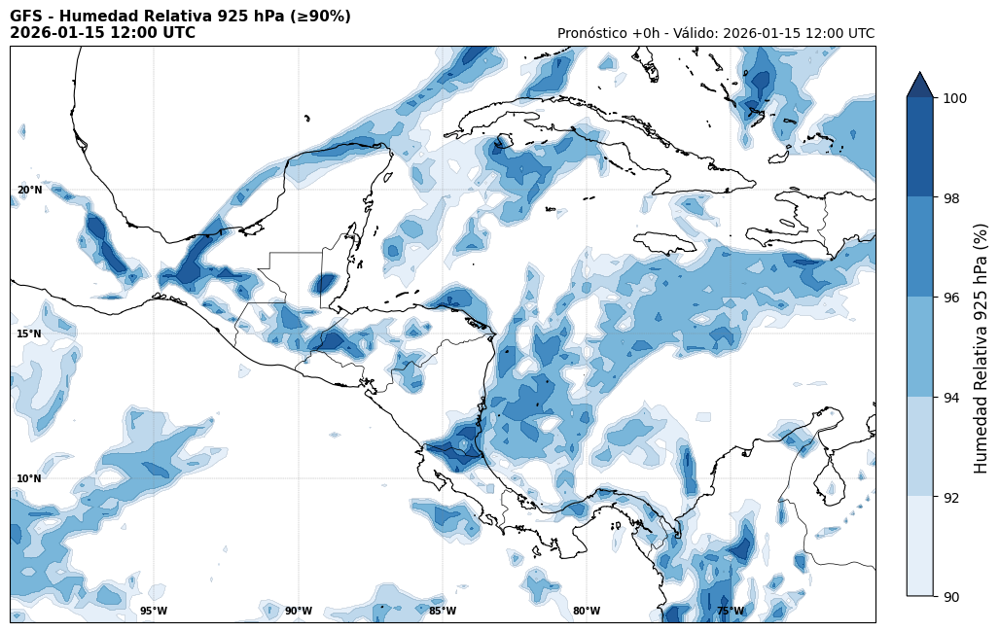

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from datetime import datetime

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             DESCARGA DE DATOS
#========================================================================================================================#
print("Descargando Humedad Relativa (RH) a 925 hPa...")
H = Herbie("2026-01-15 12:00", model="gfs", product="pgrb2.0p25", fxx=0)

ds = H.xarray(":RH:925 mb")
ds = ds.assign_coords(longitude=((ds.longitude + 180) % 360) - 180).sortby("longitude")
ds = ds.sel(longitude=slice(min_lon, max_lon), latitude=slice(max_lat, min_lat))

print("Descarga completada")
print("Niveles disponibles:", ds.isobaricInhPa.values if 'isobaricInhPa' in ds else "Dimensión singleton")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#
# Corrección clave: squeeze() elimina la dimensión de nivel único
rh_925 = ds['r'].squeeze()   # ahora es directamente un array 2D (lat, lon)

# Máscara para RH ≥ 90%
mask_90 = rh_925 >= 90

# Coordenadas
lon = ds.longitude.values
lat = ds.latitude.values
lon2d, lat2d = np.meshgrid(lon, lat)

print("Cálculo completado")
print(f"RH 925 hPa - Máximo: {rh_925.max().item():.1f}%")

#========================================================================================================================#
#                                              GRAFICA LA IMAGEN
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

levels = np.arange(90, 101, 2)

cf = ax.contourf(lon2d, lat2d, rh_925,
                      levels=levels, cmap='Blues', extend='max',
                      transform=ccrs.PlateCarree(), alpha=0.9)

ax.contour(lon2d, lat2d, rh_925, levels=levels,
           colors='black', linewidths=0.1, alpha=0.6,
           transform=ccrs.PlateCarree())

cbar = plt.colorbar(cf, ax=ax, orientation='vertical', pad=0.03, shrink=0.5)
cbar.set_label('Humedad Relativa 925 hPa (%)', fontsize=12)

ax.coastlines(resolution='10m', color='black', linewidth=0.8)
ax.add_feature(cfeature.BORDERS, edgecolor='black', linewidth=0.5)


# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8, linestyle='--',
                  linewidth=0.3, xlocs=np.arange(-180, 181, 5), ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

run_str = np.datetime_as_string(ds.time.values, unit='s')[:16].replace('T', ' ') + ' UTC'
valid_str = np.datetime_as_string(ds.valid_time.values, unit='s')[:16].replace('T', ' ') + ' UTC'

plt.title(f'GFS - Humedad Relativa 925 hPa (≥90%)\n{run_str}',
          fontweight='bold', fontsize=11, loc='left')
plt.title(f'Pronóstico +{H.fxx}h - Válido: {valid_str}', fontsize=10, loc='right')

plt.savefig('/content/output/GFS_RH_925hPa_Resaltado90.png', bbox_inches='tight', dpi=150)
plt.show()

GFS: Humedad relativa en 925. Resaltar valores mayores a 90%. Barbas de Viento en 1000 y Espesor - Ayuda a ver la posicion de los frentes

Descargando datos GFS con Herbie...
✅ Found ┊ model=gfs ┊ product=pgrb2.0p25 ┊ 2026-Jan-15 12:00 UTC F00 ┊ GRIB2 @ aws ┊ IDX @ local
✔ Descarga completada
✔ Procesamiento completado
RH 925 hPa máx: 100.0%
Espesor 1000–925 hPa: 650 – 686 gpm


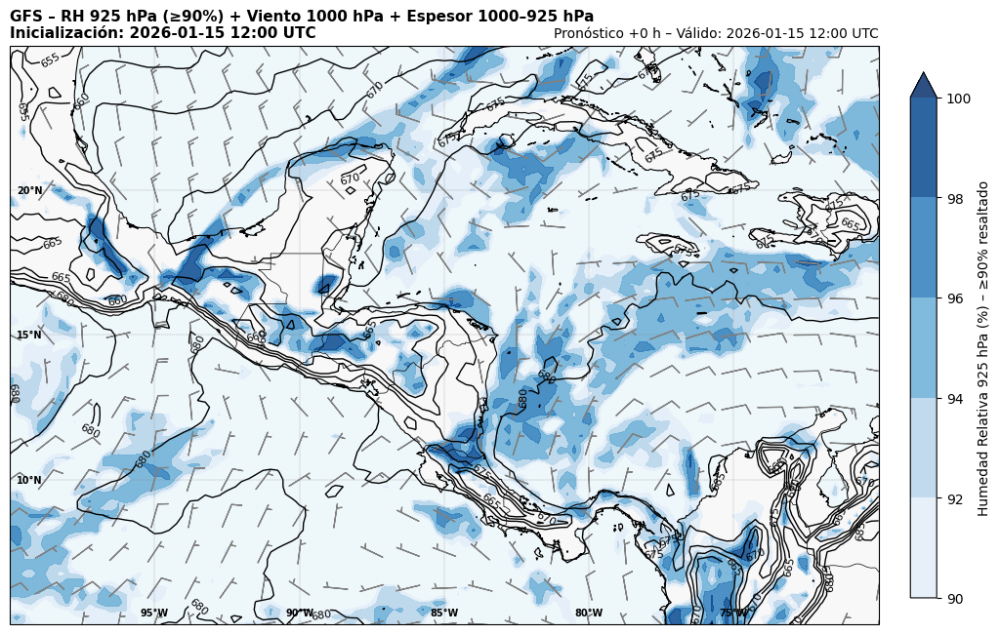

In [ ]:
#========================================================================================================================#
#                                        LIBRERÍAS NECESARIAS
#========================================================================================================================#
from herbie import Herbie
import xarray as xr
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from datetime import datetime

#========================================================================================================================#
#                                             REGIÓN DE INTERÉS
#========================================================================================================================#
min_lon = -100; max_lon = -70
min_lat = 5;    max_lat = 25

#========================================================================================================================#
#                                             CONFIGURACIÓN DEL MODELO
#========================================================================================================================#
run_time = "2026-01-15 12:00"
model    = "gfs"
product  = "pgrb2.0p25"
fxx      = 0

#========================================================================================================================#
#                                             DESCARGA DE DATOS (SEPARADA)
#========================================================================================================================#
print("Descargando datos GFS con Herbie...")

H = Herbie(run_time, model=model, product=product, fxx=fxx)

#--------------------------------------------------------------------------------------------------#
# 1. Humedad Relativa a 925 hPa
#--------------------------------------------------------------------------------------------------#
ds_rh = H.xarray(":RH:925 mb")

ds_rh = (
    ds_rh
    .assign_coords(longitude=((ds_rh.longitude + 180) % 360) - 180)
    .sortby("longitude")
    .sel(longitude=slice(min_lon, max_lon),
         latitude=slice(max_lat, min_lat))
)

#--------------------------------------------------------------------------------------------------#
# 2. Altura geopotencial a 1000 y 925 hPa
#--------------------------------------------------------------------------------------------------#
ds_hgt = H.xarray(":HGT:1000 mb|:HGT:925 mb")

ds_hgt = (
    ds_hgt
    .assign_coords(longitude=((ds_hgt.longitude + 180) % 360) - 180)
    .sortby("longitude")
    .sel(longitude=slice(min_lon, max_lon),
         latitude=slice(max_lat, min_lat))
)

#--------------------------------------------------------------------------------------------------#
# 3. Viento a 1000 hPa (U y V DESCARGADOS POR SEPARADO – EVITA BUGS)
#--------------------------------------------------------------------------------------------------#
ds_u = H.xarray(":UGRD:1000 mb")
ds_v = H.xarray(":VGRD:1000 mb")

ds_u = (
    ds_u
    .assign_coords(longitude=((ds_u.longitude + 180) % 360) - 180)
    .sortby("longitude")
    .sel(longitude=slice(min_lon, max_lon),
         latitude=slice(max_lat, min_lat))
)

ds_v = (
    ds_v
    .assign_coords(longitude=((ds_v.longitude + 180) % 360) - 180)
    .sortby("longitude")
    .sel(longitude=slice(min_lon, max_lon),
         latitude=slice(max_lat, min_lat))
)

print("✔ Descarga completada")

#========================================================================================================================#
#                                       PROCESAMIENTO DE LA INFORMACIÓN
#========================================================================================================================#

# Humedad relativa 925 hPa
rh_925 = ds_rh["r"].squeeze()

# Máscara RH ≥ 90%
mask_90 = rh_925 >= 90

# Espesor 1000–925 hPa
hgt_1000 = ds_hgt["gh"].sel(isobaricInhPa=1000).squeeze()
hgt_925  = ds_hgt["gh"].sel(isobaricInhPa=925).squeeze()
espesor  = hgt_925 - hgt_1000

# Viento 1000 hPa
u_1000 = ds_u["u"].squeeze()
v_1000 = ds_v["v"].squeeze()

# Coordenadas
lon = ds_rh.longitude.values
lat = ds_rh.latitude.values
lon2d, lat2d = np.meshgrid(lon, lat)

print("✔ Procesamiento completado")
print(f"RH 925 hPa máx: {rh_925.max().item():.1f}%")
print(f"Espesor 1000–925 hPa: {espesor.min().item():.0f} – {espesor.max().item():.0f} gpm")

#========================================================================================================================#
#                                              GRÁFICA
#========================================================================================================================#
fig = plt.figure(figsize=(14, 14))
ax = plt.axes(projection=ccrs.PlateCarree())

ax.set_extent([min_lon, max_lon, min_lat, max_lat], crs=ccrs.PlateCarree())

#--------------------------------------------------------------------------------------------------#
# Humedad Relativa 925 hPa
#--------------------------------------------------------------------------------------------------#
levels_rh = np.arange(90, 101, 2)

cf = ax.contourf(
    lon2d, lat2d, rh_925,
    levels=levels_rh,
    cmap="Blues",
    extend="max",
    alpha=0.85,
    transform=ccrs.PlateCarree()
)

#--------------------------------------------------------------------------------------------------#
# Viento 1000 hPa (barbas)
#--------------------------------------------------------------------------------------------------#
skip = 5
ax.barbs(
    lon2d[::skip, ::skip],
    lat2d[::skip, ::skip],
    u_1000[::skip, ::skip].values,
    v_1000[::skip, ::skip].values,
    length=6, pivot='middle', barbcolor='gray', flagcolor='gray',
         linewidth=0.9, sizes=dict(emptybarb=0.0),
         flip_barb=(lat2d[::skip, ::skip] < 0),
         transform=ccrs.PlateCarree()
)

#--------------------------------------------------------------------------------------------------#
# Espesor 1000–925 hPa
#--------------------------------------------------------------------------------------------------#
levels_espesor = np.arange(640, 700, 5)

cs = ax.contour(
    lon2d, lat2d, espesor,
    levels=levels_espesor,
    colors="black",
    linewidths=1.0,
    transform=ccrs.PlateCarree()
)

ax.clabel(cs, fmt="%d", fontsize=8, inline=True)

#--------------------------------------------------------------------------------------------------#
# Mapa base
#--------------------------------------------------------------------------------------------------#
ax.coastlines(resolution="10m", linewidth=0.8)
ax.add_feature(cfeature.BORDERS, linewidth=0.5)
ax.add_feature(cfeature.LAND, facecolor="lightgray", alpha=0.15)
ax.add_feature(cfeature.OCEAN, facecolor="lightblue", alpha=0.2)

# Grilla
gl = ax.gridlines(crs=ccrs.PlateCarree(), color='gray', alpha=0.8, linestyle='--',
                  linewidth=0.3, xlocs=np.arange(-180, 181, 5), ylocs=np.arange(-90, 91, 5),
                  draw_labels=True)
gl.top_labels = False
gl.right_labels = False
gl.xpadding = -5
gl.ypadding = -5
gl.ylabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}
gl.xlabel_style = {'color': 'black', 'size': 7, 'weight': 'bold'}

#--------------------------------------------------------------------------------------------------#
# Barra de colores
#--------------------------------------------------------------------------------------------------#
cbar = plt.colorbar(cf, ax=ax, pad=0.03, shrink=0.5)
cbar.set_label("Humedad Relativa 925 hPa (%) – ≥90% resaltado")

#--------------------------------------------------------------------------------------------------#
# Títulos
#--------------------------------------------------------------------------------------------------#
run_str   = np.datetime_as_string(ds_rh.time.values, unit="s")[:16].replace("T", " ") + " UTC"
valid_str = np.datetime_as_string(ds_rh.valid_time.values, unit="s")[:16].replace("T", " ") + " UTC"

plt.title(
    "GFS – RH 925 hPa (≥90%) + Viento 1000 hPa + Espesor 1000–925 hPa\n"
    f"Inicialización: {run_str}",
    loc="left",
    fontsize=11,
    fontweight="bold"
)

plt.title(
    f"Pronóstico +{fxx} h – Válido: {valid_str}",
    loc="right",
    fontsize=10
)

#--------------------------------------------------------------------------------------------------#
# Guardar figura
#--------------------------------------------------------------------------------------------------#
plt.savefig(
    "/content/output/GFS_RH925_Viento1000_Espesor.png",
    dpi=150,
    bbox_inches="tight"
)

plt.show()